# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [5]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

In [8]:
np.random.randint(73257, size=36)

array([40050, 15146, 47019, 54800,  5285, 17746,  3205, 33226, 43862,
       58339, 29238, 47098, 66028, 38039, 58177, 20384,   377, 55894,
       70864, 52835,  9592, 38916, 62930,  3368, 29221, 59178, 34254,
       50972, 45797, 72922,  8706, 21865, 20122, 34392, 36325,  5618])

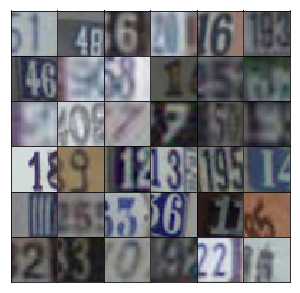

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [9]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [10]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [12]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [13]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [15]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [16]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [17]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [18]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [19]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [20]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [21]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2699... Generator Loss: 0.7121
Epoch 1/25... Discriminator Loss: 0.3736... Generator Loss: 2.3977
Epoch 1/25... Discriminator Loss: 0.2124... Generator Loss: 2.1729
Epoch 1/25... Discriminator Loss: 0.1136... Generator Loss: 3.0211
Epoch 1/25... Discriminator Loss: 0.2032... Generator Loss: 2.5588
Epoch 1/25... Discriminator Loss: 0.1015... Generator Loss: 3.0631
Epoch 1/25... Discriminator Loss: 0.1267... Generator Loss: 3.0352
Epoch 1/25... Discriminator Loss: 0.2184... Generator Loss: 3.1134
Epoch 1/25... Discriminator Loss: 0.0980... Generator Loss: 3.5483
Epoch 1/25... Discriminator Loss: 0.1473... Generator Loss: 2.9621


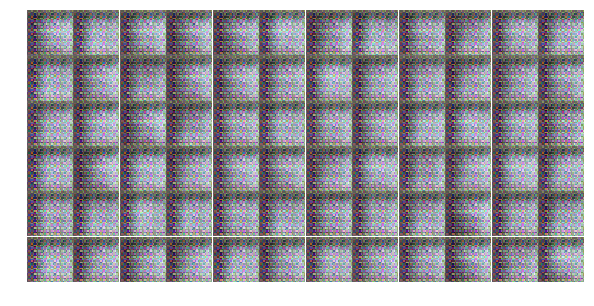

Epoch 1/25... Discriminator Loss: 0.2069... Generator Loss: 3.1938
Epoch 1/25... Discriminator Loss: 0.8722... Generator Loss: 1.7589
Epoch 1/25... Discriminator Loss: 0.5901... Generator Loss: 2.5599
Epoch 1/25... Discriminator Loss: 0.4885... Generator Loss: 1.4970
Epoch 1/25... Discriminator Loss: 0.4953... Generator Loss: 2.2816
Epoch 1/25... Discriminator Loss: 0.6868... Generator Loss: 3.5193
Epoch 1/25... Discriminator Loss: 0.1730... Generator Loss: 2.7793
Epoch 1/25... Discriminator Loss: 0.4321... Generator Loss: 2.6898
Epoch 1/25... Discriminator Loss: 1.1208... Generator Loss: 0.6053
Epoch 1/25... Discriminator Loss: 0.1402... Generator Loss: 2.7502


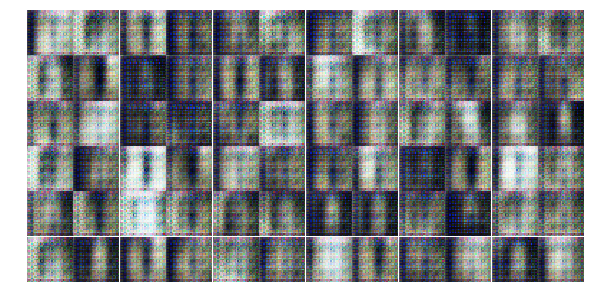

Epoch 1/25... Discriminator Loss: 0.1865... Generator Loss: 3.4095
Epoch 1/25... Discriminator Loss: 0.8704... Generator Loss: 0.9186
Epoch 1/25... Discriminator Loss: 0.3643... Generator Loss: 3.6131
Epoch 1/25... Discriminator Loss: 0.0972... Generator Loss: 3.4547
Epoch 1/25... Discriminator Loss: 0.4947... Generator Loss: 2.2025
Epoch 1/25... Discriminator Loss: 0.2980... Generator Loss: 4.0677
Epoch 1/25... Discriminator Loss: 4.5308... Generator Loss: 7.3070
Epoch 1/25... Discriminator Loss: 1.1752... Generator Loss: 1.5381
Epoch 1/25... Discriminator Loss: 1.2184... Generator Loss: 1.1294
Epoch 1/25... Discriminator Loss: 0.6253... Generator Loss: 1.4407


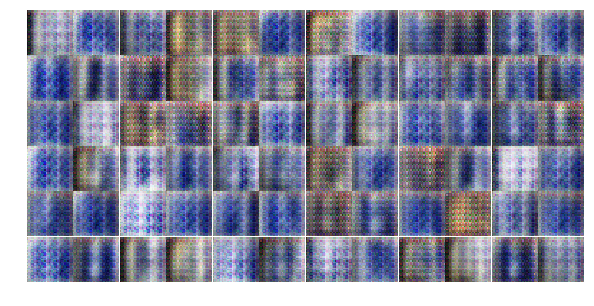

Epoch 1/25... Discriminator Loss: 0.5054... Generator Loss: 1.9367
Epoch 1/25... Discriminator Loss: 0.4575... Generator Loss: 1.9033
Epoch 1/25... Discriminator Loss: 0.6863... Generator Loss: 1.2357
Epoch 1/25... Discriminator Loss: 0.4084... Generator Loss: 2.6971
Epoch 1/25... Discriminator Loss: 0.5826... Generator Loss: 1.1510
Epoch 1/25... Discriminator Loss: 0.8792... Generator Loss: 0.9381
Epoch 1/25... Discriminator Loss: 0.3901... Generator Loss: 1.8181
Epoch 1/25... Discriminator Loss: 0.5088... Generator Loss: 2.4848
Epoch 1/25... Discriminator Loss: 0.3577... Generator Loss: 2.1198
Epoch 1/25... Discriminator Loss: 0.7168... Generator Loss: 1.1425


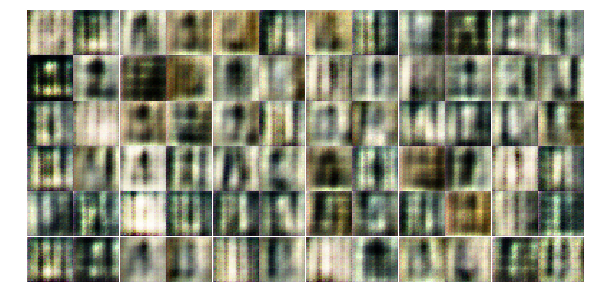

Epoch 1/25... Discriminator Loss: 0.3481... Generator Loss: 2.3385
Epoch 1/25... Discriminator Loss: 0.4261... Generator Loss: 1.6882
Epoch 1/25... Discriminator Loss: 0.6750... Generator Loss: 1.7210
Epoch 1/25... Discriminator Loss: 0.5481... Generator Loss: 1.7352
Epoch 1/25... Discriminator Loss: 0.6043... Generator Loss: 1.2528
Epoch 1/25... Discriminator Loss: 0.3852... Generator Loss: 2.0255
Epoch 1/25... Discriminator Loss: 0.4396... Generator Loss: 1.7350
Epoch 1/25... Discriminator Loss: 0.6432... Generator Loss: 2.0612
Epoch 1/25... Discriminator Loss: 0.8165... Generator Loss: 1.2181
Epoch 1/25... Discriminator Loss: 1.1454... Generator Loss: 0.7980


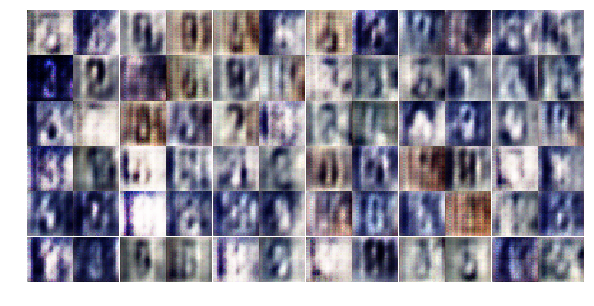

Epoch 1/25... Discriminator Loss: 0.9609... Generator Loss: 0.7243
Epoch 1/25... Discriminator Loss: 0.8554... Generator Loss: 1.2271
Epoch 1/25... Discriminator Loss: 0.6107... Generator Loss: 2.3443
Epoch 1/25... Discriminator Loss: 0.8805... Generator Loss: 0.9351
Epoch 1/25... Discriminator Loss: 0.8617... Generator Loss: 2.2651
Epoch 1/25... Discriminator Loss: 1.1202... Generator Loss: 0.6273
Epoch 1/25... Discriminator Loss: 0.9423... Generator Loss: 0.8981
Epoch 2/25... Discriminator Loss: 0.7736... Generator Loss: 1.5786
Epoch 2/25... Discriminator Loss: 0.5056... Generator Loss: 1.8271
Epoch 2/25... Discriminator Loss: 0.9056... Generator Loss: 0.7926


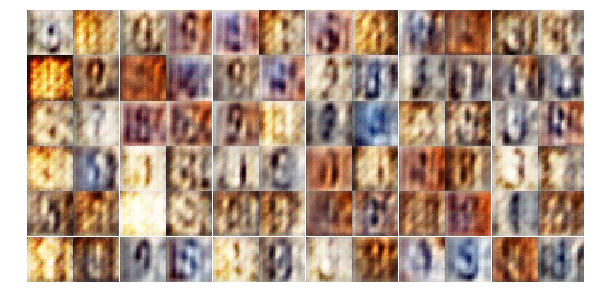

Epoch 2/25... Discriminator Loss: 0.8597... Generator Loss: 1.1100
Epoch 2/25... Discriminator Loss: 0.8239... Generator Loss: 1.2552
Epoch 2/25... Discriminator Loss: 0.9622... Generator Loss: 1.3114
Epoch 2/25... Discriminator Loss: 0.6468... Generator Loss: 1.4354
Epoch 2/25... Discriminator Loss: 1.1031... Generator Loss: 0.9573
Epoch 2/25... Discriminator Loss: 0.7108... Generator Loss: 1.6540
Epoch 2/25... Discriminator Loss: 1.2994... Generator Loss: 0.6022
Epoch 2/25... Discriminator Loss: 0.7185... Generator Loss: 1.4632
Epoch 2/25... Discriminator Loss: 1.0134... Generator Loss: 1.0593
Epoch 2/25... Discriminator Loss: 0.7319... Generator Loss: 1.8357


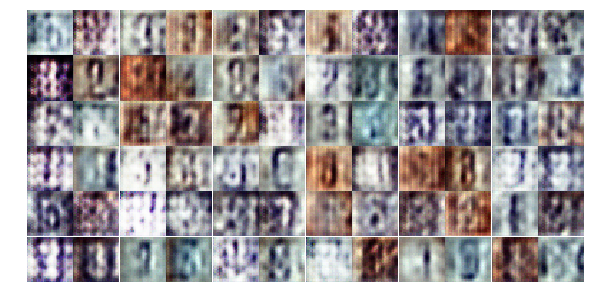

Epoch 2/25... Discriminator Loss: 0.5727... Generator Loss: 1.4384
Epoch 2/25... Discriminator Loss: 0.9679... Generator Loss: 1.3792
Epoch 2/25... Discriminator Loss: 1.1814... Generator Loss: 0.8716
Epoch 2/25... Discriminator Loss: 0.8967... Generator Loss: 0.9169
Epoch 2/25... Discriminator Loss: 0.7649... Generator Loss: 1.4948
Epoch 2/25... Discriminator Loss: 1.0715... Generator Loss: 0.8461
Epoch 2/25... Discriminator Loss: 1.1581... Generator Loss: 0.8878
Epoch 2/25... Discriminator Loss: 1.1576... Generator Loss: 1.3065
Epoch 2/25... Discriminator Loss: 1.0458... Generator Loss: 1.2299
Epoch 2/25... Discriminator Loss: 1.2891... Generator Loss: 0.5487


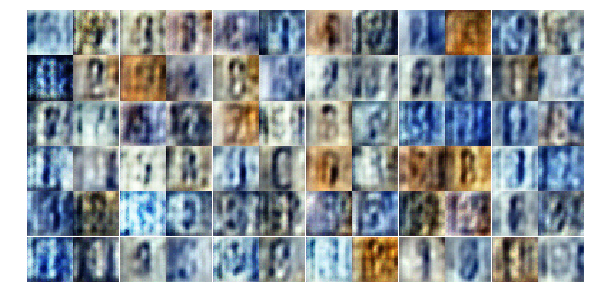

Epoch 2/25... Discriminator Loss: 1.0710... Generator Loss: 0.7762
Epoch 2/25... Discriminator Loss: 1.0709... Generator Loss: 1.3287
Epoch 2/25... Discriminator Loss: 0.9168... Generator Loss: 1.4887
Epoch 2/25... Discriminator Loss: 0.8290... Generator Loss: 1.9130
Epoch 2/25... Discriminator Loss: 1.1155... Generator Loss: 0.8706
Epoch 2/25... Discriminator Loss: 1.0828... Generator Loss: 1.0432
Epoch 2/25... Discriminator Loss: 0.6722... Generator Loss: 2.1368
Epoch 2/25... Discriminator Loss: 1.0073... Generator Loss: 0.9599
Epoch 2/25... Discriminator Loss: 0.9919... Generator Loss: 0.9541
Epoch 2/25... Discriminator Loss: 0.9413... Generator Loss: 1.2078


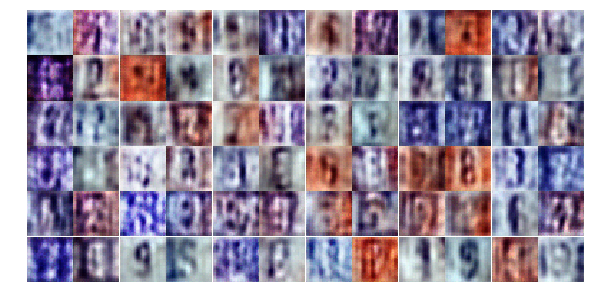

Epoch 2/25... Discriminator Loss: 1.1252... Generator Loss: 0.7858
Epoch 2/25... Discriminator Loss: 1.2538... Generator Loss: 0.6488
Epoch 2/25... Discriminator Loss: 1.1779... Generator Loss: 0.7354
Epoch 2/25... Discriminator Loss: 0.9172... Generator Loss: 1.1437
Epoch 2/25... Discriminator Loss: 1.0134... Generator Loss: 1.1149
Epoch 2/25... Discriminator Loss: 1.1790... Generator Loss: 0.7067
Epoch 2/25... Discriminator Loss: 1.0754... Generator Loss: 0.9876
Epoch 2/25... Discriminator Loss: 0.8967... Generator Loss: 1.3583
Epoch 2/25... Discriminator Loss: 1.0064... Generator Loss: 1.2022
Epoch 2/25... Discriminator Loss: 1.2131... Generator Loss: 0.9093


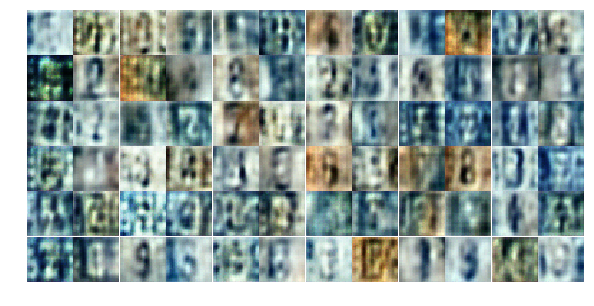

Epoch 2/25... Discriminator Loss: 1.0608... Generator Loss: 1.1836
Epoch 2/25... Discriminator Loss: 1.1956... Generator Loss: 1.0007
Epoch 2/25... Discriminator Loss: 0.6809... Generator Loss: 1.3815
Epoch 2/25... Discriminator Loss: 0.9032... Generator Loss: 1.3417
Epoch 2/25... Discriminator Loss: 1.3847... Generator Loss: 0.9155
Epoch 2/25... Discriminator Loss: 1.1307... Generator Loss: 0.7598
Epoch 2/25... Discriminator Loss: 0.8983... Generator Loss: 1.2335
Epoch 2/25... Discriminator Loss: 1.0917... Generator Loss: 1.4720
Epoch 2/25... Discriminator Loss: 0.8552... Generator Loss: 1.1516
Epoch 2/25... Discriminator Loss: 1.0803... Generator Loss: 0.9756


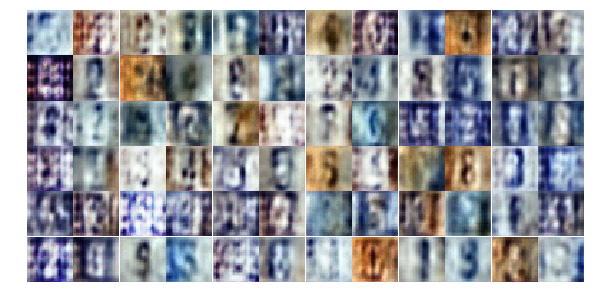

Epoch 2/25... Discriminator Loss: 0.6251... Generator Loss: 1.9530
Epoch 2/25... Discriminator Loss: 1.4716... Generator Loss: 0.4695
Epoch 2/25... Discriminator Loss: 0.9482... Generator Loss: 0.9170
Epoch 2/25... Discriminator Loss: 1.1716... Generator Loss: 0.6767
Epoch 3/25... Discriminator Loss: 1.1660... Generator Loss: 1.8928
Epoch 3/25... Discriminator Loss: 1.0288... Generator Loss: 1.0353
Epoch 3/25... Discriminator Loss: 1.0548... Generator Loss: 1.0286
Epoch 3/25... Discriminator Loss: 0.6826... Generator Loss: 1.2907
Epoch 3/25... Discriminator Loss: 0.9899... Generator Loss: 1.0098
Epoch 3/25... Discriminator Loss: 0.8042... Generator Loss: 1.0841


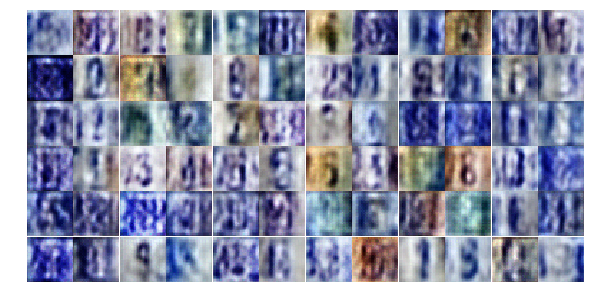

Epoch 3/25... Discriminator Loss: 0.9407... Generator Loss: 0.7617
Epoch 3/25... Discriminator Loss: 1.0799... Generator Loss: 0.7004
Epoch 3/25... Discriminator Loss: 0.6511... Generator Loss: 1.3557
Epoch 3/25... Discriminator Loss: 0.8662... Generator Loss: 1.1425
Epoch 3/25... Discriminator Loss: 0.8988... Generator Loss: 0.9143
Epoch 3/25... Discriminator Loss: 0.9911... Generator Loss: 0.9911
Epoch 3/25... Discriminator Loss: 0.7944... Generator Loss: 1.3597
Epoch 3/25... Discriminator Loss: 0.5801... Generator Loss: 1.6478
Epoch 3/25... Discriminator Loss: 0.7792... Generator Loss: 1.4609
Epoch 3/25... Discriminator Loss: 0.8323... Generator Loss: 1.0908


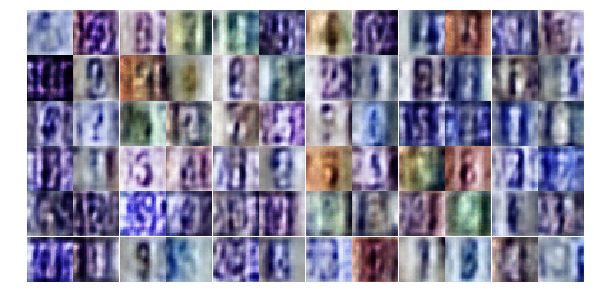

Epoch 3/25... Discriminator Loss: 0.8811... Generator Loss: 1.3495
Epoch 3/25... Discriminator Loss: 0.5297... Generator Loss: 1.6790
Epoch 3/25... Discriminator Loss: 0.7015... Generator Loss: 1.2255
Epoch 3/25... Discriminator Loss: 0.8446... Generator Loss: 0.9737
Epoch 3/25... Discriminator Loss: 0.8574... Generator Loss: 0.9700
Epoch 3/25... Discriminator Loss: 0.6909... Generator Loss: 1.4882
Epoch 3/25... Discriminator Loss: 0.9366... Generator Loss: 0.7534
Epoch 3/25... Discriminator Loss: 0.5899... Generator Loss: 1.2366
Epoch 3/25... Discriminator Loss: 0.6394... Generator Loss: 1.3269
Epoch 3/25... Discriminator Loss: 0.7118... Generator Loss: 1.0349


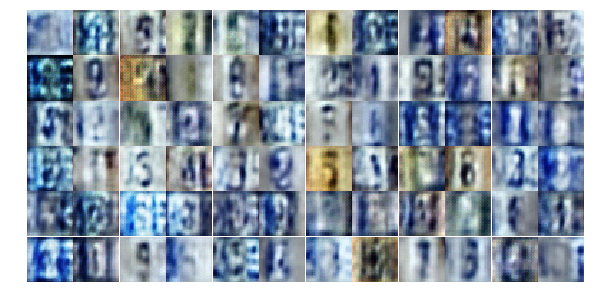

Epoch 3/25... Discriminator Loss: 0.5544... Generator Loss: 1.2726
Epoch 3/25... Discriminator Loss: 0.6621... Generator Loss: 1.3179
Epoch 3/25... Discriminator Loss: 0.7401... Generator Loss: 1.0886
Epoch 3/25... Discriminator Loss: 0.6530... Generator Loss: 1.1426
Epoch 3/25... Discriminator Loss: 0.5482... Generator Loss: 1.5490
Epoch 3/25... Discriminator Loss: 1.2529... Generator Loss: 0.6277
Epoch 3/25... Discriminator Loss: 0.6757... Generator Loss: 1.5692
Epoch 3/25... Discriminator Loss: 0.9806... Generator Loss: 0.7014
Epoch 3/25... Discriminator Loss: 0.7630... Generator Loss: 1.0146
Epoch 3/25... Discriminator Loss: 0.6736... Generator Loss: 1.6992


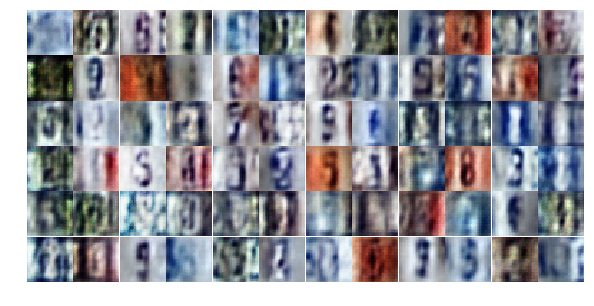

Epoch 3/25... Discriminator Loss: 0.5414... Generator Loss: 1.3751
Epoch 3/25... Discriminator Loss: 0.5409... Generator Loss: 2.9987
Epoch 3/25... Discriminator Loss: 0.3892... Generator Loss: 1.8354
Epoch 3/25... Discriminator Loss: 0.4971... Generator Loss: 1.5527
Epoch 3/25... Discriminator Loss: 1.3267... Generator Loss: 3.2253
Epoch 3/25... Discriminator Loss: 0.6427... Generator Loss: 1.7454
Epoch 3/25... Discriminator Loss: 0.7909... Generator Loss: 1.8364
Epoch 3/25... Discriminator Loss: 0.8952... Generator Loss: 0.8053
Epoch 3/25... Discriminator Loss: 0.4186... Generator Loss: 2.3172
Epoch 3/25... Discriminator Loss: 0.7937... Generator Loss: 1.4309


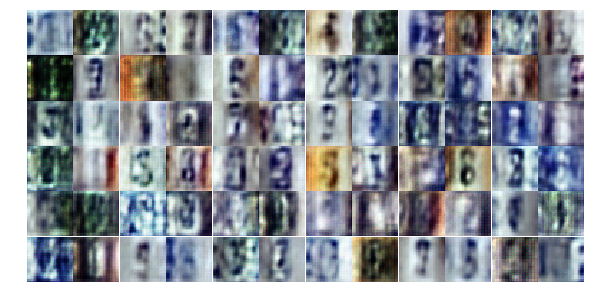

Epoch 3/25... Discriminator Loss: 0.8164... Generator Loss: 1.2419
Epoch 3/25... Discriminator Loss: 1.0063... Generator Loss: 1.4685
Epoch 3/25... Discriminator Loss: 0.7932... Generator Loss: 0.9251
Epoch 3/25... Discriminator Loss: 0.5644... Generator Loss: 1.7651
Epoch 3/25... Discriminator Loss: 0.5008... Generator Loss: 1.6651
Epoch 3/25... Discriminator Loss: 0.4416... Generator Loss: 1.9767
Epoch 3/25... Discriminator Loss: 0.4812... Generator Loss: 2.0395
Epoch 3/25... Discriminator Loss: 0.5212... Generator Loss: 1.5358
Epoch 3/25... Discriminator Loss: 0.4824... Generator Loss: 1.5161
Epoch 3/25... Discriminator Loss: 0.4795... Generator Loss: 1.4311


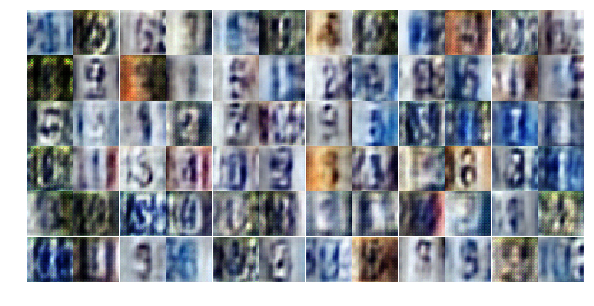

Epoch 3/25... Discriminator Loss: 0.9840... Generator Loss: 0.9133
Epoch 4/25... Discriminator Loss: 1.1070... Generator Loss: 0.6702
Epoch 4/25... Discriminator Loss: 0.7543... Generator Loss: 1.1161
Epoch 4/25... Discriminator Loss: 0.5221... Generator Loss: 1.7998
Epoch 4/25... Discriminator Loss: 0.6810... Generator Loss: 2.0583
Epoch 4/25... Discriminator Loss: 0.4774... Generator Loss: 1.5778
Epoch 4/25... Discriminator Loss: 1.3062... Generator Loss: 3.5142
Epoch 4/25... Discriminator Loss: 0.5738... Generator Loss: 1.6690
Epoch 4/25... Discriminator Loss: 0.6391... Generator Loss: 2.3314
Epoch 4/25... Discriminator Loss: 0.8598... Generator Loss: 0.7692


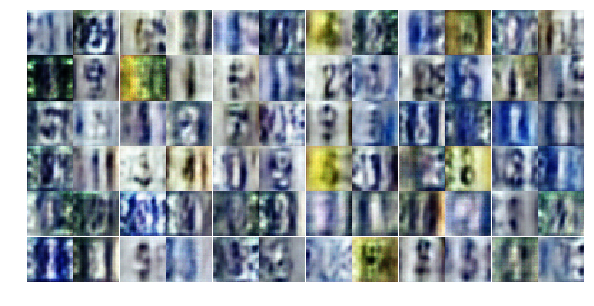

Epoch 4/25... Discriminator Loss: 0.4176... Generator Loss: 2.5618
Epoch 4/25... Discriminator Loss: 1.2290... Generator Loss: 0.4998
Epoch 4/25... Discriminator Loss: 0.8038... Generator Loss: 1.1736
Epoch 4/25... Discriminator Loss: 0.8966... Generator Loss: 0.9136
Epoch 4/25... Discriminator Loss: 0.6538... Generator Loss: 1.5936
Epoch 4/25... Discriminator Loss: 1.0590... Generator Loss: 0.6214
Epoch 4/25... Discriminator Loss: 1.7672... Generator Loss: 0.2689
Epoch 4/25... Discriminator Loss: 0.8076... Generator Loss: 0.7901
Epoch 4/25... Discriminator Loss: 0.6510... Generator Loss: 2.1980
Epoch 4/25... Discriminator Loss: 0.5057... Generator Loss: 1.6575


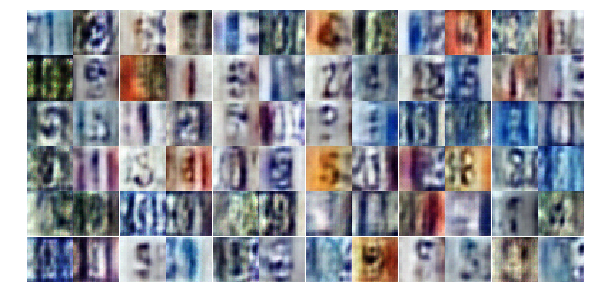

Epoch 4/25... Discriminator Loss: 0.5765... Generator Loss: 1.3807
Epoch 4/25... Discriminator Loss: 0.6042... Generator Loss: 2.8385
Epoch 4/25... Discriminator Loss: 0.6163... Generator Loss: 1.5328
Epoch 4/25... Discriminator Loss: 0.5930... Generator Loss: 1.1815
Epoch 4/25... Discriminator Loss: 0.3819... Generator Loss: 1.8819
Epoch 4/25... Discriminator Loss: 0.5895... Generator Loss: 2.7719
Epoch 4/25... Discriminator Loss: 0.4985... Generator Loss: 1.6427
Epoch 4/25... Discriminator Loss: 0.9414... Generator Loss: 2.1689
Epoch 4/25... Discriminator Loss: 0.4369... Generator Loss: 2.1029
Epoch 4/25... Discriminator Loss: 1.2976... Generator Loss: 4.4654


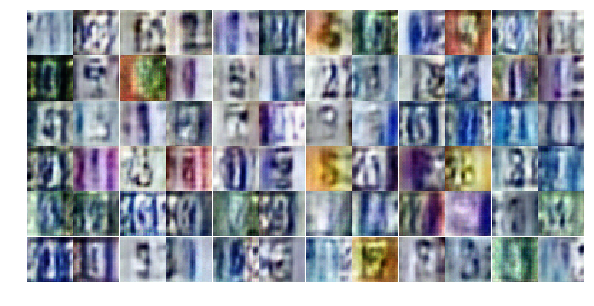

Epoch 4/25... Discriminator Loss: 0.5148... Generator Loss: 1.5686
Epoch 4/25... Discriminator Loss: 0.5592... Generator Loss: 1.6197
Epoch 4/25... Discriminator Loss: 0.5877... Generator Loss: 1.6920
Epoch 4/25... Discriminator Loss: 0.6844... Generator Loss: 2.3832
Epoch 4/25... Discriminator Loss: 0.6755... Generator Loss: 1.0745
Epoch 4/25... Discriminator Loss: 0.4227... Generator Loss: 1.8209
Epoch 4/25... Discriminator Loss: 0.6117... Generator Loss: 1.4269
Epoch 4/25... Discriminator Loss: 0.4215... Generator Loss: 1.8416
Epoch 4/25... Discriminator Loss: 0.5518... Generator Loss: 1.9495
Epoch 4/25... Discriminator Loss: 0.3930... Generator Loss: 1.6581


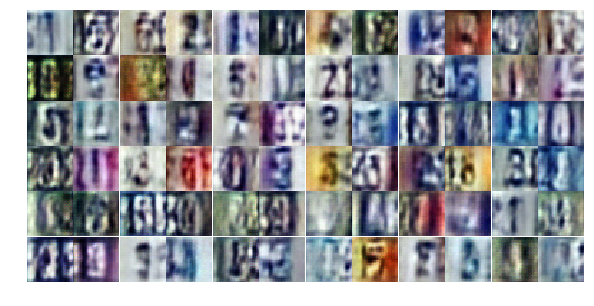

Epoch 4/25... Discriminator Loss: 0.5124... Generator Loss: 1.4088
Epoch 4/25... Discriminator Loss: 0.3797... Generator Loss: 1.8035
Epoch 4/25... Discriminator Loss: 0.8399... Generator Loss: 2.7249
Epoch 4/25... Discriminator Loss: 0.4566... Generator Loss: 1.6712
Epoch 4/25... Discriminator Loss: 0.3650... Generator Loss: 1.9776
Epoch 4/25... Discriminator Loss: 0.6448... Generator Loss: 2.0653
Epoch 4/25... Discriminator Loss: 0.8722... Generator Loss: 2.4795
Epoch 4/25... Discriminator Loss: 0.6247... Generator Loss: 1.6568
Epoch 4/25... Discriminator Loss: 0.7979... Generator Loss: 0.9535
Epoch 4/25... Discriminator Loss: 0.5328... Generator Loss: 1.3759


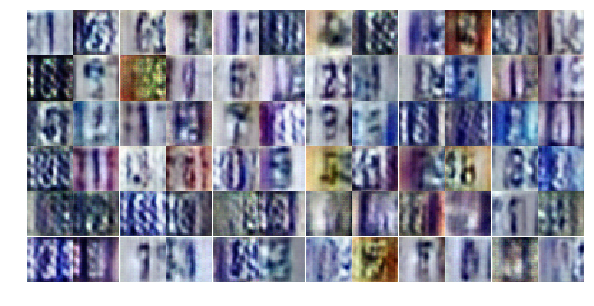

Epoch 4/25... Discriminator Loss: 0.4939... Generator Loss: 1.3804
Epoch 4/25... Discriminator Loss: 0.4813... Generator Loss: 2.7239
Epoch 4/25... Discriminator Loss: 0.4421... Generator Loss: 1.7319
Epoch 4/25... Discriminator Loss: 0.4159... Generator Loss: 2.4751
Epoch 4/25... Discriminator Loss: 0.9568... Generator Loss: 0.8203
Epoch 4/25... Discriminator Loss: 0.8232... Generator Loss: 0.9007
Epoch 4/25... Discriminator Loss: 0.3928... Generator Loss: 1.7123
Epoch 4/25... Discriminator Loss: 0.5881... Generator Loss: 1.4463
Epoch 4/25... Discriminator Loss: 0.5026... Generator Loss: 1.6194
Epoch 5/25... Discriminator Loss: 0.5252... Generator Loss: 1.4092


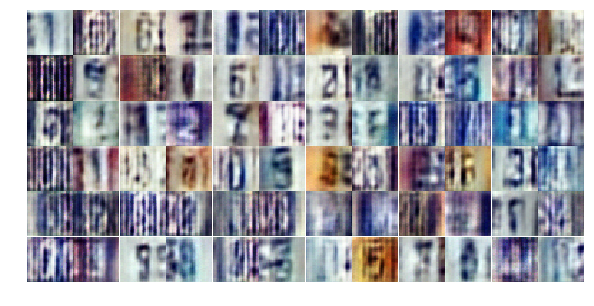

Epoch 5/25... Discriminator Loss: 0.3864... Generator Loss: 1.6293
Epoch 5/25... Discriminator Loss: 0.7178... Generator Loss: 0.9117
Epoch 5/25... Discriminator Loss: 1.0336... Generator Loss: 0.6670
Epoch 5/25... Discriminator Loss: 0.5207... Generator Loss: 1.5080
Epoch 5/25... Discriminator Loss: 0.3449... Generator Loss: 1.8375
Epoch 5/25... Discriminator Loss: 0.9541... Generator Loss: 0.7107
Epoch 5/25... Discriminator Loss: 0.5296... Generator Loss: 1.3861
Epoch 5/25... Discriminator Loss: 0.3188... Generator Loss: 2.1182
Epoch 5/25... Discriminator Loss: 0.4660... Generator Loss: 2.1670
Epoch 5/25... Discriminator Loss: 1.8081... Generator Loss: 0.3159


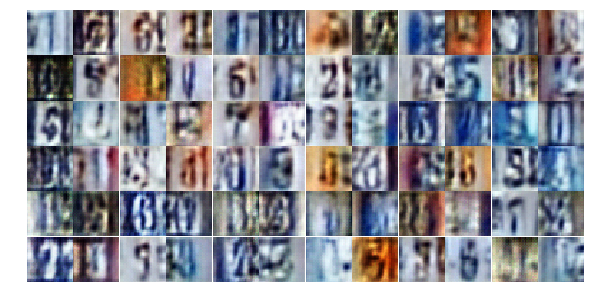

Epoch 5/25... Discriminator Loss: 0.6701... Generator Loss: 1.6054
Epoch 5/25... Discriminator Loss: 0.6501... Generator Loss: 1.9698
Epoch 5/25... Discriminator Loss: 0.4961... Generator Loss: 1.3024
Epoch 5/25... Discriminator Loss: 1.6759... Generator Loss: 0.4078
Epoch 5/25... Discriminator Loss: 0.8576... Generator Loss: 2.7288
Epoch 5/25... Discriminator Loss: 0.6423... Generator Loss: 1.2207
Epoch 5/25... Discriminator Loss: 0.5855... Generator Loss: 1.2103
Epoch 5/25... Discriminator Loss: 0.4895... Generator Loss: 1.6872
Epoch 5/25... Discriminator Loss: 0.4842... Generator Loss: 1.6246
Epoch 5/25... Discriminator Loss: 0.7871... Generator Loss: 0.9624


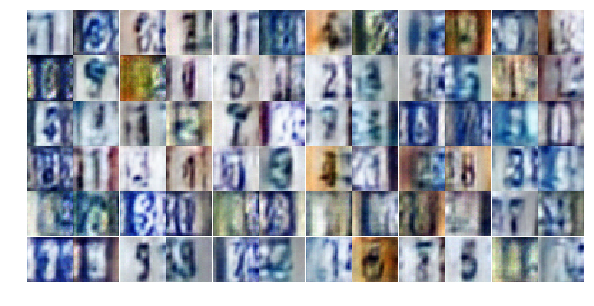

Epoch 5/25... Discriminator Loss: 0.6095... Generator Loss: 1.1326
Epoch 5/25... Discriminator Loss: 0.5728... Generator Loss: 1.7564
Epoch 5/25... Discriminator Loss: 0.4163... Generator Loss: 1.6950
Epoch 5/25... Discriminator Loss: 0.5755... Generator Loss: 2.0533
Epoch 5/25... Discriminator Loss: 0.8987... Generator Loss: 0.7161
Epoch 5/25... Discriminator Loss: 0.9231... Generator Loss: 0.8658
Epoch 5/25... Discriminator Loss: 0.8564... Generator Loss: 0.7345
Epoch 5/25... Discriminator Loss: 0.7535... Generator Loss: 1.1172
Epoch 5/25... Discriminator Loss: 0.7307... Generator Loss: 0.8905
Epoch 5/25... Discriminator Loss: 0.4921... Generator Loss: 1.3942


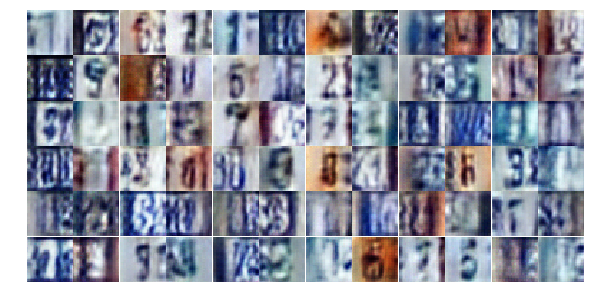

Epoch 5/25... Discriminator Loss: 0.5465... Generator Loss: 1.5430
Epoch 5/25... Discriminator Loss: 0.4519... Generator Loss: 1.4840
Epoch 5/25... Discriminator Loss: 0.2973... Generator Loss: 1.9691
Epoch 5/25... Discriminator Loss: 0.6624... Generator Loss: 1.0569
Epoch 5/25... Discriminator Loss: 0.5189... Generator Loss: 2.0145
Epoch 5/25... Discriminator Loss: 0.4124... Generator Loss: 1.8808
Epoch 5/25... Discriminator Loss: 0.8473... Generator Loss: 0.8363
Epoch 5/25... Discriminator Loss: 0.5568... Generator Loss: 1.2796
Epoch 5/25... Discriminator Loss: 0.9205... Generator Loss: 0.6540
Epoch 5/25... Discriminator Loss: 0.7447... Generator Loss: 0.9817


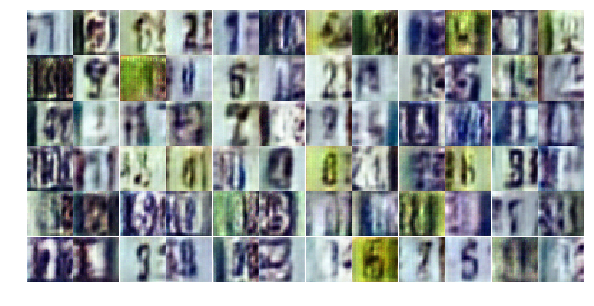

Epoch 5/25... Discriminator Loss: 0.3415... Generator Loss: 2.2317
Epoch 5/25... Discriminator Loss: 0.6388... Generator Loss: 0.9861
Epoch 5/25... Discriminator Loss: 0.9306... Generator Loss: 0.7502
Epoch 5/25... Discriminator Loss: 0.5165... Generator Loss: 1.4250
Epoch 5/25... Discriminator Loss: 0.9228... Generator Loss: 1.9497
Epoch 5/25... Discriminator Loss: 1.6890... Generator Loss: 3.1577
Epoch 5/25... Discriminator Loss: 0.6054... Generator Loss: 1.6698
Epoch 5/25... Discriminator Loss: 0.6630... Generator Loss: 1.3114
Epoch 5/25... Discriminator Loss: 0.4908... Generator Loss: 2.8673
Epoch 5/25... Discriminator Loss: 0.4486... Generator Loss: 1.5457


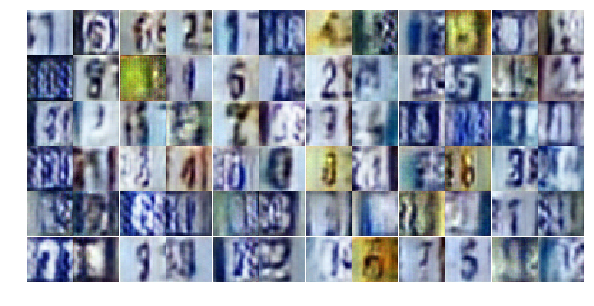

Epoch 5/25... Discriminator Loss: 0.9687... Generator Loss: 0.6388
Epoch 5/25... Discriminator Loss: 0.7384... Generator Loss: 0.8365
Epoch 5/25... Discriminator Loss: 0.5833... Generator Loss: 1.1331
Epoch 5/25... Discriminator Loss: 0.5579... Generator Loss: 1.1331
Epoch 5/25... Discriminator Loss: 0.6893... Generator Loss: 1.0091
Epoch 5/25... Discriminator Loss: 0.8591... Generator Loss: 1.3060
Epoch 6/25... Discriminator Loss: 0.8598... Generator Loss: 0.7689
Epoch 6/25... Discriminator Loss: 0.3260... Generator Loss: 2.1356
Epoch 6/25... Discriminator Loss: 1.4721... Generator Loss: 0.4748
Epoch 6/25... Discriminator Loss: 1.0734... Generator Loss: 0.6346


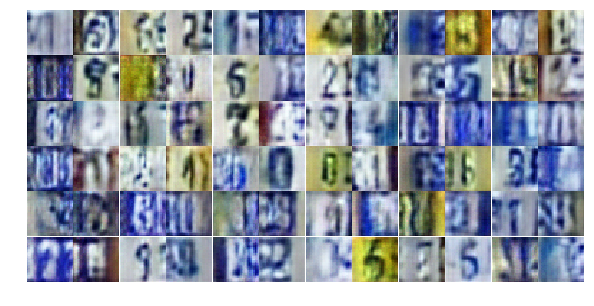

Epoch 6/25... Discriminator Loss: 0.5988... Generator Loss: 1.3037
Epoch 6/25... Discriminator Loss: 0.5686... Generator Loss: 1.7306
Epoch 6/25... Discriminator Loss: 1.3962... Generator Loss: 3.9397
Epoch 6/25... Discriminator Loss: 1.1198... Generator Loss: 0.5419
Epoch 6/25... Discriminator Loss: 0.7602... Generator Loss: 0.9073
Epoch 6/25... Discriminator Loss: 0.4091... Generator Loss: 1.4981
Epoch 6/25... Discriminator Loss: 0.3837... Generator Loss: 1.5169
Epoch 6/25... Discriminator Loss: 0.9845... Generator Loss: 0.6503
Epoch 6/25... Discriminator Loss: 0.6647... Generator Loss: 0.9715
Epoch 6/25... Discriminator Loss: 0.6554... Generator Loss: 1.4611


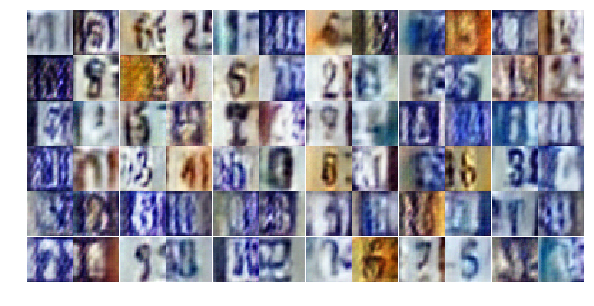

Epoch 6/25... Discriminator Loss: 0.6321... Generator Loss: 2.9360
Epoch 6/25... Discriminator Loss: 0.8912... Generator Loss: 0.9088
Epoch 6/25... Discriminator Loss: 0.9924... Generator Loss: 0.6321
Epoch 6/25... Discriminator Loss: 0.4281... Generator Loss: 1.4097
Epoch 6/25... Discriminator Loss: 0.4171... Generator Loss: 1.9614
Epoch 6/25... Discriminator Loss: 0.4759... Generator Loss: 1.6441
Epoch 6/25... Discriminator Loss: 0.5070... Generator Loss: 1.4094
Epoch 6/25... Discriminator Loss: 0.5481... Generator Loss: 1.4180
Epoch 6/25... Discriminator Loss: 0.6290... Generator Loss: 2.7310
Epoch 6/25... Discriminator Loss: 0.6219... Generator Loss: 1.1889


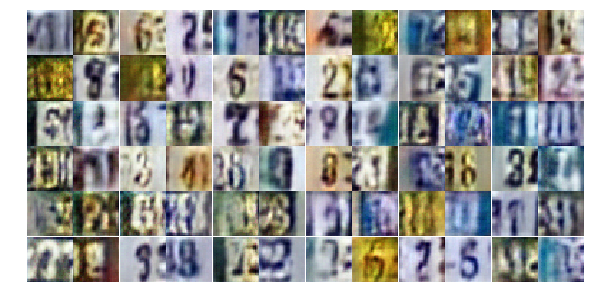

Epoch 6/25... Discriminator Loss: 0.6701... Generator Loss: 0.9326
Epoch 6/25... Discriminator Loss: 0.4982... Generator Loss: 1.3105
Epoch 6/25... Discriminator Loss: 0.9524... Generator Loss: 0.7277
Epoch 6/25... Discriminator Loss: 0.3830... Generator Loss: 1.7996
Epoch 6/25... Discriminator Loss: 0.4353... Generator Loss: 1.9176
Epoch 6/25... Discriminator Loss: 1.4246... Generator Loss: 0.5310
Epoch 6/25... Discriminator Loss: 0.9843... Generator Loss: 1.8406
Epoch 6/25... Discriminator Loss: 0.3058... Generator Loss: 2.3226
Epoch 6/25... Discriminator Loss: 0.6002... Generator Loss: 1.1608
Epoch 6/25... Discriminator Loss: 0.2794... Generator Loss: 2.0993


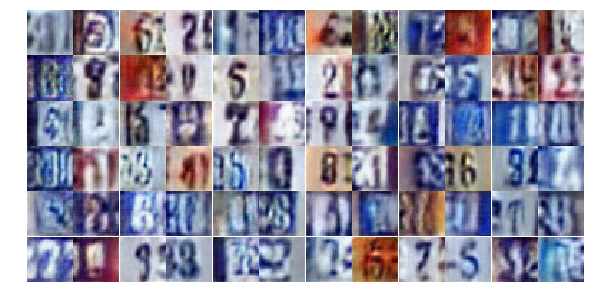

Epoch 6/25... Discriminator Loss: 1.1811... Generator Loss: 0.5062
Epoch 6/25... Discriminator Loss: 0.5367... Generator Loss: 2.1393
Epoch 6/25... Discriminator Loss: 0.7506... Generator Loss: 0.9545
Epoch 6/25... Discriminator Loss: 0.6266... Generator Loss: 1.0519
Epoch 6/25... Discriminator Loss: 0.5178... Generator Loss: 1.4386
Epoch 6/25... Discriminator Loss: 0.9412... Generator Loss: 0.6601
Epoch 6/25... Discriminator Loss: 0.5120... Generator Loss: 1.7690
Epoch 6/25... Discriminator Loss: 0.6863... Generator Loss: 2.6395
Epoch 6/25... Discriminator Loss: 0.6762... Generator Loss: 0.9686
Epoch 6/25... Discriminator Loss: 0.3375... Generator Loss: 1.7555


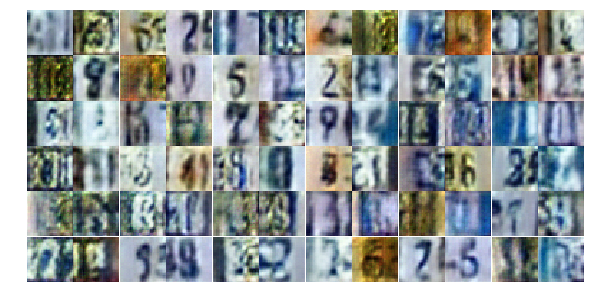

Epoch 6/25... Discriminator Loss: 0.6239... Generator Loss: 1.3970
Epoch 6/25... Discriminator Loss: 0.9432... Generator Loss: 1.1807
Epoch 6/25... Discriminator Loss: 0.9858... Generator Loss: 0.6660
Epoch 6/25... Discriminator Loss: 1.4531... Generator Loss: 0.3950
Epoch 6/25... Discriminator Loss: 0.5030... Generator Loss: 1.9107
Epoch 6/25... Discriminator Loss: 0.5659... Generator Loss: 1.1064
Epoch 6/25... Discriminator Loss: 0.7731... Generator Loss: 0.9505
Epoch 6/25... Discriminator Loss: 0.7784... Generator Loss: 1.2097
Epoch 6/25... Discriminator Loss: 0.8639... Generator Loss: 0.9261
Epoch 6/25... Discriminator Loss: 1.7446... Generator Loss: 0.2527


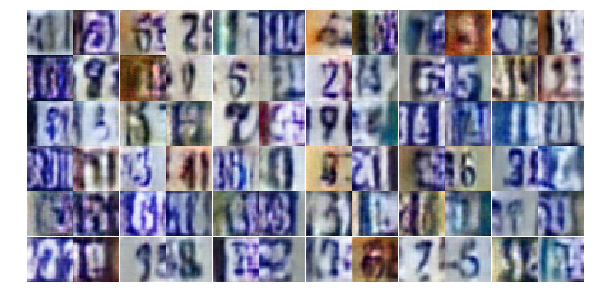

Epoch 6/25... Discriminator Loss: 0.7366... Generator Loss: 0.9723
Epoch 6/25... Discriminator Loss: 0.3599... Generator Loss: 1.5930
Epoch 6/25... Discriminator Loss: 0.6287... Generator Loss: 1.2610
Epoch 7/25... Discriminator Loss: 0.6250... Generator Loss: 1.2373
Epoch 7/25... Discriminator Loss: 0.6515... Generator Loss: 1.0482
Epoch 7/25... Discriminator Loss: 0.4692... Generator Loss: 1.4332
Epoch 7/25... Discriminator Loss: 0.3405... Generator Loss: 1.9769
Epoch 7/25... Discriminator Loss: 0.2712... Generator Loss: 2.3001
Epoch 7/25... Discriminator Loss: 0.5039... Generator Loss: 1.8580
Epoch 7/25... Discriminator Loss: 0.4800... Generator Loss: 1.4130


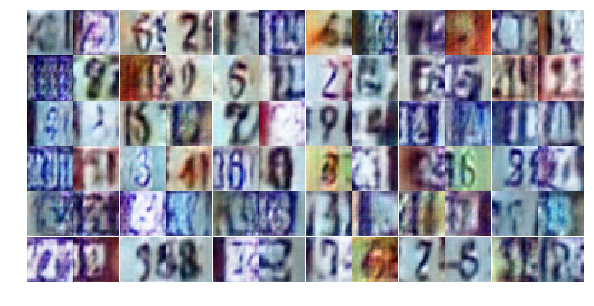

Epoch 7/25... Discriminator Loss: 0.4117... Generator Loss: 2.4358
Epoch 7/25... Discriminator Loss: 0.5347... Generator Loss: 1.3684
Epoch 7/25... Discriminator Loss: 0.9611... Generator Loss: 2.8527
Epoch 7/25... Discriminator Loss: 0.6110... Generator Loss: 1.2157
Epoch 7/25... Discriminator Loss: 0.4584... Generator Loss: 1.7962
Epoch 7/25... Discriminator Loss: 0.2645... Generator Loss: 2.0377
Epoch 7/25... Discriminator Loss: 0.8184... Generator Loss: 2.4705
Epoch 7/25... Discriminator Loss: 0.7153... Generator Loss: 2.3384
Epoch 7/25... Discriminator Loss: 0.8130... Generator Loss: 2.3419
Epoch 7/25... Discriminator Loss: 0.9230... Generator Loss: 0.8327


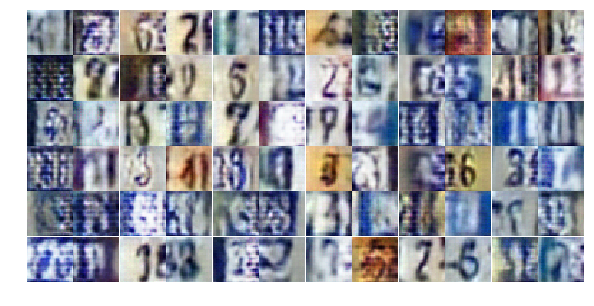

Epoch 7/25... Discriminator Loss: 0.6790... Generator Loss: 1.7898
Epoch 7/25... Discriminator Loss: 0.3614... Generator Loss: 1.8167
Epoch 7/25... Discriminator Loss: 0.6289... Generator Loss: 1.0578
Epoch 7/25... Discriminator Loss: 0.4561... Generator Loss: 1.8697
Epoch 7/25... Discriminator Loss: 0.4131... Generator Loss: 1.6730
Epoch 7/25... Discriminator Loss: 0.7108... Generator Loss: 2.8041
Epoch 7/25... Discriminator Loss: 0.4568... Generator Loss: 1.6407
Epoch 7/25... Discriminator Loss: 2.7467... Generator Loss: 3.9657
Epoch 7/25... Discriminator Loss: 0.5028... Generator Loss: 2.2264
Epoch 7/25... Discriminator Loss: 0.6575... Generator Loss: 1.7453


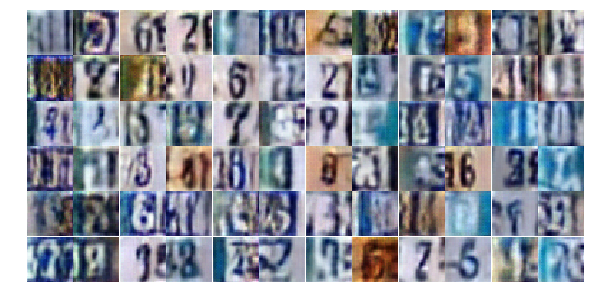

Epoch 7/25... Discriminator Loss: 0.9458... Generator Loss: 0.6711
Epoch 7/25... Discriminator Loss: 0.7581... Generator Loss: 0.9375
Epoch 7/25... Discriminator Loss: 0.4167... Generator Loss: 1.5299
Epoch 7/25... Discriminator Loss: 0.7271... Generator Loss: 0.9461
Epoch 7/25... Discriminator Loss: 0.5737... Generator Loss: 1.2742
Epoch 7/25... Discriminator Loss: 0.5918... Generator Loss: 1.1457
Epoch 7/25... Discriminator Loss: 0.5592... Generator Loss: 1.2342
Epoch 7/25... Discriminator Loss: 0.5056... Generator Loss: 1.3571
Epoch 7/25... Discriminator Loss: 1.4382... Generator Loss: 0.3446
Epoch 7/25... Discriminator Loss: 0.5315... Generator Loss: 2.5157


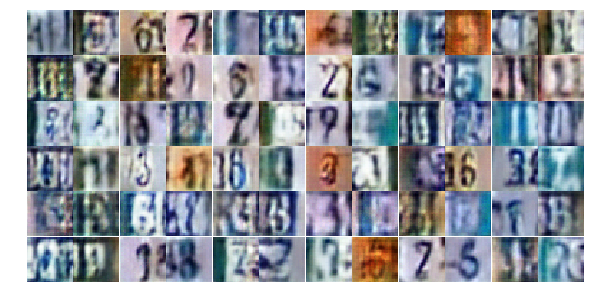

Epoch 7/25... Discriminator Loss: 1.2468... Generator Loss: 0.4754
Epoch 7/25... Discriminator Loss: 0.9375... Generator Loss: 0.7478
Epoch 7/25... Discriminator Loss: 0.6876... Generator Loss: 1.4090
Epoch 7/25... Discriminator Loss: 0.5974... Generator Loss: 1.5871
Epoch 7/25... Discriminator Loss: 0.6291... Generator Loss: 1.1099
Epoch 7/25... Discriminator Loss: 0.3333... Generator Loss: 1.8404
Epoch 7/25... Discriminator Loss: 0.3012... Generator Loss: 1.8102
Epoch 7/25... Discriminator Loss: 0.7945... Generator Loss: 0.8729
Epoch 7/25... Discriminator Loss: 0.5285... Generator Loss: 1.7802
Epoch 7/25... Discriminator Loss: 2.2409... Generator Loss: 1.1699


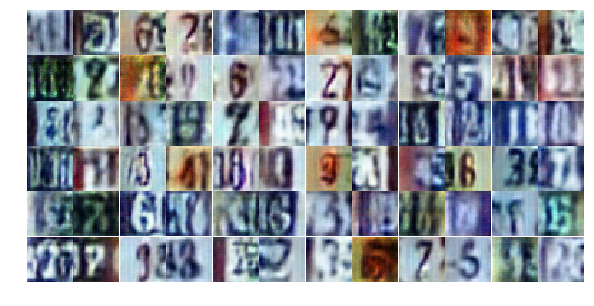

Epoch 7/25... Discriminator Loss: 0.5416... Generator Loss: 1.6479
Epoch 7/25... Discriminator Loss: 0.7276... Generator Loss: 1.2733
Epoch 7/25... Discriminator Loss: 0.7304... Generator Loss: 0.8905
Epoch 7/25... Discriminator Loss: 0.5039... Generator Loss: 1.3852
Epoch 7/25... Discriminator Loss: 0.7389... Generator Loss: 0.8903
Epoch 7/25... Discriminator Loss: 0.5216... Generator Loss: 1.6989
Epoch 7/25... Discriminator Loss: 1.1250... Generator Loss: 0.5264
Epoch 7/25... Discriminator Loss: 0.6716... Generator Loss: 1.8833
Epoch 7/25... Discriminator Loss: 0.9991... Generator Loss: 0.6457
Epoch 7/25... Discriminator Loss: 0.4295... Generator Loss: 2.2757


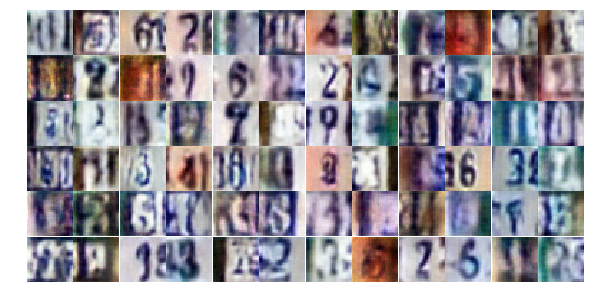

Epoch 7/25... Discriminator Loss: 0.6223... Generator Loss: 2.1537
Epoch 8/25... Discriminator Loss: 0.6141... Generator Loss: 1.2319
Epoch 8/25... Discriminator Loss: 0.9572... Generator Loss: 0.6131
Epoch 8/25... Discriminator Loss: 0.7157... Generator Loss: 0.9922
Epoch 8/25... Discriminator Loss: 0.6311... Generator Loss: 1.0445
Epoch 8/25... Discriminator Loss: 1.5110... Generator Loss: 0.3558
Epoch 8/25... Discriminator Loss: 0.8582... Generator Loss: 0.7973
Epoch 8/25... Discriminator Loss: 0.4468... Generator Loss: 1.3954
Epoch 8/25... Discriminator Loss: 0.6588... Generator Loss: 1.0975
Epoch 8/25... Discriminator Loss: 0.6135... Generator Loss: 1.0851


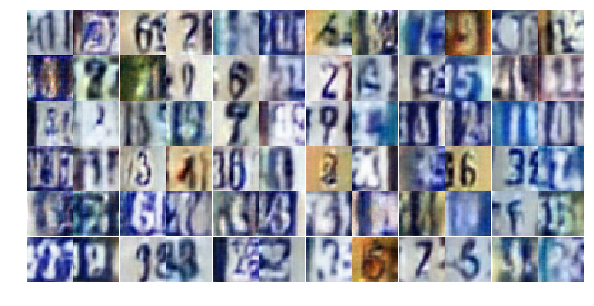

Epoch 8/25... Discriminator Loss: 0.3520... Generator Loss: 2.0848
Epoch 8/25... Discriminator Loss: 0.3958... Generator Loss: 1.4201
Epoch 8/25... Discriminator Loss: 0.7037... Generator Loss: 1.1092
Epoch 8/25... Discriminator Loss: 0.3312... Generator Loss: 1.7433
Epoch 8/25... Discriminator Loss: 1.4457... Generator Loss: 0.3548
Epoch 8/25... Discriminator Loss: 1.0102... Generator Loss: 2.1518
Epoch 8/25... Discriminator Loss: 0.5233... Generator Loss: 1.7309
Epoch 8/25... Discriminator Loss: 0.6119... Generator Loss: 1.1962
Epoch 8/25... Discriminator Loss: 0.7923... Generator Loss: 1.0150
Epoch 8/25... Discriminator Loss: 1.2873... Generator Loss: 0.4245


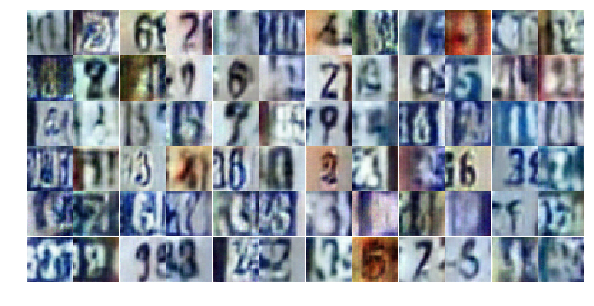

Epoch 8/25... Discriminator Loss: 0.3708... Generator Loss: 2.0236
Epoch 8/25... Discriminator Loss: 0.4270... Generator Loss: 1.5246
Epoch 8/25... Discriminator Loss: 0.6514... Generator Loss: 1.4715
Epoch 8/25... Discriminator Loss: 0.6260... Generator Loss: 1.7578
Epoch 8/25... Discriminator Loss: 0.4881... Generator Loss: 1.5062
Epoch 8/25... Discriminator Loss: 0.6115... Generator Loss: 1.1442
Epoch 8/25... Discriminator Loss: 0.5476... Generator Loss: 1.1829
Epoch 8/25... Discriminator Loss: 0.4018... Generator Loss: 1.5426
Epoch 8/25... Discriminator Loss: 0.5846... Generator Loss: 2.2444
Epoch 8/25... Discriminator Loss: 0.6699... Generator Loss: 1.3782


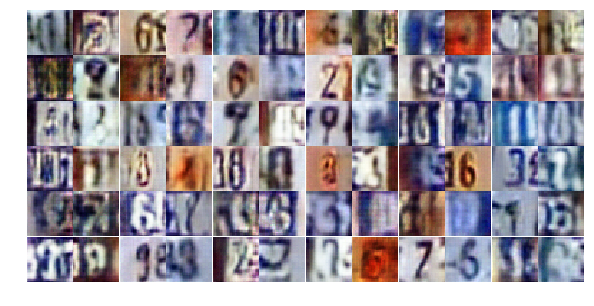

Epoch 8/25... Discriminator Loss: 0.6232... Generator Loss: 1.4884
Epoch 8/25... Discriminator Loss: 0.9206... Generator Loss: 0.6470
Epoch 8/25... Discriminator Loss: 0.4899... Generator Loss: 1.6523
Epoch 8/25... Discriminator Loss: 0.5511... Generator Loss: 1.5741
Epoch 8/25... Discriminator Loss: 1.5067... Generator Loss: 0.3250
Epoch 8/25... Discriminator Loss: 0.5137... Generator Loss: 1.3391
Epoch 8/25... Discriminator Loss: 0.5122... Generator Loss: 1.4692
Epoch 8/25... Discriminator Loss: 0.6583... Generator Loss: 1.0625
Epoch 8/25... Discriminator Loss: 0.6854... Generator Loss: 1.2495
Epoch 8/25... Discriminator Loss: 0.3929... Generator Loss: 1.5955


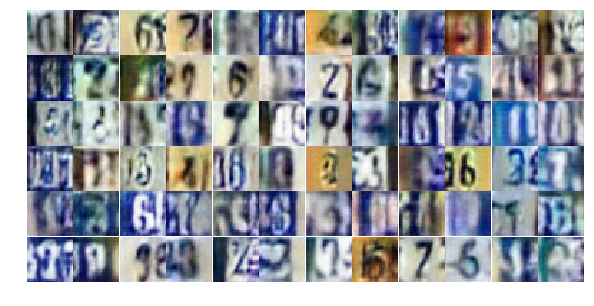

Epoch 8/25... Discriminator Loss: 0.5835... Generator Loss: 1.0989
Epoch 8/25... Discriminator Loss: 1.1363... Generator Loss: 0.5445
Epoch 8/25... Discriminator Loss: 0.9530... Generator Loss: 0.6683
Epoch 8/25... Discriminator Loss: 0.5043... Generator Loss: 1.4610
Epoch 8/25... Discriminator Loss: 1.2245... Generator Loss: 2.7769
Epoch 8/25... Discriminator Loss: 0.6847... Generator Loss: 0.9536
Epoch 8/25... Discriminator Loss: 0.5691... Generator Loss: 2.3390
Epoch 8/25... Discriminator Loss: 0.4847... Generator Loss: 2.5349
Epoch 8/25... Discriminator Loss: 0.6343... Generator Loss: 1.0603
Epoch 8/25... Discriminator Loss: 0.5327... Generator Loss: 1.2481


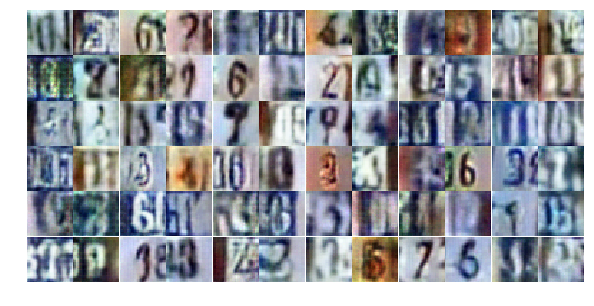

Epoch 8/25... Discriminator Loss: 0.5436... Generator Loss: 1.5462
Epoch 8/25... Discriminator Loss: 0.5011... Generator Loss: 1.4153
Epoch 8/25... Discriminator Loss: 0.4155... Generator Loss: 1.8589
Epoch 8/25... Discriminator Loss: 0.7362... Generator Loss: 0.9101
Epoch 8/25... Discriminator Loss: 0.4319... Generator Loss: 2.0354
Epoch 8/25... Discriminator Loss: 0.9931... Generator Loss: 0.6650
Epoch 8/25... Discriminator Loss: 0.6252... Generator Loss: 1.0457
Epoch 8/25... Discriminator Loss: 0.4051... Generator Loss: 2.3123
Epoch 9/25... Discriminator Loss: 0.8674... Generator Loss: 0.8905
Epoch 9/25... Discriminator Loss: 0.6231... Generator Loss: 0.9950


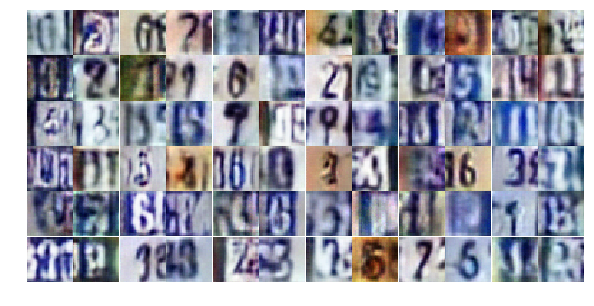

Epoch 9/25... Discriminator Loss: 0.5644... Generator Loss: 2.0051
Epoch 9/25... Discriminator Loss: 1.4057... Generator Loss: 2.0936
Epoch 9/25... Discriminator Loss: 1.1720... Generator Loss: 0.4794
Epoch 9/25... Discriminator Loss: 0.3754... Generator Loss: 1.8345
Epoch 9/25... Discriminator Loss: 1.6738... Generator Loss: 0.2883
Epoch 9/25... Discriminator Loss: 0.4759... Generator Loss: 2.2305
Epoch 9/25... Discriminator Loss: 0.5867... Generator Loss: 1.2311
Epoch 9/25... Discriminator Loss: 0.6084... Generator Loss: 1.3457
Epoch 9/25... Discriminator Loss: 0.8446... Generator Loss: 0.7841
Epoch 9/25... Discriminator Loss: 0.4826... Generator Loss: 1.4769


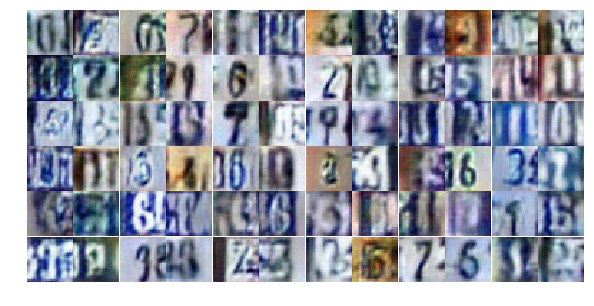

Epoch 9/25... Discriminator Loss: 1.0276... Generator Loss: 0.6136
Epoch 9/25... Discriminator Loss: 1.5336... Generator Loss: 1.5580
Epoch 9/25... Discriminator Loss: 0.8131... Generator Loss: 1.1995
Epoch 9/25... Discriminator Loss: 0.7280... Generator Loss: 0.9936
Epoch 9/25... Discriminator Loss: 0.4824... Generator Loss: 1.4335
Epoch 9/25... Discriminator Loss: 0.5505... Generator Loss: 1.3105
Epoch 9/25... Discriminator Loss: 0.9301... Generator Loss: 0.6825
Epoch 9/25... Discriminator Loss: 0.4393... Generator Loss: 1.5466
Epoch 9/25... Discriminator Loss: 0.7314... Generator Loss: 0.9848
Epoch 9/25... Discriminator Loss: 0.8912... Generator Loss: 0.7547


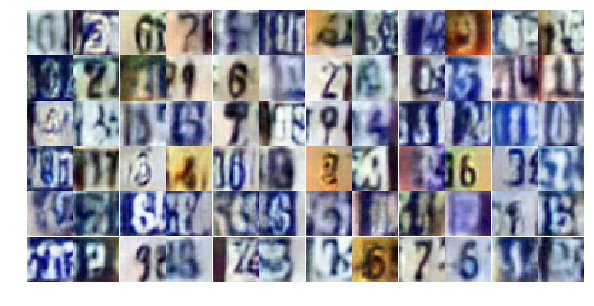

Epoch 9/25... Discriminator Loss: 0.6699... Generator Loss: 1.1524
Epoch 9/25... Discriminator Loss: 0.5434... Generator Loss: 1.5182
Epoch 9/25... Discriminator Loss: 0.5530... Generator Loss: 1.5823
Epoch 9/25... Discriminator Loss: 0.7586... Generator Loss: 0.8806
Epoch 9/25... Discriminator Loss: 0.4155... Generator Loss: 1.9912
Epoch 9/25... Discriminator Loss: 0.4305... Generator Loss: 1.7679
Epoch 9/25... Discriminator Loss: 0.5391... Generator Loss: 1.4943
Epoch 9/25... Discriminator Loss: 0.5066... Generator Loss: 1.3080
Epoch 9/25... Discriminator Loss: 0.4230... Generator Loss: 1.4564
Epoch 9/25... Discriminator Loss: 0.4027... Generator Loss: 1.5316


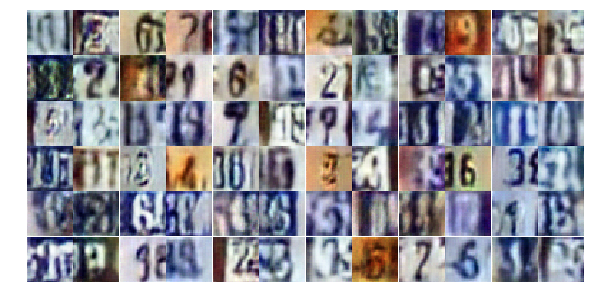

Epoch 9/25... Discriminator Loss: 0.4184... Generator Loss: 1.5429
Epoch 9/25... Discriminator Loss: 0.5682... Generator Loss: 1.1130
Epoch 9/25... Discriminator Loss: 1.3232... Generator Loss: 0.3996
Epoch 9/25... Discriminator Loss: 1.0931... Generator Loss: 0.5881
Epoch 9/25... Discriminator Loss: 0.5740... Generator Loss: 1.4120
Epoch 9/25... Discriminator Loss: 0.5694... Generator Loss: 1.4029
Epoch 9/25... Discriminator Loss: 0.5480... Generator Loss: 2.1275
Epoch 9/25... Discriminator Loss: 0.4839... Generator Loss: 1.3252
Epoch 9/25... Discriminator Loss: 0.9367... Generator Loss: 0.6468
Epoch 9/25... Discriminator Loss: 0.8603... Generator Loss: 0.7047


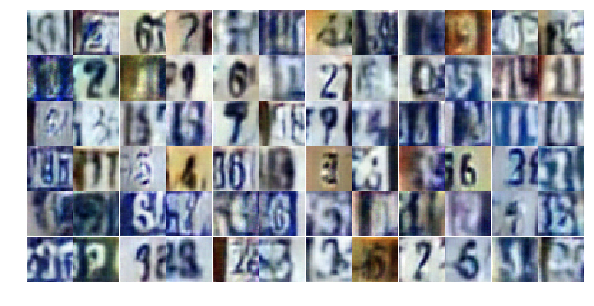

Epoch 9/25... Discriminator Loss: 0.4097... Generator Loss: 1.6227
Epoch 9/25... Discriminator Loss: 0.5792... Generator Loss: 1.1271
Epoch 9/25... Discriminator Loss: 0.6217... Generator Loss: 1.1687
Epoch 9/25... Discriminator Loss: 0.7748... Generator Loss: 2.7304
Epoch 9/25... Discriminator Loss: 0.5495... Generator Loss: 1.5767
Epoch 9/25... Discriminator Loss: 0.5020... Generator Loss: 1.3705
Epoch 9/25... Discriminator Loss: 0.7069... Generator Loss: 1.1106
Epoch 9/25... Discriminator Loss: 0.4500... Generator Loss: 1.3653
Epoch 9/25... Discriminator Loss: 0.4555... Generator Loss: 1.3840
Epoch 9/25... Discriminator Loss: 0.9612... Generator Loss: 3.4539


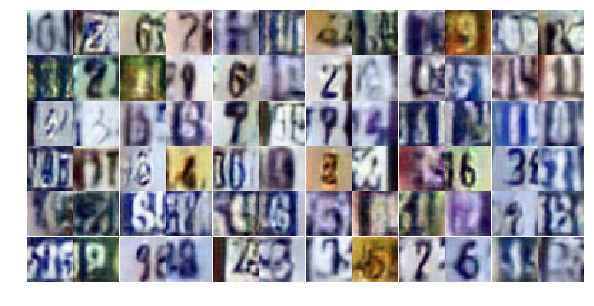

Epoch 9/25... Discriminator Loss: 0.8846... Generator Loss: 2.0990
Epoch 9/25... Discriminator Loss: 1.3602... Generator Loss: 2.6993
Epoch 9/25... Discriminator Loss: 0.6274... Generator Loss: 1.2049
Epoch 9/25... Discriminator Loss: 1.3475... Generator Loss: 0.3877
Epoch 9/25... Discriminator Loss: 0.5674... Generator Loss: 1.4227
Epoch 10/25... Discriminator Loss: 0.4515... Generator Loss: 1.5932
Epoch 10/25... Discriminator Loss: 0.5240... Generator Loss: 1.2104
Epoch 10/25... Discriminator Loss: 0.6222... Generator Loss: 0.9752
Epoch 10/25... Discriminator Loss: 0.5632... Generator Loss: 1.1749
Epoch 10/25... Discriminator Loss: 1.2532... Generator Loss: 0.4765


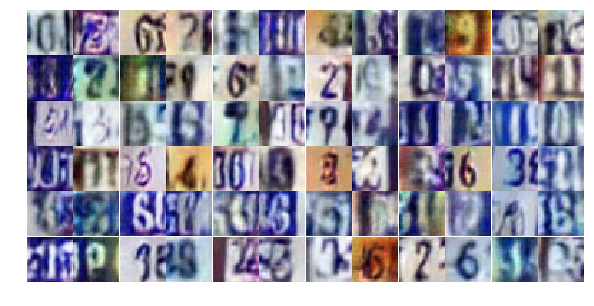

Epoch 10/25... Discriminator Loss: 0.5947... Generator Loss: 1.1121
Epoch 10/25... Discriminator Loss: 0.5368... Generator Loss: 1.2160
Epoch 10/25... Discriminator Loss: 0.4071... Generator Loss: 1.5522
Epoch 10/25... Discriminator Loss: 0.5759... Generator Loss: 1.2542
Epoch 10/25... Discriminator Loss: 0.4466... Generator Loss: 1.6215
Epoch 10/25... Discriminator Loss: 0.6588... Generator Loss: 1.6826
Epoch 10/25... Discriminator Loss: 0.5429... Generator Loss: 1.1886
Epoch 10/25... Discriminator Loss: 0.8153... Generator Loss: 0.8362
Epoch 10/25... Discriminator Loss: 0.8105... Generator Loss: 0.8788
Epoch 10/25... Discriminator Loss: 0.9818... Generator Loss: 0.6719


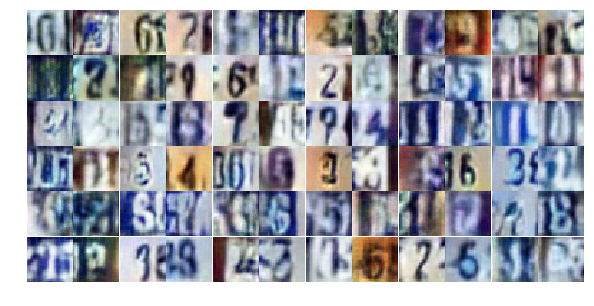

Epoch 10/25... Discriminator Loss: 1.8024... Generator Loss: 0.4347
Epoch 10/25... Discriminator Loss: 0.8131... Generator Loss: 0.8149
Epoch 10/25... Discriminator Loss: 0.5544... Generator Loss: 1.1761
Epoch 10/25... Discriminator Loss: 0.7417... Generator Loss: 0.9269
Epoch 10/25... Discriminator Loss: 0.4728... Generator Loss: 1.5992
Epoch 10/25... Discriminator Loss: 0.4978... Generator Loss: 1.4733
Epoch 10/25... Discriminator Loss: 0.6670... Generator Loss: 0.9593
Epoch 10/25... Discriminator Loss: 0.5091... Generator Loss: 1.1800
Epoch 10/25... Discriminator Loss: 1.0013... Generator Loss: 0.6460
Epoch 10/25... Discriminator Loss: 0.3860... Generator Loss: 1.6924


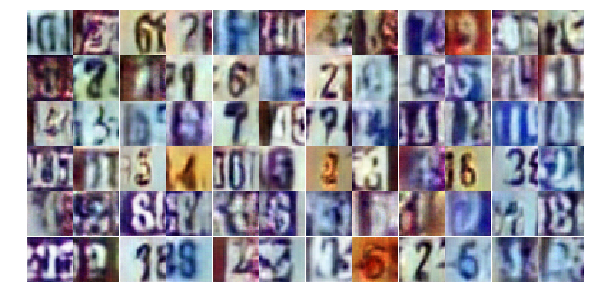

Epoch 10/25... Discriminator Loss: 1.8479... Generator Loss: 0.2413
Epoch 10/25... Discriminator Loss: 0.9695... Generator Loss: 0.7079
Epoch 10/25... Discriminator Loss: 0.4777... Generator Loss: 1.3867
Epoch 10/25... Discriminator Loss: 0.4872... Generator Loss: 2.3992
Epoch 10/25... Discriminator Loss: 1.3466... Generator Loss: 0.3644
Epoch 10/25... Discriminator Loss: 0.6332... Generator Loss: 1.0785
Epoch 10/25... Discriminator Loss: 0.3480... Generator Loss: 1.6770
Epoch 10/25... Discriminator Loss: 0.7470... Generator Loss: 1.0461
Epoch 10/25... Discriminator Loss: 0.6159... Generator Loss: 1.0893
Epoch 10/25... Discriminator Loss: 0.4488... Generator Loss: 1.6010


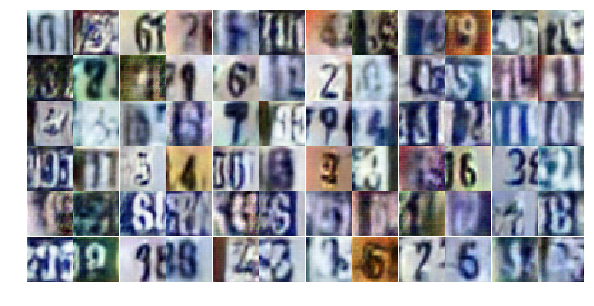

Epoch 10/25... Discriminator Loss: 1.1962... Generator Loss: 0.5264
Epoch 10/25... Discriminator Loss: 0.4695... Generator Loss: 1.6950
Epoch 10/25... Discriminator Loss: 0.5714... Generator Loss: 2.0755
Epoch 10/25... Discriminator Loss: 0.6108... Generator Loss: 1.6674
Epoch 10/25... Discriminator Loss: 0.6249... Generator Loss: 1.1279
Epoch 10/25... Discriminator Loss: 0.6003... Generator Loss: 1.0918
Epoch 10/25... Discriminator Loss: 0.5075... Generator Loss: 1.2397
Epoch 10/25... Discriminator Loss: 0.6813... Generator Loss: 0.9571
Epoch 10/25... Discriminator Loss: 0.4712... Generator Loss: 1.5004
Epoch 10/25... Discriminator Loss: 0.7077... Generator Loss: 2.7888


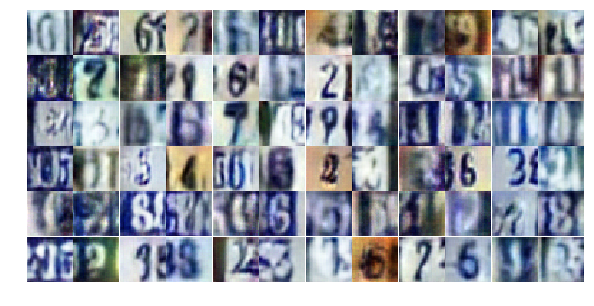

Epoch 10/25... Discriminator Loss: 1.1421... Generator Loss: 0.5640
Epoch 10/25... Discriminator Loss: 0.6182... Generator Loss: 1.1323
Epoch 10/25... Discriminator Loss: 0.5577... Generator Loss: 1.3112
Epoch 10/25... Discriminator Loss: 0.9699... Generator Loss: 0.6396
Epoch 10/25... Discriminator Loss: 0.4054... Generator Loss: 1.7410
Epoch 10/25... Discriminator Loss: 0.5187... Generator Loss: 1.3983
Epoch 10/25... Discriminator Loss: 0.7880... Generator Loss: 0.9051
Epoch 10/25... Discriminator Loss: 0.3913... Generator Loss: 3.1723
Epoch 10/25... Discriminator Loss: 0.6696... Generator Loss: 2.1253
Epoch 10/25... Discriminator Loss: 1.4192... Generator Loss: 4.5277


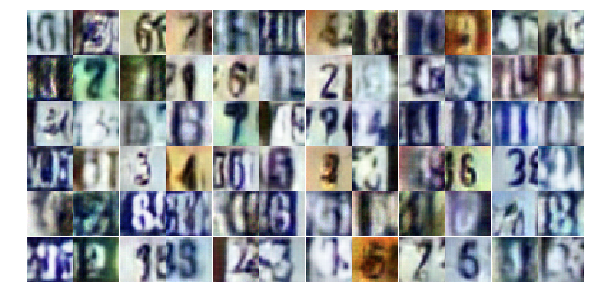

Epoch 10/25... Discriminator Loss: 0.9166... Generator Loss: 1.7832
Epoch 10/25... Discriminator Loss: 0.9559... Generator Loss: 0.7374
Epoch 10/25... Discriminator Loss: 0.4143... Generator Loss: 1.5665
Epoch 11/25... Discriminator Loss: 0.9574... Generator Loss: 0.6558
Epoch 11/25... Discriminator Loss: 0.5926... Generator Loss: 1.1390
Epoch 11/25... Discriminator Loss: 1.1745... Generator Loss: 0.5185
Epoch 11/25... Discriminator Loss: 0.6518... Generator Loss: 1.1384
Epoch 11/25... Discriminator Loss: 0.5913... Generator Loss: 2.0742
Epoch 11/25... Discriminator Loss: 1.6091... Generator Loss: 0.2889
Epoch 11/25... Discriminator Loss: 0.6519... Generator Loss: 1.0551


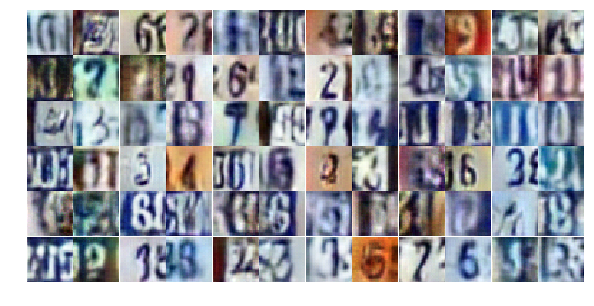

Epoch 11/25... Discriminator Loss: 0.3763... Generator Loss: 1.6222
Epoch 11/25... Discriminator Loss: 0.6304... Generator Loss: 1.0913
Epoch 11/25... Discriminator Loss: 0.4266... Generator Loss: 1.5748
Epoch 11/25... Discriminator Loss: 0.6683... Generator Loss: 0.9763
Epoch 11/25... Discriminator Loss: 0.7812... Generator Loss: 0.9336
Epoch 11/25... Discriminator Loss: 0.4145... Generator Loss: 1.8772
Epoch 11/25... Discriminator Loss: 0.6559... Generator Loss: 1.0802
Epoch 11/25... Discriminator Loss: 0.2788... Generator Loss: 1.7452
Epoch 11/25... Discriminator Loss: 0.7541... Generator Loss: 0.8906
Epoch 11/25... Discriminator Loss: 2.0415... Generator Loss: 0.2535


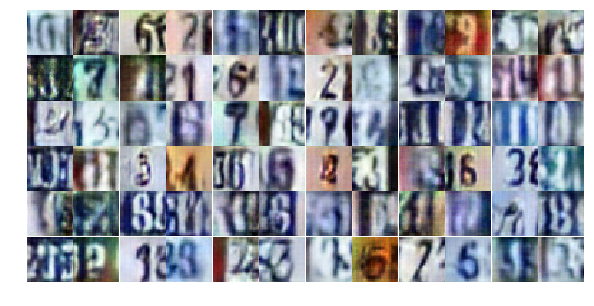

Epoch 11/25... Discriminator Loss: 0.9720... Generator Loss: 0.7938
Epoch 11/25... Discriminator Loss: 0.4854... Generator Loss: 1.9941
Epoch 11/25... Discriminator Loss: 1.0278... Generator Loss: 0.5977
Epoch 11/25... Discriminator Loss: 0.5331... Generator Loss: 1.1686
Epoch 11/25... Discriminator Loss: 0.2959... Generator Loss: 2.0041
Epoch 11/25... Discriminator Loss: 0.4400... Generator Loss: 1.7598
Epoch 11/25... Discriminator Loss: 0.4116... Generator Loss: 1.7843
Epoch 11/25... Discriminator Loss: 1.0884... Generator Loss: 0.5542
Epoch 11/25... Discriminator Loss: 0.3201... Generator Loss: 1.9945
Epoch 11/25... Discriminator Loss: 0.6209... Generator Loss: 1.0514


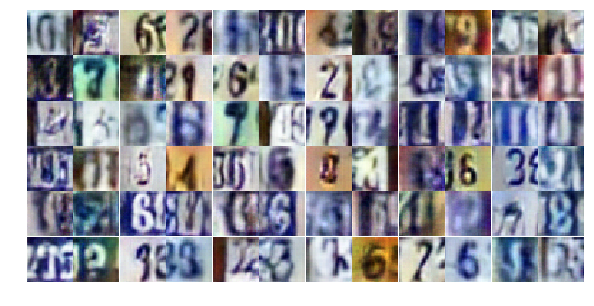

Epoch 11/25... Discriminator Loss: 1.0681... Generator Loss: 0.5830
Epoch 11/25... Discriminator Loss: 0.5984... Generator Loss: 1.8971
Epoch 11/25... Discriminator Loss: 0.7321... Generator Loss: 0.9792
Epoch 11/25... Discriminator Loss: 0.4215... Generator Loss: 1.4325
Epoch 11/25... Discriminator Loss: 0.8138... Generator Loss: 0.8457
Epoch 11/25... Discriminator Loss: 1.0598... Generator Loss: 0.5748
Epoch 11/25... Discriminator Loss: 1.6893... Generator Loss: 0.2679
Epoch 11/25... Discriminator Loss: 0.8474... Generator Loss: 0.7309
Epoch 11/25... Discriminator Loss: 0.5100... Generator Loss: 1.2718
Epoch 11/25... Discriminator Loss: 1.0757... Generator Loss: 0.5678


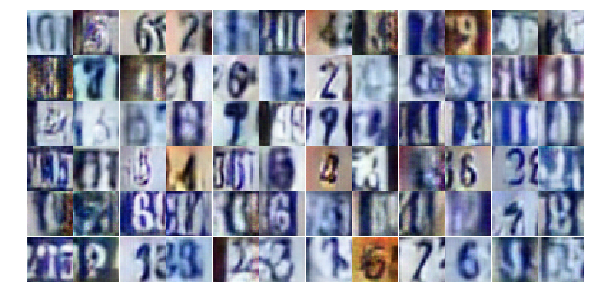

Epoch 11/25... Discriminator Loss: 0.4990... Generator Loss: 1.5637
Epoch 11/25... Discriminator Loss: 0.9250... Generator Loss: 0.7075
Epoch 11/25... Discriminator Loss: 0.9615... Generator Loss: 0.6550
Epoch 11/25... Discriminator Loss: 0.7095... Generator Loss: 0.9916
Epoch 11/25... Discriminator Loss: 0.9512... Generator Loss: 0.7184
Epoch 11/25... Discriminator Loss: 0.4727... Generator Loss: 1.3129
Epoch 11/25... Discriminator Loss: 0.2550... Generator Loss: 2.1091
Epoch 11/25... Discriminator Loss: 0.8788... Generator Loss: 0.7205
Epoch 11/25... Discriminator Loss: 1.5251... Generator Loss: 0.3504
Epoch 11/25... Discriminator Loss: 0.4750... Generator Loss: 1.3534


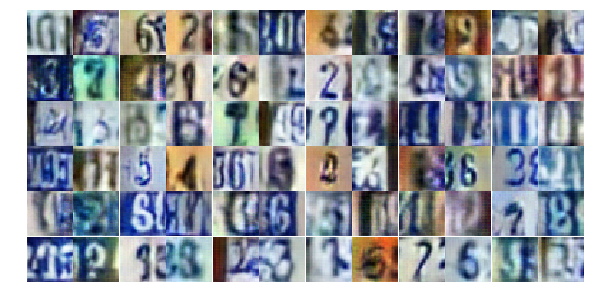

Epoch 11/25... Discriminator Loss: 0.9399... Generator Loss: 0.6732
Epoch 11/25... Discriminator Loss: 0.2388... Generator Loss: 2.2449
Epoch 11/25... Discriminator Loss: 0.6960... Generator Loss: 0.9308
Epoch 11/25... Discriminator Loss: 1.2948... Generator Loss: 0.4567
Epoch 11/25... Discriminator Loss: 1.4004... Generator Loss: 0.4164
Epoch 11/25... Discriminator Loss: 0.7038... Generator Loss: 0.9405
Epoch 11/25... Discriminator Loss: 1.1762... Generator Loss: 3.3117
Epoch 11/25... Discriminator Loss: 0.6783... Generator Loss: 2.1196
Epoch 11/25... Discriminator Loss: 1.1530... Generator Loss: 0.6345
Epoch 11/25... Discriminator Loss: 0.7533... Generator Loss: 1.0037


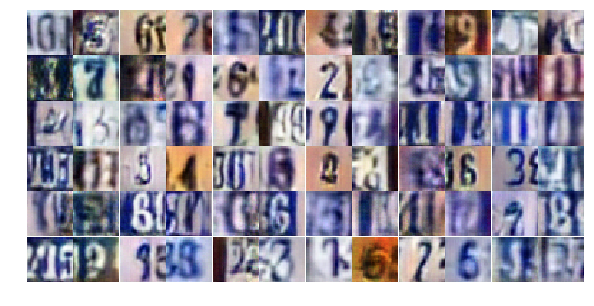

Epoch 12/25... Discriminator Loss: 0.6668... Generator Loss: 1.0856
Epoch 12/25... Discriminator Loss: 0.6663... Generator Loss: 1.0307
Epoch 12/25... Discriminator Loss: 0.6334... Generator Loss: 1.4288
Epoch 12/25... Discriminator Loss: 0.4670... Generator Loss: 1.7194
Epoch 12/25... Discriminator Loss: 0.3871... Generator Loss: 1.6377
Epoch 12/25... Discriminator Loss: 0.9525... Generator Loss: 0.6982
Epoch 12/25... Discriminator Loss: 0.4452... Generator Loss: 1.8143
Epoch 12/25... Discriminator Loss: 0.3876... Generator Loss: 1.8089
Epoch 12/25... Discriminator Loss: 0.7277... Generator Loss: 1.1393
Epoch 12/25... Discriminator Loss: 1.2518... Generator Loss: 0.4593


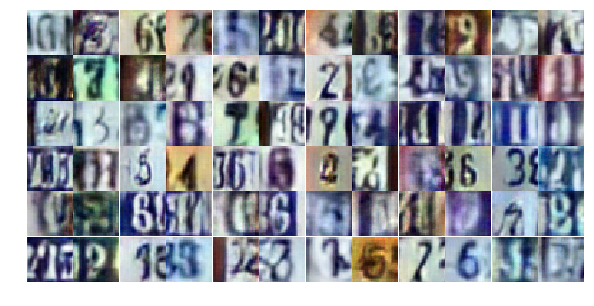

Epoch 12/25... Discriminator Loss: 0.5288... Generator Loss: 1.2560
Epoch 12/25... Discriminator Loss: 0.8710... Generator Loss: 0.7490
Epoch 12/25... Discriminator Loss: 0.4553... Generator Loss: 1.4903
Epoch 12/25... Discriminator Loss: 0.5019... Generator Loss: 1.7318
Epoch 12/25... Discriminator Loss: 0.2889... Generator Loss: 2.1426
Epoch 12/25... Discriminator Loss: 1.0352... Generator Loss: 0.6860
Epoch 12/25... Discriminator Loss: 1.7842... Generator Loss: 0.2404
Epoch 12/25... Discriminator Loss: 0.6179... Generator Loss: 1.4964
Epoch 12/25... Discriminator Loss: 0.6438... Generator Loss: 1.8225
Epoch 12/25... Discriminator Loss: 0.9616... Generator Loss: 0.7832


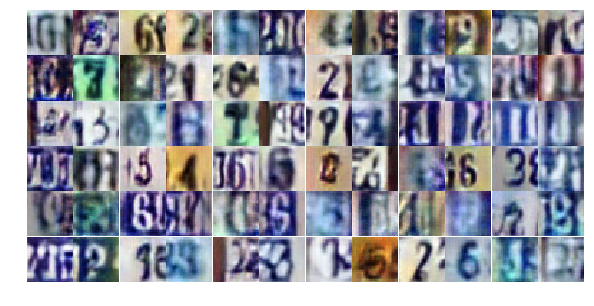

Epoch 12/25... Discriminator Loss: 0.4637... Generator Loss: 2.6215
Epoch 12/25... Discriminator Loss: 0.4690... Generator Loss: 1.4205
Epoch 12/25... Discriminator Loss: 0.6066... Generator Loss: 1.0992
Epoch 12/25... Discriminator Loss: 0.4208... Generator Loss: 1.8782
Epoch 12/25... Discriminator Loss: 0.3773... Generator Loss: 1.8352
Epoch 12/25... Discriminator Loss: 0.4432... Generator Loss: 1.4974
Epoch 12/25... Discriminator Loss: 0.4833... Generator Loss: 1.4227
Epoch 12/25... Discriminator Loss: 0.3337... Generator Loss: 1.9193
Epoch 12/25... Discriminator Loss: 0.5933... Generator Loss: 1.2547
Epoch 12/25... Discriminator Loss: 0.9240... Generator Loss: 0.6762


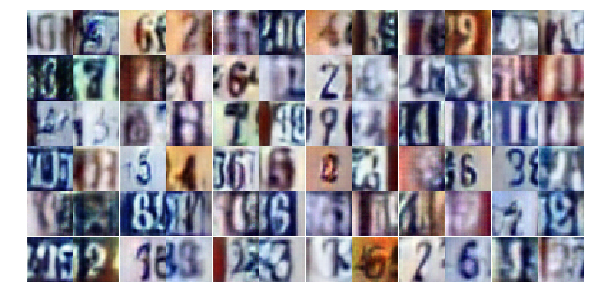

Epoch 12/25... Discriminator Loss: 0.6425... Generator Loss: 1.0883
Epoch 12/25... Discriminator Loss: 1.0099... Generator Loss: 0.6173
Epoch 12/25... Discriminator Loss: 0.8183... Generator Loss: 0.8162
Epoch 12/25... Discriminator Loss: 1.8851... Generator Loss: 0.2401
Epoch 12/25... Discriminator Loss: 0.5506... Generator Loss: 2.1500
Epoch 12/25... Discriminator Loss: 0.6981... Generator Loss: 1.0050
Epoch 12/25... Discriminator Loss: 0.6561... Generator Loss: 1.0633
Epoch 12/25... Discriminator Loss: 0.5335... Generator Loss: 1.3800
Epoch 12/25... Discriminator Loss: 0.5018... Generator Loss: 1.2970
Epoch 12/25... Discriminator Loss: 0.2651... Generator Loss: 1.8712


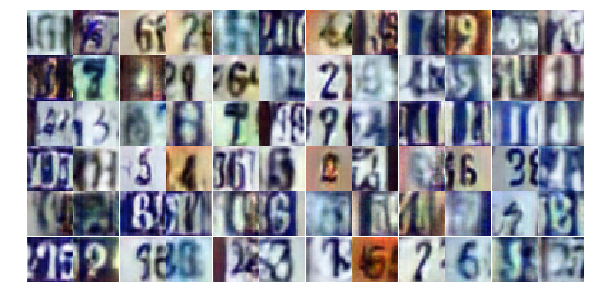

Epoch 12/25... Discriminator Loss: 0.7319... Generator Loss: 0.8458
Epoch 12/25... Discriminator Loss: 0.2806... Generator Loss: 1.9546
Epoch 12/25... Discriminator Loss: 0.3815... Generator Loss: 1.5163
Epoch 12/25... Discriminator Loss: 0.6235... Generator Loss: 1.0722
Epoch 12/25... Discriminator Loss: 0.9759... Generator Loss: 0.7506
Epoch 12/25... Discriminator Loss: 1.0587... Generator Loss: 0.6032
Epoch 12/25... Discriminator Loss: 0.9335... Generator Loss: 0.7847
Epoch 12/25... Discriminator Loss: 0.8123... Generator Loss: 0.8651
Epoch 12/25... Discriminator Loss: 0.4042... Generator Loss: 1.6355
Epoch 12/25... Discriminator Loss: 0.9042... Generator Loss: 0.6740


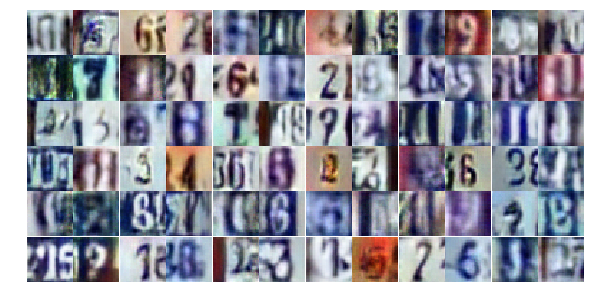

Epoch 12/25... Discriminator Loss: 0.9205... Generator Loss: 0.7134
Epoch 12/25... Discriminator Loss: 0.4960... Generator Loss: 1.5110
Epoch 12/25... Discriminator Loss: 0.4596... Generator Loss: 2.3279
Epoch 12/25... Discriminator Loss: 1.4396... Generator Loss: 0.4684
Epoch 12/25... Discriminator Loss: 0.5139... Generator Loss: 1.3867
Epoch 12/25... Discriminator Loss: 0.8766... Generator Loss: 2.4299
Epoch 12/25... Discriminator Loss: 0.8351... Generator Loss: 1.0078
Epoch 13/25... Discriminator Loss: 0.5149... Generator Loss: 1.4137
Epoch 13/25... Discriminator Loss: 0.4274... Generator Loss: 1.5401
Epoch 13/25... Discriminator Loss: 0.6718... Generator Loss: 1.1451


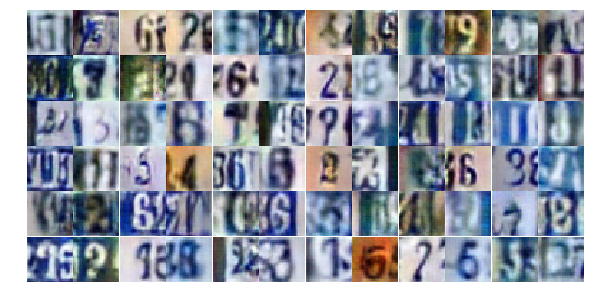

Epoch 13/25... Discriminator Loss: 0.6484... Generator Loss: 1.0395
Epoch 13/25... Discriminator Loss: 0.5174... Generator Loss: 1.8948
Epoch 13/25... Discriminator Loss: 1.6568... Generator Loss: 0.2974
Epoch 13/25... Discriminator Loss: 1.6330... Generator Loss: 0.3214
Epoch 13/25... Discriminator Loss: 0.5277... Generator Loss: 1.6474
Epoch 13/25... Discriminator Loss: 0.5657... Generator Loss: 1.3788
Epoch 13/25... Discriminator Loss: 0.4735... Generator Loss: 1.7808
Epoch 13/25... Discriminator Loss: 0.4268... Generator Loss: 1.4276
Epoch 13/25... Discriminator Loss: 0.4559... Generator Loss: 1.3624
Epoch 13/25... Discriminator Loss: 0.4877... Generator Loss: 1.3717


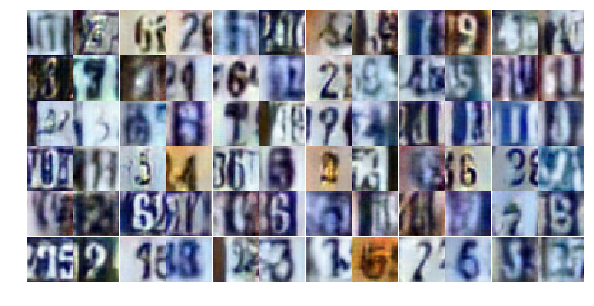

Epoch 13/25... Discriminator Loss: 0.6443... Generator Loss: 1.1340
Epoch 13/25... Discriminator Loss: 0.4630... Generator Loss: 1.4024
Epoch 13/25... Discriminator Loss: 3.3272... Generator Loss: 5.7687
Epoch 13/25... Discriminator Loss: 0.9385... Generator Loss: 0.7285
Epoch 13/25... Discriminator Loss: 0.5107... Generator Loss: 2.1302
Epoch 13/25... Discriminator Loss: 1.0338... Generator Loss: 0.5883
Epoch 13/25... Discriminator Loss: 0.6064... Generator Loss: 1.2483
Epoch 13/25... Discriminator Loss: 1.0781... Generator Loss: 0.5605
Epoch 13/25... Discriminator Loss: 0.6218... Generator Loss: 1.1216
Epoch 13/25... Discriminator Loss: 0.9207... Generator Loss: 0.7112


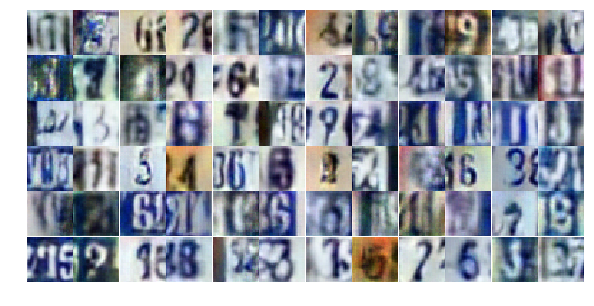

Epoch 13/25... Discriminator Loss: 0.8569... Generator Loss: 0.7667
Epoch 13/25... Discriminator Loss: 0.4732... Generator Loss: 1.6695
Epoch 13/25... Discriminator Loss: 0.5532... Generator Loss: 1.6242
Epoch 13/25... Discriminator Loss: 0.6372... Generator Loss: 1.0532
Epoch 13/25... Discriminator Loss: 0.6433... Generator Loss: 1.0664
Epoch 13/25... Discriminator Loss: 0.8381... Generator Loss: 0.8201
Epoch 13/25... Discriminator Loss: 0.7268... Generator Loss: 1.7359
Epoch 13/25... Discriminator Loss: 0.5616... Generator Loss: 1.2264
Epoch 13/25... Discriminator Loss: 0.5205... Generator Loss: 1.3025
Epoch 13/25... Discriminator Loss: 0.4708... Generator Loss: 1.3861


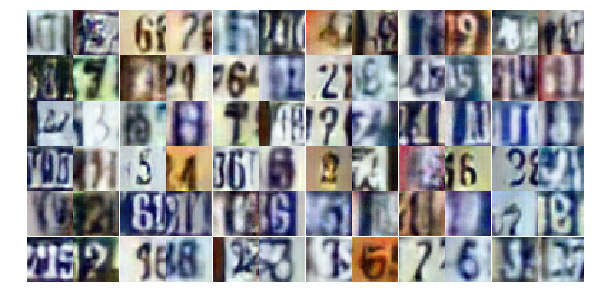

Epoch 13/25... Discriminator Loss: 1.0220... Generator Loss: 0.6242
Epoch 13/25... Discriminator Loss: 0.7211... Generator Loss: 1.9124
Epoch 13/25... Discriminator Loss: 0.8084... Generator Loss: 0.8039
Epoch 13/25... Discriminator Loss: 1.1591... Generator Loss: 0.5485
Epoch 13/25... Discriminator Loss: 0.4935... Generator Loss: 1.3828
Epoch 13/25... Discriminator Loss: 0.4043... Generator Loss: 1.8364
Epoch 13/25... Discriminator Loss: 0.5257... Generator Loss: 1.1662
Epoch 13/25... Discriminator Loss: 1.1034... Generator Loss: 0.5323
Epoch 13/25... Discriminator Loss: 0.5320... Generator Loss: 1.2777
Epoch 13/25... Discriminator Loss: 0.5733... Generator Loss: 1.0910


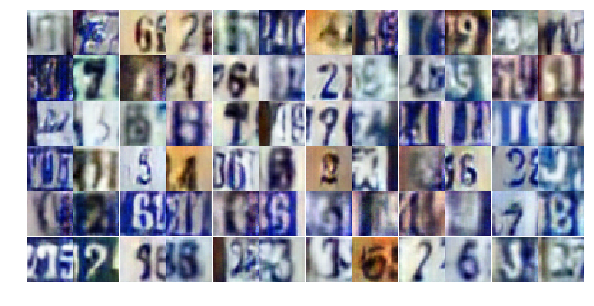

Epoch 13/25... Discriminator Loss: 0.5220... Generator Loss: 1.2717
Epoch 13/25... Discriminator Loss: 1.5348... Generator Loss: 3.0416
Epoch 13/25... Discriminator Loss: 0.7708... Generator Loss: 1.0130
Epoch 13/25... Discriminator Loss: 0.4330... Generator Loss: 1.3177
Epoch 13/25... Discriminator Loss: 1.1445... Generator Loss: 0.5408
Epoch 13/25... Discriminator Loss: 0.5636... Generator Loss: 1.3962
Epoch 13/25... Discriminator Loss: 0.5813... Generator Loss: 1.2159
Epoch 13/25... Discriminator Loss: 0.6662... Generator Loss: 1.0447
Epoch 13/25... Discriminator Loss: 0.9046... Generator Loss: 0.7114
Epoch 13/25... Discriminator Loss: 0.7345... Generator Loss: 0.9362


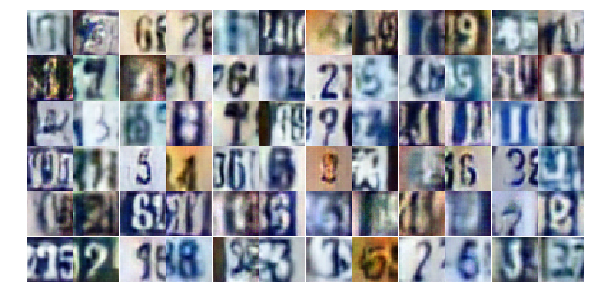

Epoch 13/25... Discriminator Loss: 0.2986... Generator Loss: 2.2161
Epoch 13/25... Discriminator Loss: 0.9312... Generator Loss: 0.7757
Epoch 13/25... Discriminator Loss: 0.6936... Generator Loss: 1.0746
Epoch 13/25... Discriminator Loss: 0.5286... Generator Loss: 1.3955
Epoch 14/25... Discriminator Loss: 0.9144... Generator Loss: 0.6797
Epoch 14/25... Discriminator Loss: 0.8584... Generator Loss: 0.7641
Epoch 14/25... Discriminator Loss: 0.5573... Generator Loss: 1.3316
Epoch 14/25... Discriminator Loss: 0.3571... Generator Loss: 2.5170
Epoch 14/25... Discriminator Loss: 0.5894... Generator Loss: 1.1274
Epoch 14/25... Discriminator Loss: 0.6244... Generator Loss: 1.0222


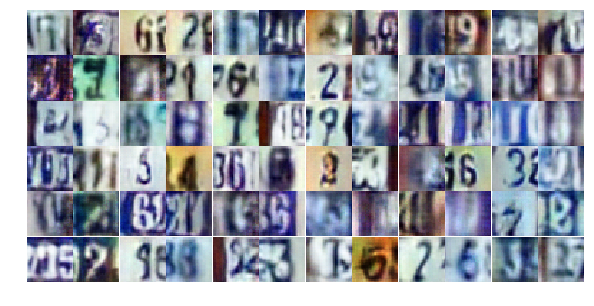

Epoch 14/25... Discriminator Loss: 1.0202... Generator Loss: 2.6253
Epoch 14/25... Discriminator Loss: 0.9563... Generator Loss: 1.0326
Epoch 14/25... Discriminator Loss: 0.8756... Generator Loss: 0.7532
Epoch 14/25... Discriminator Loss: 0.6412... Generator Loss: 1.1587
Epoch 14/25... Discriminator Loss: 1.0413... Generator Loss: 0.5782
Epoch 14/25... Discriminator Loss: 0.3244... Generator Loss: 1.6512
Epoch 14/25... Discriminator Loss: 0.3326... Generator Loss: 1.8292
Epoch 14/25... Discriminator Loss: 1.3827... Generator Loss: 0.3880
Epoch 14/25... Discriminator Loss: 1.1768... Generator Loss: 0.5193
Epoch 14/25... Discriminator Loss: 1.5522... Generator Loss: 0.3346


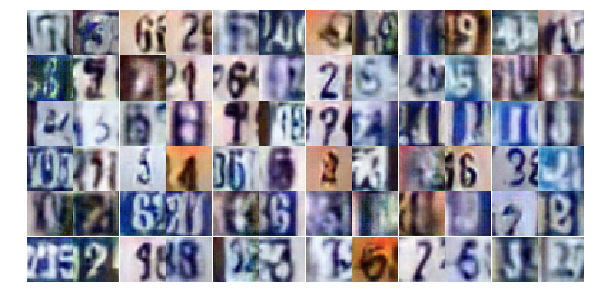

Epoch 14/25... Discriminator Loss: 0.8100... Generator Loss: 0.8436
Epoch 14/25... Discriminator Loss: 2.2708... Generator Loss: 0.2054
Epoch 14/25... Discriminator Loss: 0.7547... Generator Loss: 1.8338
Epoch 14/25... Discriminator Loss: 0.5050... Generator Loss: 1.3832
Epoch 14/25... Discriminator Loss: 1.0608... Generator Loss: 0.6440
Epoch 14/25... Discriminator Loss: 0.9581... Generator Loss: 0.7052
Epoch 14/25... Discriminator Loss: 0.7122... Generator Loss: 0.9879
Epoch 14/25... Discriminator Loss: 0.7739... Generator Loss: 0.8672
Epoch 14/25... Discriminator Loss: 0.4824... Generator Loss: 1.3589
Epoch 14/25... Discriminator Loss: 0.5061... Generator Loss: 1.4819


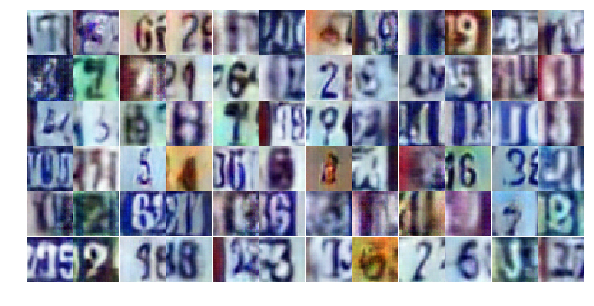

Epoch 14/25... Discriminator Loss: 0.9188... Generator Loss: 0.7380
Epoch 14/25... Discriminator Loss: 0.4977... Generator Loss: 1.2735
Epoch 14/25... Discriminator Loss: 0.7183... Generator Loss: 0.8894
Epoch 14/25... Discriminator Loss: 0.4152... Generator Loss: 1.3832
Epoch 14/25... Discriminator Loss: 0.5214... Generator Loss: 1.2445
Epoch 14/25... Discriminator Loss: 0.5416... Generator Loss: 1.2347
Epoch 14/25... Discriminator Loss: 0.6083... Generator Loss: 1.1000
Epoch 14/25... Discriminator Loss: 0.4109... Generator Loss: 3.2495
Epoch 14/25... Discriminator Loss: 0.3026... Generator Loss: 2.4597
Epoch 14/25... Discriminator Loss: 1.0287... Generator Loss: 1.6781


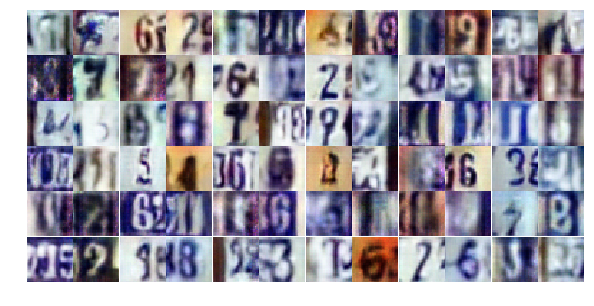

Epoch 14/25... Discriminator Loss: 0.9196... Generator Loss: 0.8063
Epoch 14/25... Discriminator Loss: 0.6714... Generator Loss: 1.3212
Epoch 14/25... Discriminator Loss: 0.9796... Generator Loss: 0.6384
Epoch 14/25... Discriminator Loss: 0.8009... Generator Loss: 0.8325
Epoch 14/25... Discriminator Loss: 0.8530... Generator Loss: 0.7720
Epoch 14/25... Discriminator Loss: 0.7999... Generator Loss: 0.8449
Epoch 14/25... Discriminator Loss: 0.7257... Generator Loss: 0.9255
Epoch 14/25... Discriminator Loss: 0.7514... Generator Loss: 0.8950
Epoch 14/25... Discriminator Loss: 1.2795... Generator Loss: 0.5407
Epoch 14/25... Discriminator Loss: 1.7126... Generator Loss: 0.2661


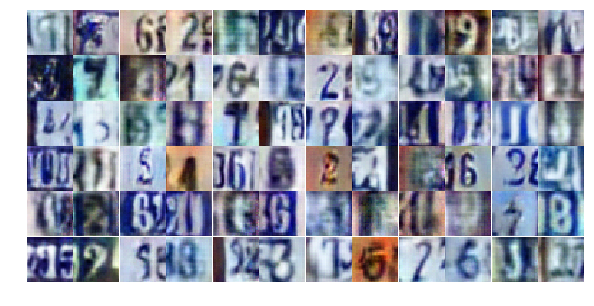

Epoch 14/25... Discriminator Loss: 0.7771... Generator Loss: 1.0641
Epoch 14/25... Discriminator Loss: 1.2214... Generator Loss: 0.4625
Epoch 14/25... Discriminator Loss: 0.6154... Generator Loss: 1.1489
Epoch 14/25... Discriminator Loss: 1.1583... Generator Loss: 0.5814
Epoch 14/25... Discriminator Loss: 0.6887... Generator Loss: 1.0548
Epoch 14/25... Discriminator Loss: 0.7320... Generator Loss: 0.8726
Epoch 14/25... Discriminator Loss: 0.6275... Generator Loss: 1.1173
Epoch 14/25... Discriminator Loss: 0.5383... Generator Loss: 1.3341
Epoch 14/25... Discriminator Loss: 1.1948... Generator Loss: 2.8546
Epoch 14/25... Discriminator Loss: 0.5664... Generator Loss: 1.1171


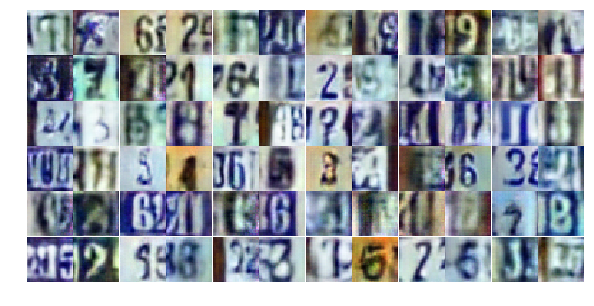

Epoch 14/25... Discriminator Loss: 0.8575... Generator Loss: 0.9334
Epoch 14/25... Discriminator Loss: 1.0823... Generator Loss: 0.6113
Epoch 15/25... Discriminator Loss: 0.4974... Generator Loss: 1.3123
Epoch 15/25... Discriminator Loss: 0.5691... Generator Loss: 1.2173
Epoch 15/25... Discriminator Loss: 0.4757... Generator Loss: 1.3960
Epoch 15/25... Discriminator Loss: 0.8717... Generator Loss: 0.7537
Epoch 15/25... Discriminator Loss: 1.2451... Generator Loss: 0.4714
Epoch 15/25... Discriminator Loss: 0.5406... Generator Loss: 1.2550
Epoch 15/25... Discriminator Loss: 1.3136... Generator Loss: 0.4421
Epoch 15/25... Discriminator Loss: 0.6207... Generator Loss: 1.1339


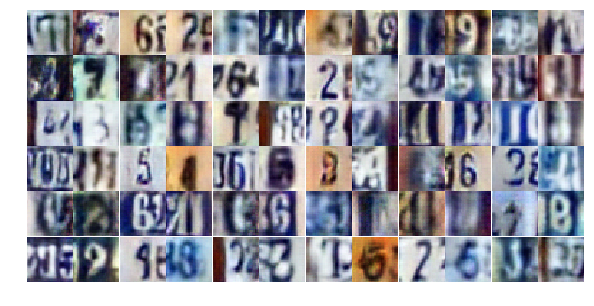

Epoch 15/25... Discriminator Loss: 0.7848... Generator Loss: 0.8104
Epoch 15/25... Discriminator Loss: 0.7449... Generator Loss: 2.4337
Epoch 15/25... Discriminator Loss: 0.6477... Generator Loss: 1.0926
Epoch 15/25... Discriminator Loss: 0.8330... Generator Loss: 0.7830
Epoch 15/25... Discriminator Loss: 1.0809... Generator Loss: 0.6079
Epoch 15/25... Discriminator Loss: 0.3125... Generator Loss: 2.0852
Epoch 15/25... Discriminator Loss: 1.0615... Generator Loss: 0.5629
Epoch 15/25... Discriminator Loss: 1.0591... Generator Loss: 0.7117
Epoch 15/25... Discriminator Loss: 0.4302... Generator Loss: 2.5139
Epoch 15/25... Discriminator Loss: 0.9327... Generator Loss: 0.7160


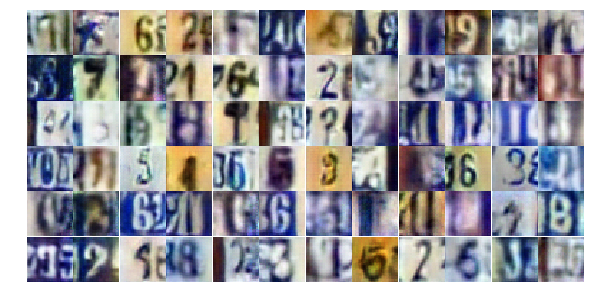

Epoch 15/25... Discriminator Loss: 0.8899... Generator Loss: 0.7912
Epoch 15/25... Discriminator Loss: 0.5331... Generator Loss: 1.2289
Epoch 15/25... Discriminator Loss: 0.3630... Generator Loss: 1.8415
Epoch 15/25... Discriminator Loss: 0.7860... Generator Loss: 0.8206
Epoch 15/25... Discriminator Loss: 0.8078... Generator Loss: 0.9230
Epoch 15/25... Discriminator Loss: 1.1722... Generator Loss: 0.6638
Epoch 15/25... Discriminator Loss: 0.7960... Generator Loss: 0.9620
Epoch 15/25... Discriminator Loss: 0.7480... Generator Loss: 0.9801
Epoch 15/25... Discriminator Loss: 0.5253... Generator Loss: 1.2331
Epoch 15/25... Discriminator Loss: 1.1765... Generator Loss: 0.5571


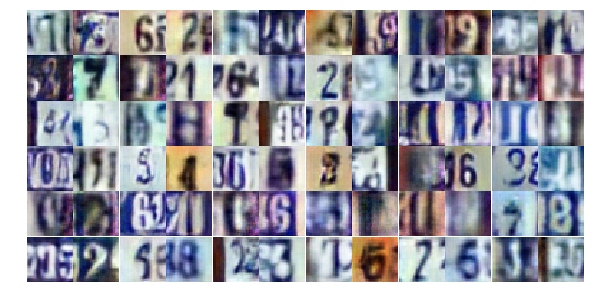

Epoch 15/25... Discriminator Loss: 0.7202... Generator Loss: 1.1745
Epoch 15/25... Discriminator Loss: 1.0558... Generator Loss: 0.6733
Epoch 15/25... Discriminator Loss: 0.4903... Generator Loss: 1.2322
Epoch 15/25... Discriminator Loss: 0.6644... Generator Loss: 1.2725
Epoch 15/25... Discriminator Loss: 0.6545... Generator Loss: 1.0234
Epoch 15/25... Discriminator Loss: 0.8063... Generator Loss: 1.9897
Epoch 15/25... Discriminator Loss: 0.9049... Generator Loss: 0.7825
Epoch 15/25... Discriminator Loss: 0.5867... Generator Loss: 1.8658
Epoch 15/25... Discriminator Loss: 0.5729... Generator Loss: 1.1686
Epoch 15/25... Discriminator Loss: 0.5004... Generator Loss: 1.3907


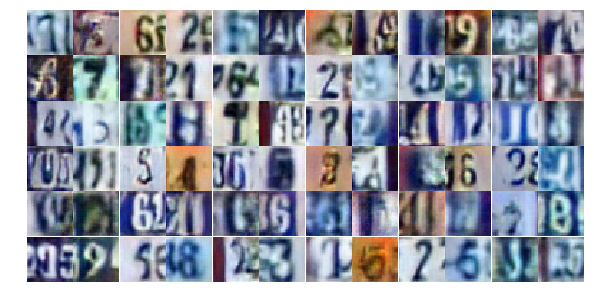

Epoch 15/25... Discriminator Loss: 0.5560... Generator Loss: 1.1519
Epoch 15/25... Discriminator Loss: 1.4368... Generator Loss: 0.3822
Epoch 15/25... Discriminator Loss: 0.6486... Generator Loss: 1.0977
Epoch 15/25... Discriminator Loss: 0.3434... Generator Loss: 1.7093
Epoch 15/25... Discriminator Loss: 0.7530... Generator Loss: 0.8451
Epoch 15/25... Discriminator Loss: 2.1968... Generator Loss: 0.2035
Epoch 15/25... Discriminator Loss: 1.1246... Generator Loss: 5.1012
Epoch 15/25... Discriminator Loss: 1.7660... Generator Loss: 0.3335
Epoch 15/25... Discriminator Loss: 0.9741... Generator Loss: 0.6601
Epoch 15/25... Discriminator Loss: 0.8495... Generator Loss: 0.8174


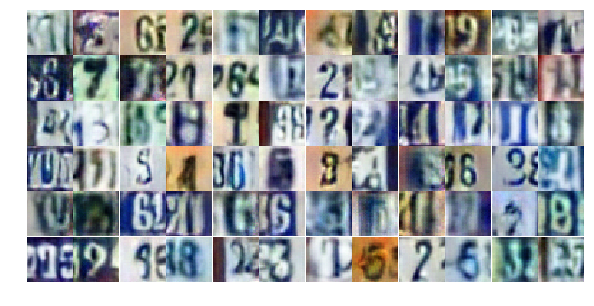

Epoch 15/25... Discriminator Loss: 1.1226... Generator Loss: 0.5627
Epoch 15/25... Discriminator Loss: 0.8911... Generator Loss: 0.8997
Epoch 15/25... Discriminator Loss: 0.5288... Generator Loss: 1.2793
Epoch 15/25... Discriminator Loss: 0.7745... Generator Loss: 0.8800
Epoch 15/25... Discriminator Loss: 0.6052... Generator Loss: 1.1499
Epoch 15/25... Discriminator Loss: 0.7298... Generator Loss: 0.9553
Epoch 15/25... Discriminator Loss: 0.9049... Generator Loss: 0.7832
Epoch 15/25... Discriminator Loss: 0.5076... Generator Loss: 1.5334
Epoch 15/25... Discriminator Loss: 1.4243... Generator Loss: 0.3838
Epoch 16/25... Discriminator Loss: 1.3997... Generator Loss: 0.3850


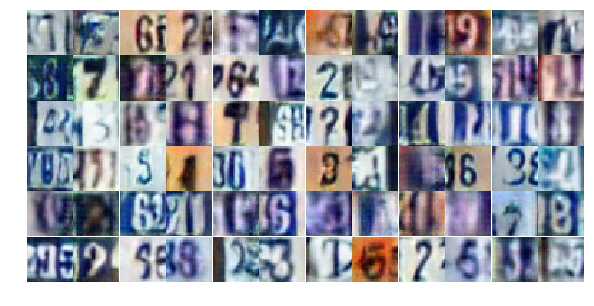

Epoch 16/25... Discriminator Loss: 0.5217... Generator Loss: 1.2709
Epoch 16/25... Discriminator Loss: 0.7368... Generator Loss: 0.9902
Epoch 16/25... Discriminator Loss: 0.6618... Generator Loss: 1.1269
Epoch 16/25... Discriminator Loss: 0.5734... Generator Loss: 1.2840
Epoch 16/25... Discriminator Loss: 0.5547... Generator Loss: 1.9543
Epoch 16/25... Discriminator Loss: 0.7059... Generator Loss: 2.8065
Epoch 16/25... Discriminator Loss: 1.4253... Generator Loss: 0.4025
Epoch 16/25... Discriminator Loss: 0.6901... Generator Loss: 0.9971
Epoch 16/25... Discriminator Loss: 0.5943... Generator Loss: 1.1333
Epoch 16/25... Discriminator Loss: 0.5240... Generator Loss: 1.3810


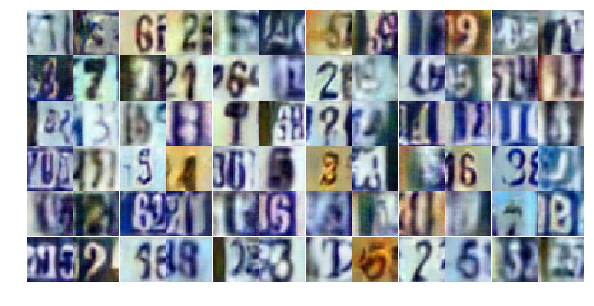

Epoch 16/25... Discriminator Loss: 1.5019... Generator Loss: 0.4093
Epoch 16/25... Discriminator Loss: 0.5897... Generator Loss: 1.1891
Epoch 16/25... Discriminator Loss: 0.7082... Generator Loss: 0.9703
Epoch 16/25... Discriminator Loss: 1.4811... Generator Loss: 0.3480
Epoch 16/25... Discriminator Loss: 0.4610... Generator Loss: 1.4139
Epoch 16/25... Discriminator Loss: 0.6224... Generator Loss: 1.2200
Epoch 16/25... Discriminator Loss: 1.5836... Generator Loss: 0.4325
Epoch 16/25... Discriminator Loss: 0.3976... Generator Loss: 1.7290
Epoch 16/25... Discriminator Loss: 0.5113... Generator Loss: 1.2229
Epoch 16/25... Discriminator Loss: 0.4992... Generator Loss: 1.3350


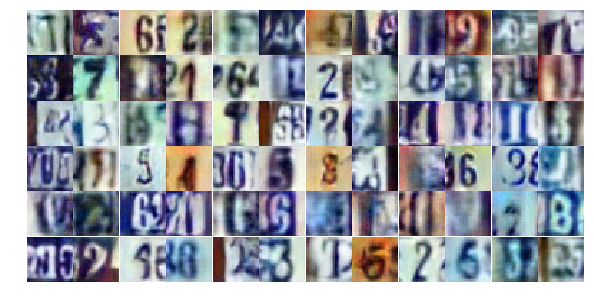

Epoch 16/25... Discriminator Loss: 0.7171... Generator Loss: 0.9926
Epoch 16/25... Discriminator Loss: 0.6073... Generator Loss: 1.2920
Epoch 16/25... Discriminator Loss: 1.0605... Generator Loss: 0.6150
Epoch 16/25... Discriminator Loss: 1.5769... Generator Loss: 0.3182
Epoch 16/25... Discriminator Loss: 1.0555... Generator Loss: 0.5882
Epoch 16/25... Discriminator Loss: 0.9077... Generator Loss: 0.7905
Epoch 16/25... Discriminator Loss: 0.7145... Generator Loss: 0.9134
Epoch 16/25... Discriminator Loss: 0.3546... Generator Loss: 1.8371
Epoch 16/25... Discriminator Loss: 0.7530... Generator Loss: 1.9363
Epoch 16/25... Discriminator Loss: 0.6230... Generator Loss: 1.1419


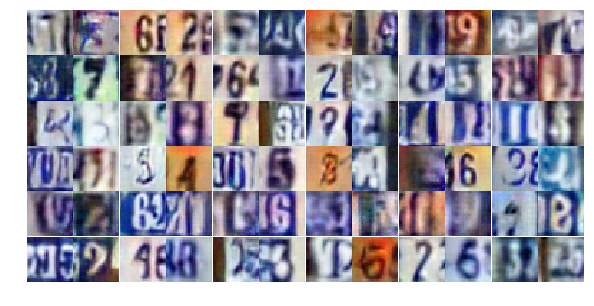

Epoch 16/25... Discriminator Loss: 0.5312... Generator Loss: 1.2098
Epoch 16/25... Discriminator Loss: 0.4020... Generator Loss: 1.6295
Epoch 16/25... Discriminator Loss: 0.5609... Generator Loss: 2.1794
Epoch 16/25... Discriminator Loss: 0.8753... Generator Loss: 0.8731
Epoch 16/25... Discriminator Loss: 1.0031... Generator Loss: 1.9493
Epoch 16/25... Discriminator Loss: 0.5514... Generator Loss: 1.2947
Epoch 16/25... Discriminator Loss: 0.7955... Generator Loss: 0.8646
Epoch 16/25... Discriminator Loss: 1.1285... Generator Loss: 0.5167
Epoch 16/25... Discriminator Loss: 0.8303... Generator Loss: 0.8213
Epoch 16/25... Discriminator Loss: 0.5638... Generator Loss: 1.1306


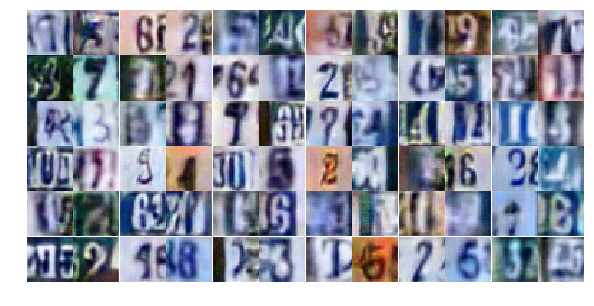

Epoch 16/25... Discriminator Loss: 0.6954... Generator Loss: 1.2445
Epoch 16/25... Discriminator Loss: 0.5873... Generator Loss: 1.2636
Epoch 16/25... Discriminator Loss: 1.2543... Generator Loss: 0.5039
Epoch 16/25... Discriminator Loss: 1.4899... Generator Loss: 0.3969
Epoch 16/25... Discriminator Loss: 0.7768... Generator Loss: 0.8407
Epoch 16/25... Discriminator Loss: 1.1542... Generator Loss: 0.6031
Epoch 16/25... Discriminator Loss: 0.3924... Generator Loss: 1.6260
Epoch 16/25... Discriminator Loss: 1.2769... Generator Loss: 0.4174
Epoch 16/25... Discriminator Loss: 0.6777... Generator Loss: 0.9866
Epoch 16/25... Discriminator Loss: 0.8437... Generator Loss: 0.8241


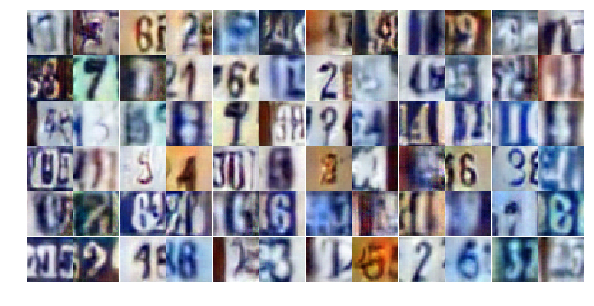

Epoch 16/25... Discriminator Loss: 0.8102... Generator Loss: 1.0387
Epoch 16/25... Discriminator Loss: 0.5193... Generator Loss: 1.5524
Epoch 16/25... Discriminator Loss: 1.7428... Generator Loss: 0.3965
Epoch 16/25... Discriminator Loss: 0.4262... Generator Loss: 2.2736
Epoch 16/25... Discriminator Loss: 0.5974... Generator Loss: 1.1270
Epoch 16/25... Discriminator Loss: 0.7579... Generator Loss: 0.8664
Epoch 17/25... Discriminator Loss: 0.8404... Generator Loss: 1.0322
Epoch 17/25... Discriminator Loss: 0.7244... Generator Loss: 1.0889
Epoch 17/25... Discriminator Loss: 0.5934... Generator Loss: 1.2460
Epoch 17/25... Discriminator Loss: 0.8943... Generator Loss: 0.7997


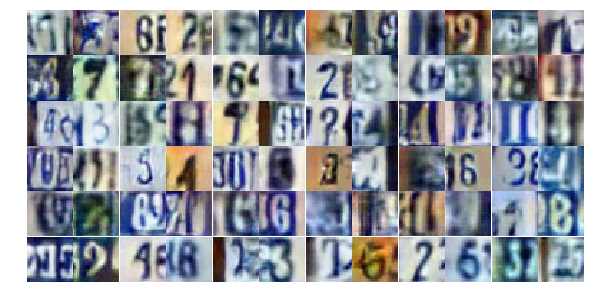

Epoch 17/25... Discriminator Loss: 0.5826... Generator Loss: 1.1014
Epoch 17/25... Discriminator Loss: 0.5133... Generator Loss: 1.3573
Epoch 17/25... Discriminator Loss: 0.7340... Generator Loss: 1.0682
Epoch 17/25... Discriminator Loss: 0.5574... Generator Loss: 1.3950
Epoch 17/25... Discriminator Loss: 1.2814... Generator Loss: 0.4587
Epoch 17/25... Discriminator Loss: 1.1850... Generator Loss: 0.5294
Epoch 17/25... Discriminator Loss: 0.6978... Generator Loss: 1.2258
Epoch 17/25... Discriminator Loss: 0.8262... Generator Loss: 0.8429
Epoch 17/25... Discriminator Loss: 0.3361... Generator Loss: 1.7518
Epoch 17/25... Discriminator Loss: 0.5675... Generator Loss: 1.8811


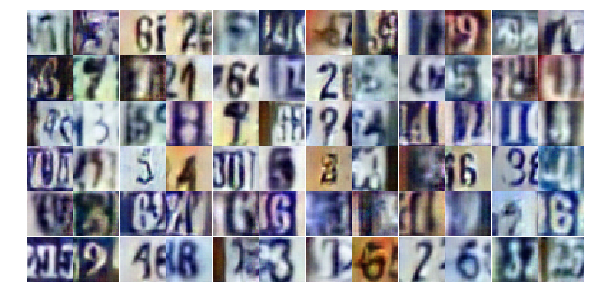

Epoch 17/25... Discriminator Loss: 1.2434... Generator Loss: 2.7985
Epoch 17/25... Discriminator Loss: 0.6913... Generator Loss: 0.9185
Epoch 17/25... Discriminator Loss: 0.5766... Generator Loss: 1.2000
Epoch 17/25... Discriminator Loss: 1.3235... Generator Loss: 2.5931
Epoch 17/25... Discriminator Loss: 0.5290... Generator Loss: 1.7708
Epoch 17/25... Discriminator Loss: 1.0093... Generator Loss: 0.7093
Epoch 17/25... Discriminator Loss: 0.5535... Generator Loss: 2.0253
Epoch 17/25... Discriminator Loss: 0.5079... Generator Loss: 1.2613
Epoch 17/25... Discriminator Loss: 0.7928... Generator Loss: 0.7986
Epoch 17/25... Discriminator Loss: 0.7677... Generator Loss: 0.8544


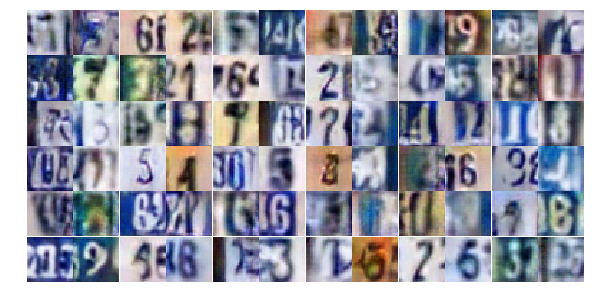

Epoch 17/25... Discriminator Loss: 1.6630... Generator Loss: 0.3335
Epoch 17/25... Discriminator Loss: 0.9018... Generator Loss: 0.7909
Epoch 17/25... Discriminator Loss: 0.5127... Generator Loss: 1.2880
Epoch 17/25... Discriminator Loss: 0.9367... Generator Loss: 0.7436
Epoch 17/25... Discriminator Loss: 0.7615... Generator Loss: 0.9184
Epoch 17/25... Discriminator Loss: 0.5189... Generator Loss: 1.1788
Epoch 17/25... Discriminator Loss: 0.7224... Generator Loss: 1.0390
Epoch 17/25... Discriminator Loss: 1.0595... Generator Loss: 0.6486
Epoch 17/25... Discriminator Loss: 0.8015... Generator Loss: 0.8809
Epoch 17/25... Discriminator Loss: 0.3369... Generator Loss: 1.9167


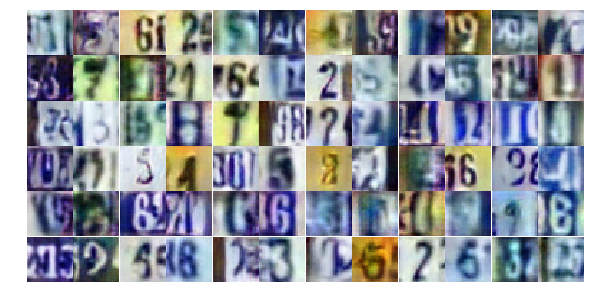

Epoch 17/25... Discriminator Loss: 0.4499... Generator Loss: 1.6611
Epoch 17/25... Discriminator Loss: 1.2505... Generator Loss: 0.4972
Epoch 17/25... Discriminator Loss: 0.5273... Generator Loss: 3.0523
Epoch 17/25... Discriminator Loss: 0.9302... Generator Loss: 0.6791
Epoch 17/25... Discriminator Loss: 1.2429... Generator Loss: 0.4448
Epoch 17/25... Discriminator Loss: 0.5921... Generator Loss: 2.4623
Epoch 17/25... Discriminator Loss: 0.9656... Generator Loss: 0.7452
Epoch 17/25... Discriminator Loss: 0.4393... Generator Loss: 1.4860
Epoch 17/25... Discriminator Loss: 0.2158... Generator Loss: 2.4717
Epoch 17/25... Discriminator Loss: 0.9264... Generator Loss: 0.7076


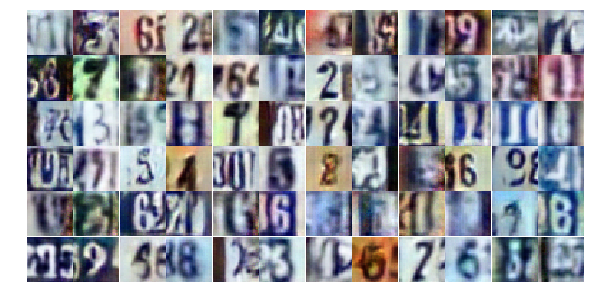

Epoch 17/25... Discriminator Loss: 4.4970... Generator Loss: 0.0937
Epoch 17/25... Discriminator Loss: 0.8974... Generator Loss: 1.1436
Epoch 17/25... Discriminator Loss: 1.3552... Generator Loss: 0.6120
Epoch 17/25... Discriminator Loss: 0.6157... Generator Loss: 1.2334
Epoch 17/25... Discriminator Loss: 0.8194... Generator Loss: 0.8118
Epoch 17/25... Discriminator Loss: 0.7679... Generator Loss: 0.9274
Epoch 17/25... Discriminator Loss: 1.2117... Generator Loss: 0.5606
Epoch 17/25... Discriminator Loss: 0.5464... Generator Loss: 1.4798
Epoch 17/25... Discriminator Loss: 0.6997... Generator Loss: 1.1401
Epoch 17/25... Discriminator Loss: 1.2357... Generator Loss: 0.4957


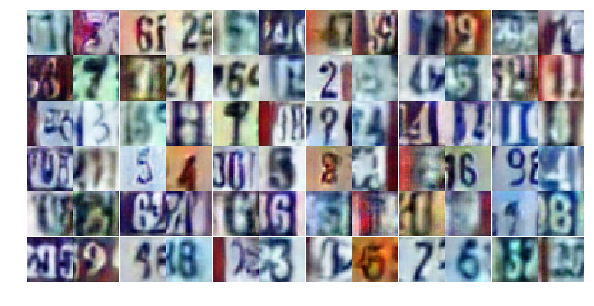

Epoch 17/25... Discriminator Loss: 0.7526... Generator Loss: 1.1193
Epoch 17/25... Discriminator Loss: 0.9378... Generator Loss: 0.7537
Epoch 17/25... Discriminator Loss: 0.6039... Generator Loss: 1.0741
Epoch 17/25... Discriminator Loss: 0.6398... Generator Loss: 1.0666
Epoch 18/25... Discriminator Loss: 1.2445... Generator Loss: 0.5045
Epoch 18/25... Discriminator Loss: 0.8271... Generator Loss: 0.8110
Epoch 18/25... Discriminator Loss: 0.7390... Generator Loss: 0.9094
Epoch 18/25... Discriminator Loss: 0.8273... Generator Loss: 0.7972
Epoch 18/25... Discriminator Loss: 0.9847... Generator Loss: 0.6368
Epoch 18/25... Discriminator Loss: 0.6146... Generator Loss: 1.0652


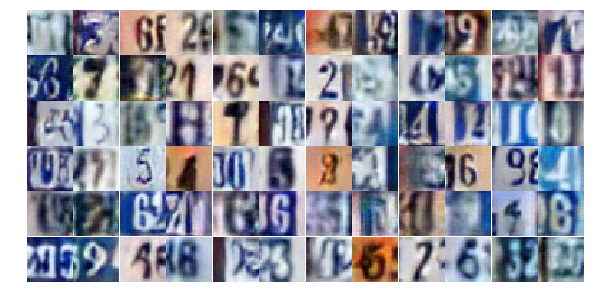

Epoch 18/25... Discriminator Loss: 0.6024... Generator Loss: 2.8748
Epoch 18/25... Discriminator Loss: 0.9002... Generator Loss: 0.7330
Epoch 18/25... Discriminator Loss: 0.8249... Generator Loss: 0.8902
Epoch 18/25... Discriminator Loss: 0.4178... Generator Loss: 1.7348
Epoch 18/25... Discriminator Loss: 0.4839... Generator Loss: 1.3959
Epoch 18/25... Discriminator Loss: 0.9419... Generator Loss: 0.7147
Epoch 18/25... Discriminator Loss: 0.5451... Generator Loss: 1.3280
Epoch 18/25... Discriminator Loss: 0.5188... Generator Loss: 1.3235
Epoch 18/25... Discriminator Loss: 1.1732... Generator Loss: 3.5217
Epoch 18/25... Discriminator Loss: 0.4213... Generator Loss: 1.3922


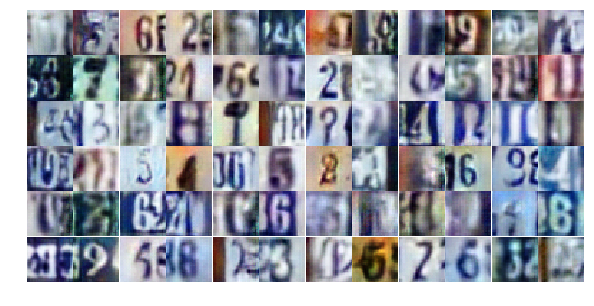

Epoch 18/25... Discriminator Loss: 0.8068... Generator Loss: 0.8483
Epoch 18/25... Discriminator Loss: 0.7825... Generator Loss: 0.8701
Epoch 18/25... Discriminator Loss: 1.0954... Generator Loss: 0.6101
Epoch 18/25... Discriminator Loss: 0.5772... Generator Loss: 1.1600
Epoch 18/25... Discriminator Loss: 1.0584... Generator Loss: 0.6964
Epoch 18/25... Discriminator Loss: 0.8123... Generator Loss: 0.8325
Epoch 18/25... Discriminator Loss: 0.6623... Generator Loss: 1.8993
Epoch 18/25... Discriminator Loss: 0.7243... Generator Loss: 1.0733
Epoch 18/25... Discriminator Loss: 0.9542... Generator Loss: 0.6965
Epoch 18/25... Discriminator Loss: 0.6110... Generator Loss: 1.0521


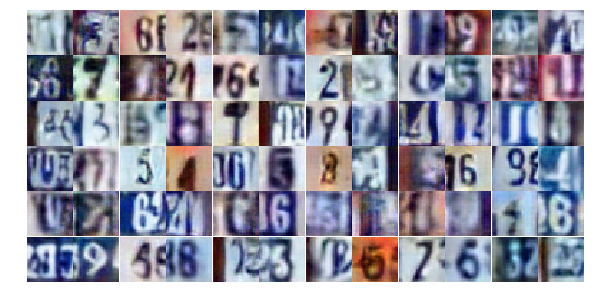

Epoch 18/25... Discriminator Loss: 0.4971... Generator Loss: 1.5089
Epoch 18/25... Discriminator Loss: 0.7962... Generator Loss: 0.9164
Epoch 18/25... Discriminator Loss: 0.8487... Generator Loss: 0.8062
Epoch 18/25... Discriminator Loss: 0.6457... Generator Loss: 1.0968
Epoch 18/25... Discriminator Loss: 1.1637... Generator Loss: 0.5279
Epoch 18/25... Discriminator Loss: 0.5861... Generator Loss: 1.1625
Epoch 18/25... Discriminator Loss: 0.6090... Generator Loss: 1.1252
Epoch 18/25... Discriminator Loss: 0.4214... Generator Loss: 1.5950
Epoch 18/25... Discriminator Loss: 0.6942... Generator Loss: 1.0184
Epoch 18/25... Discriminator Loss: 0.8223... Generator Loss: 1.1087


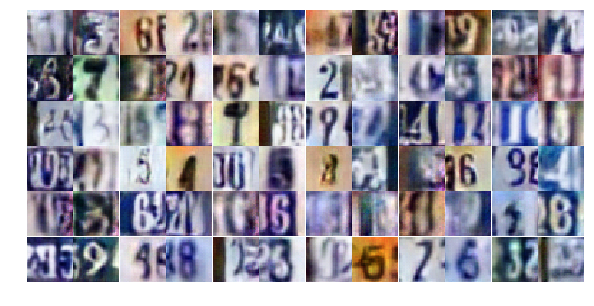

Epoch 18/25... Discriminator Loss: 0.4953... Generator Loss: 1.5146
Epoch 18/25... Discriminator Loss: 0.6235... Generator Loss: 1.1126
Epoch 18/25... Discriminator Loss: 0.5383... Generator Loss: 1.2630
Epoch 18/25... Discriminator Loss: 0.7516... Generator Loss: 0.8343
Epoch 18/25... Discriminator Loss: 0.9269... Generator Loss: 0.6916
Epoch 18/25... Discriminator Loss: 0.9237... Generator Loss: 0.6716
Epoch 18/25... Discriminator Loss: 0.7797... Generator Loss: 0.8222
Epoch 18/25... Discriminator Loss: 2.9208... Generator Loss: 4.3958
Epoch 18/25... Discriminator Loss: 2.7699... Generator Loss: 0.1365
Epoch 18/25... Discriminator Loss: 0.3606... Generator Loss: 1.9845


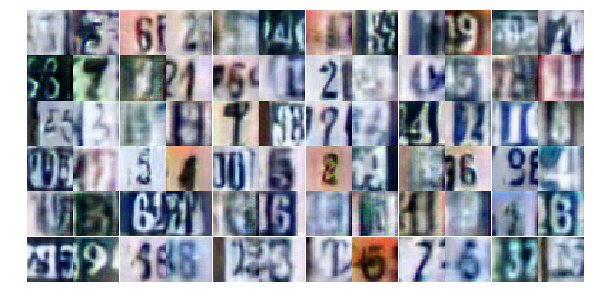

Epoch 18/25... Discriminator Loss: 0.6124... Generator Loss: 1.4545
Epoch 18/25... Discriminator Loss: 1.1238... Generator Loss: 0.5807
Epoch 18/25... Discriminator Loss: 0.7082... Generator Loss: 1.0777
Epoch 18/25... Discriminator Loss: 0.9231... Generator Loss: 0.7399
Epoch 18/25... Discriminator Loss: 0.6823... Generator Loss: 0.9387
Epoch 18/25... Discriminator Loss: 0.7320... Generator Loss: 0.8739
Epoch 18/25... Discriminator Loss: 0.4749... Generator Loss: 1.3775
Epoch 18/25... Discriminator Loss: 0.3675... Generator Loss: 1.8528
Epoch 18/25... Discriminator Loss: 0.6932... Generator Loss: 1.1117
Epoch 18/25... Discriminator Loss: 1.1439... Generator Loss: 0.5541


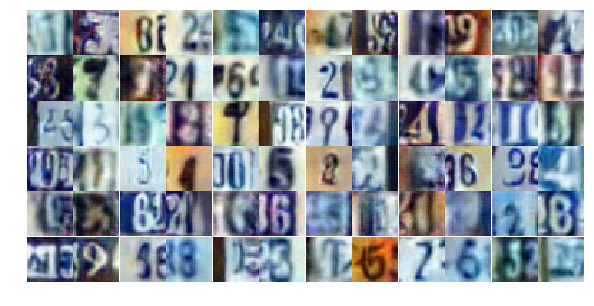

Epoch 18/25... Discriminator Loss: 0.8859... Generator Loss: 0.8950
Epoch 19/25... Discriminator Loss: 1.0337... Generator Loss: 0.6227
Epoch 19/25... Discriminator Loss: 1.2596... Generator Loss: 0.4563
Epoch 19/25... Discriminator Loss: 0.8376... Generator Loss: 0.8805
Epoch 19/25... Discriminator Loss: 0.6633... Generator Loss: 1.1066
Epoch 19/25... Discriminator Loss: 0.8327... Generator Loss: 0.8460
Epoch 19/25... Discriminator Loss: 0.4548... Generator Loss: 1.5149
Epoch 19/25... Discriminator Loss: 0.8461... Generator Loss: 0.8566
Epoch 19/25... Discriminator Loss: 0.7514... Generator Loss: 2.9505
Epoch 19/25... Discriminator Loss: 0.6980... Generator Loss: 1.1885


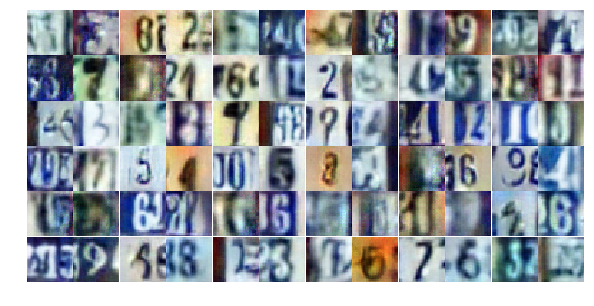

Epoch 19/25... Discriminator Loss: 0.5505... Generator Loss: 1.1228
Epoch 19/25... Discriminator Loss: 0.7355... Generator Loss: 0.9549
Epoch 19/25... Discriminator Loss: 0.7392... Generator Loss: 1.0258
Epoch 19/25... Discriminator Loss: 0.8702... Generator Loss: 0.7695
Epoch 19/25... Discriminator Loss: 1.0734... Generator Loss: 0.5624
Epoch 19/25... Discriminator Loss: 0.6332... Generator Loss: 1.1570
Epoch 19/25... Discriminator Loss: 0.8226... Generator Loss: 1.6551
Epoch 19/25... Discriminator Loss: 0.8215... Generator Loss: 0.8234
Epoch 19/25... Discriminator Loss: 0.7358... Generator Loss: 1.2041
Epoch 19/25... Discriminator Loss: 0.9287... Generator Loss: 0.6923


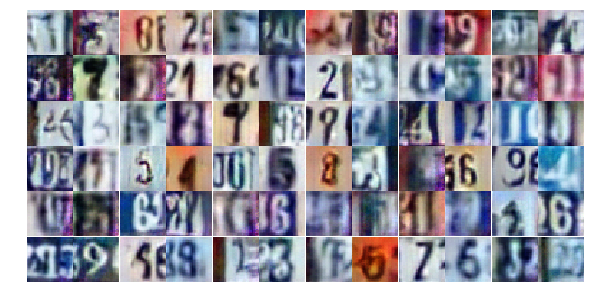

Epoch 19/25... Discriminator Loss: 0.9399... Generator Loss: 0.6850
Epoch 19/25... Discriminator Loss: 1.1082... Generator Loss: 0.6415
Epoch 19/25... Discriminator Loss: 1.2453... Generator Loss: 0.6633
Epoch 19/25... Discriminator Loss: 1.0358... Generator Loss: 0.6087
Epoch 19/25... Discriminator Loss: 1.1719... Generator Loss: 0.5181
Epoch 19/25... Discriminator Loss: 0.9296... Generator Loss: 0.7297
Epoch 19/25... Discriminator Loss: 0.6110... Generator Loss: 1.1757
Epoch 19/25... Discriminator Loss: 0.5820... Generator Loss: 1.0841
Epoch 19/25... Discriminator Loss: 0.6246... Generator Loss: 1.0049
Epoch 19/25... Discriminator Loss: 1.5344... Generator Loss: 0.3908


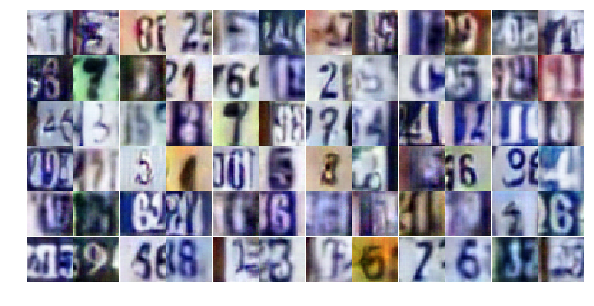

Epoch 19/25... Discriminator Loss: 0.7683... Generator Loss: 1.0850
Epoch 19/25... Discriminator Loss: 0.6249... Generator Loss: 1.0825
Epoch 19/25... Discriminator Loss: 1.6085... Generator Loss: 0.3273
Epoch 19/25... Discriminator Loss: 0.9463... Generator Loss: 0.6675
Epoch 19/25... Discriminator Loss: 0.5073... Generator Loss: 1.4532
Epoch 19/25... Discriminator Loss: 1.0021... Generator Loss: 0.6184
Epoch 19/25... Discriminator Loss: 0.8033... Generator Loss: 0.8370
Epoch 19/25... Discriminator Loss: 0.4717... Generator Loss: 1.5881
Epoch 19/25... Discriminator Loss: 0.7510... Generator Loss: 1.0292
Epoch 19/25... Discriminator Loss: 0.7143... Generator Loss: 0.9184


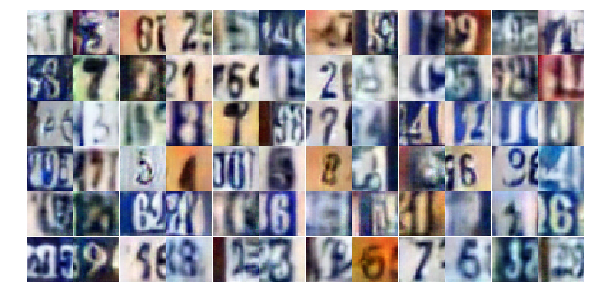

Epoch 19/25... Discriminator Loss: 0.5786... Generator Loss: 1.0779
Epoch 19/25... Discriminator Loss: 1.1434... Generator Loss: 0.5631
Epoch 19/25... Discriminator Loss: 1.1577... Generator Loss: 0.5657
Epoch 19/25... Discriminator Loss: 0.6554... Generator Loss: 1.0583
Epoch 19/25... Discriminator Loss: 0.8389... Generator Loss: 0.8549
Epoch 19/25... Discriminator Loss: 0.6389... Generator Loss: 1.1431
Epoch 19/25... Discriminator Loss: 0.5771... Generator Loss: 1.4525
Epoch 19/25... Discriminator Loss: 0.4011... Generator Loss: 1.5649
Epoch 19/25... Discriminator Loss: 0.9015... Generator Loss: 0.7876
Epoch 19/25... Discriminator Loss: 0.8877... Generator Loss: 0.8224


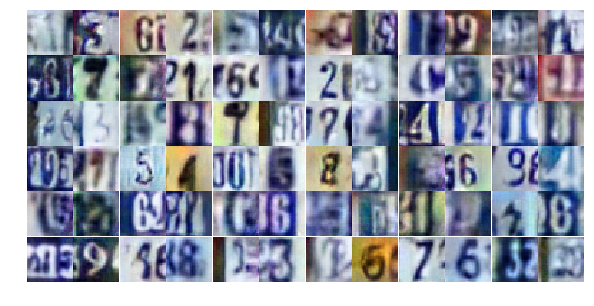

Epoch 19/25... Discriminator Loss: 0.9107... Generator Loss: 0.6803
Epoch 19/25... Discriminator Loss: 0.8025... Generator Loss: 0.9037
Epoch 19/25... Discriminator Loss: 0.5291... Generator Loss: 1.5728
Epoch 19/25... Discriminator Loss: 0.6658... Generator Loss: 1.0814
Epoch 19/25... Discriminator Loss: 1.7970... Generator Loss: 0.2708
Epoch 19/25... Discriminator Loss: 0.8088... Generator Loss: 0.8799
Epoch 19/25... Discriminator Loss: 1.9726... Generator Loss: 0.2693
Epoch 19/25... Discriminator Loss: 0.7360... Generator Loss: 0.9476
Epoch 20/25... Discriminator Loss: 0.6598... Generator Loss: 1.0968
Epoch 20/25... Discriminator Loss: 0.7163... Generator Loss: 0.9995


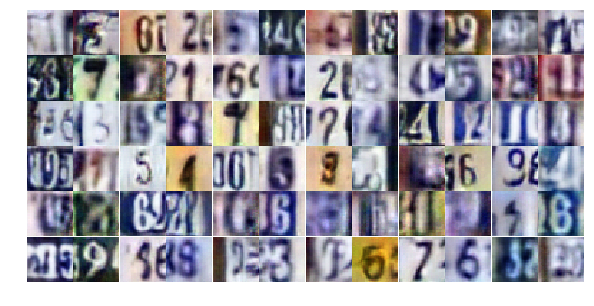

Epoch 20/25... Discriminator Loss: 0.7485... Generator Loss: 1.0599
Epoch 20/25... Discriminator Loss: 0.8488... Generator Loss: 0.7347
Epoch 20/25... Discriminator Loss: 1.8165... Generator Loss: 0.3360
Epoch 20/25... Discriminator Loss: 0.9497... Generator Loss: 0.7258
Epoch 20/25... Discriminator Loss: 0.6036... Generator Loss: 1.1075
Epoch 20/25... Discriminator Loss: 0.5703... Generator Loss: 1.1307
Epoch 20/25... Discriminator Loss: 0.6975... Generator Loss: 0.8785
Epoch 20/25... Discriminator Loss: 0.8921... Generator Loss: 0.7409
Epoch 20/25... Discriminator Loss: 0.8368... Generator Loss: 1.0055
Epoch 20/25... Discriminator Loss: 1.1389... Generator Loss: 0.5582


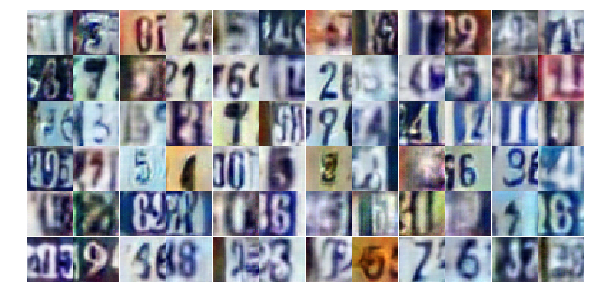

Epoch 20/25... Discriminator Loss: 0.8748... Generator Loss: 0.8134
Epoch 20/25... Discriminator Loss: 0.9156... Generator Loss: 0.8566
Epoch 20/25... Discriminator Loss: 0.5140... Generator Loss: 1.5259
Epoch 20/25... Discriminator Loss: 0.7232... Generator Loss: 1.1325
Epoch 20/25... Discriminator Loss: 1.2814... Generator Loss: 0.4722
Epoch 20/25... Discriminator Loss: 1.0188... Generator Loss: 0.6107
Epoch 20/25... Discriminator Loss: 1.0349... Generator Loss: 0.6246
Epoch 20/25... Discriminator Loss: 0.6172... Generator Loss: 1.2040
Epoch 20/25... Discriminator Loss: 0.5607... Generator Loss: 1.1671
Epoch 20/25... Discriminator Loss: 1.2440... Generator Loss: 0.4443


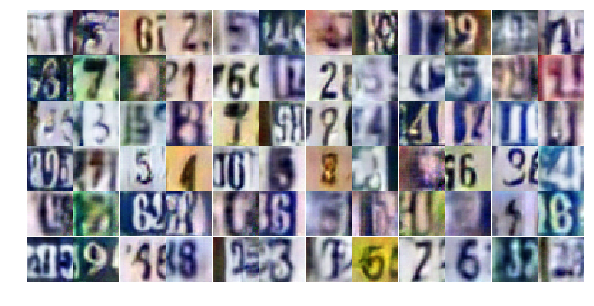

Epoch 20/25... Discriminator Loss: 0.7390... Generator Loss: 0.9963
Epoch 20/25... Discriminator Loss: 0.5721... Generator Loss: 1.2937
Epoch 20/25... Discriminator Loss: 0.3033... Generator Loss: 1.9645
Epoch 20/25... Discriminator Loss: 1.0034... Generator Loss: 0.6931
Epoch 20/25... Discriminator Loss: 0.5853... Generator Loss: 1.3307
Epoch 20/25... Discriminator Loss: 0.6670... Generator Loss: 0.9893
Epoch 20/25... Discriminator Loss: 0.4184... Generator Loss: 2.0913
Epoch 20/25... Discriminator Loss: 1.7272... Generator Loss: 0.3829
Epoch 20/25... Discriminator Loss: 1.0321... Generator Loss: 0.6808
Epoch 20/25... Discriminator Loss: 0.5413... Generator Loss: 1.1452


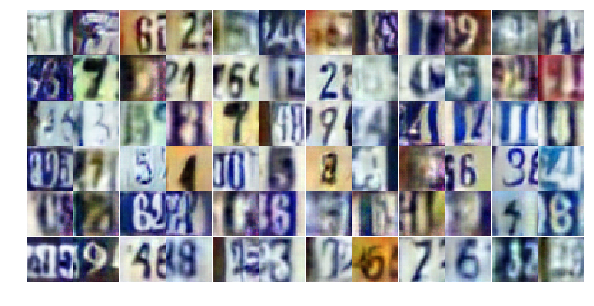

Epoch 20/25... Discriminator Loss: 0.8861... Generator Loss: 0.7330
Epoch 20/25... Discriminator Loss: 1.0414... Generator Loss: 0.6515
Epoch 20/25... Discriminator Loss: 1.0171... Generator Loss: 0.6383
Epoch 20/25... Discriminator Loss: 1.0548... Generator Loss: 0.7821
Epoch 20/25... Discriminator Loss: 0.5369... Generator Loss: 1.3469
Epoch 20/25... Discriminator Loss: 0.6482... Generator Loss: 2.8858
Epoch 20/25... Discriminator Loss: 0.8009... Generator Loss: 0.9468
Epoch 20/25... Discriminator Loss: 0.6884... Generator Loss: 1.4495
Epoch 20/25... Discriminator Loss: 1.0954... Generator Loss: 0.5686
Epoch 20/25... Discriminator Loss: 0.8579... Generator Loss: 0.8077


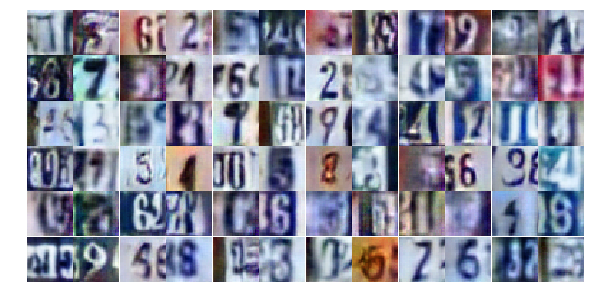

Epoch 20/25... Discriminator Loss: 1.1339... Generator Loss: 0.7362
Epoch 20/25... Discriminator Loss: 1.1861... Generator Loss: 0.5501
Epoch 20/25... Discriminator Loss: 2.1728... Generator Loss: 0.2470
Epoch 20/25... Discriminator Loss: 1.4863... Generator Loss: 0.4361
Epoch 20/25... Discriminator Loss: 3.0328... Generator Loss: 4.8959
Epoch 20/25... Discriminator Loss: 1.7048... Generator Loss: 0.3474
Epoch 20/25... Discriminator Loss: 1.0449... Generator Loss: 0.6370
Epoch 20/25... Discriminator Loss: 0.5368... Generator Loss: 1.7245
Epoch 20/25... Discriminator Loss: 0.6662... Generator Loss: 1.0964
Epoch 20/25... Discriminator Loss: 0.6011... Generator Loss: 1.1850


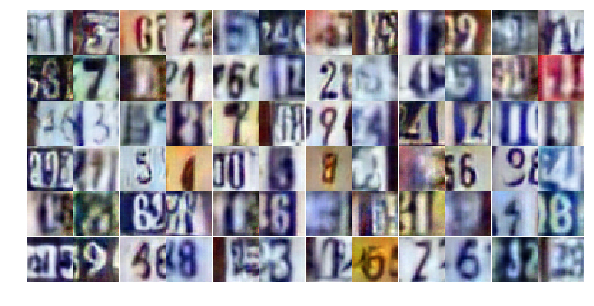

Epoch 20/25... Discriminator Loss: 0.5445... Generator Loss: 1.4353
Epoch 20/25... Discriminator Loss: 0.6325... Generator Loss: 1.4731
Epoch 20/25... Discriminator Loss: 0.5571... Generator Loss: 1.4080
Epoch 20/25... Discriminator Loss: 0.7644... Generator Loss: 1.5079
Epoch 20/25... Discriminator Loss: 0.7503... Generator Loss: 0.8891
Epoch 20/25... Discriminator Loss: 0.5814... Generator Loss: 1.1204
Epoch 21/25... Discriminator Loss: 0.8924... Generator Loss: 0.8175
Epoch 21/25... Discriminator Loss: 0.7885... Generator Loss: 0.8302
Epoch 21/25... Discriminator Loss: 1.4896... Generator Loss: 0.3590
Epoch 21/25... Discriminator Loss: 1.0824... Generator Loss: 0.6199


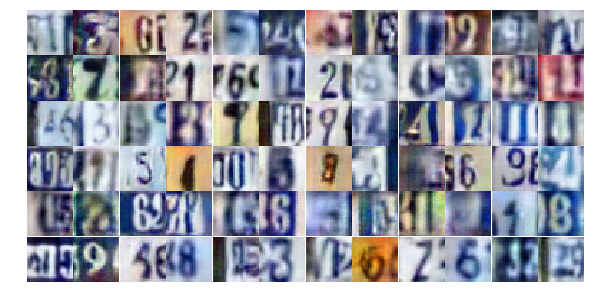

Epoch 21/25... Discriminator Loss: 0.6362... Generator Loss: 1.2714
Epoch 21/25... Discriminator Loss: 1.4626... Generator Loss: 0.3511
Epoch 21/25... Discriminator Loss: 0.3601... Generator Loss: 1.9494
Epoch 21/25... Discriminator Loss: 0.5274... Generator Loss: 1.2438
Epoch 21/25... Discriminator Loss: 0.6796... Generator Loss: 1.0980
Epoch 21/25... Discriminator Loss: 0.3702... Generator Loss: 1.6542
Epoch 21/25... Discriminator Loss: 0.7125... Generator Loss: 1.0375
Epoch 21/25... Discriminator Loss: 0.9243... Generator Loss: 0.7134
Epoch 21/25... Discriminator Loss: 0.8537... Generator Loss: 0.8253
Epoch 21/25... Discriminator Loss: 1.1973... Generator Loss: 0.5744


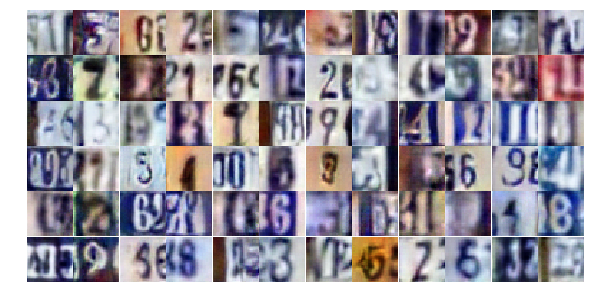

Epoch 21/25... Discriminator Loss: 0.4377... Generator Loss: 1.3981
Epoch 21/25... Discriminator Loss: 0.7456... Generator Loss: 0.9225
Epoch 21/25... Discriminator Loss: 1.6277... Generator Loss: 0.3968
Epoch 21/25... Discriminator Loss: 0.6427... Generator Loss: 1.0132
Epoch 21/25... Discriminator Loss: 0.4586... Generator Loss: 1.3926
Epoch 21/25... Discriminator Loss: 1.1431... Generator Loss: 0.5921
Epoch 21/25... Discriminator Loss: 0.7608... Generator Loss: 0.8772
Epoch 21/25... Discriminator Loss: 0.3641... Generator Loss: 1.6267
Epoch 21/25... Discriminator Loss: 0.5066... Generator Loss: 1.3882
Epoch 21/25... Discriminator Loss: 0.8916... Generator Loss: 0.7781


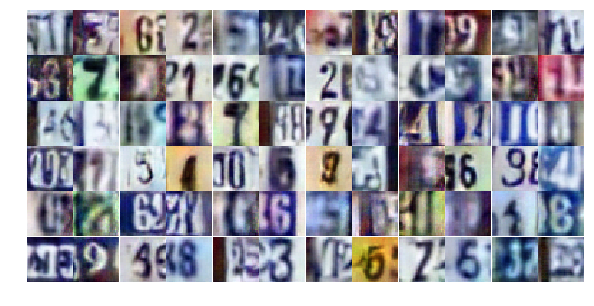

Epoch 21/25... Discriminator Loss: 0.9483... Generator Loss: 0.6996
Epoch 21/25... Discriminator Loss: 0.4062... Generator Loss: 1.5105
Epoch 21/25... Discriminator Loss: 0.7283... Generator Loss: 0.9561
Epoch 21/25... Discriminator Loss: 1.0387... Generator Loss: 0.6693
Epoch 21/25... Discriminator Loss: 1.1950... Generator Loss: 0.5003
Epoch 21/25... Discriminator Loss: 0.9186... Generator Loss: 0.7739
Epoch 21/25... Discriminator Loss: 0.5211... Generator Loss: 1.1854
Epoch 21/25... Discriminator Loss: 0.9783... Generator Loss: 0.8338
Epoch 21/25... Discriminator Loss: 1.2273... Generator Loss: 0.4763
Epoch 21/25... Discriminator Loss: 1.6135... Generator Loss: 0.4904


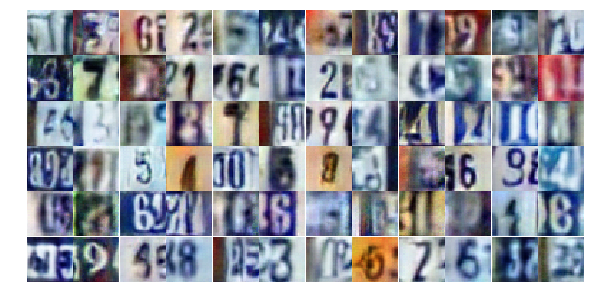

Epoch 21/25... Discriminator Loss: 1.0796... Generator Loss: 0.6904
Epoch 21/25... Discriminator Loss: 0.5506... Generator Loss: 1.1854
Epoch 21/25... Discriminator Loss: 1.3342... Generator Loss: 0.4648
Epoch 21/25... Discriminator Loss: 0.6130... Generator Loss: 1.1492
Epoch 21/25... Discriminator Loss: 0.5445... Generator Loss: 1.1739
Epoch 21/25... Discriminator Loss: 0.7718... Generator Loss: 0.9316
Epoch 21/25... Discriminator Loss: 0.8003... Generator Loss: 0.8498
Epoch 21/25... Discriminator Loss: 1.7864... Generator Loss: 0.2577
Epoch 21/25... Discriminator Loss: 0.7947... Generator Loss: 1.0427
Epoch 21/25... Discriminator Loss: 0.3033... Generator Loss: 2.5060


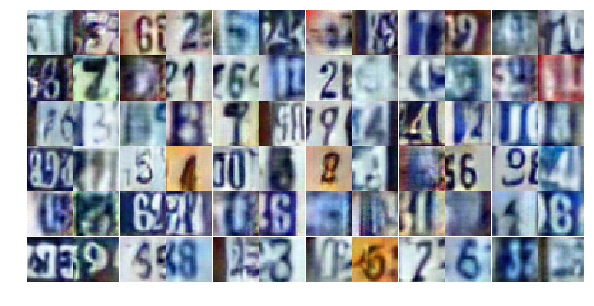

Epoch 21/25... Discriminator Loss: 0.8689... Generator Loss: 0.8288
Epoch 21/25... Discriminator Loss: 0.8126... Generator Loss: 0.8281
Epoch 21/25... Discriminator Loss: 0.5020... Generator Loss: 1.2644
Epoch 21/25... Discriminator Loss: 0.7093... Generator Loss: 1.0028
Epoch 21/25... Discriminator Loss: 0.2795... Generator Loss: 2.2441
Epoch 21/25... Discriminator Loss: 0.7205... Generator Loss: 1.0583
Epoch 21/25... Discriminator Loss: 1.4705... Generator Loss: 0.4264
Epoch 21/25... Discriminator Loss: 2.1102... Generator Loss: 0.2136
Epoch 21/25... Discriminator Loss: 1.5533... Generator Loss: 0.4748
Epoch 21/25... Discriminator Loss: 0.7962... Generator Loss: 0.9240


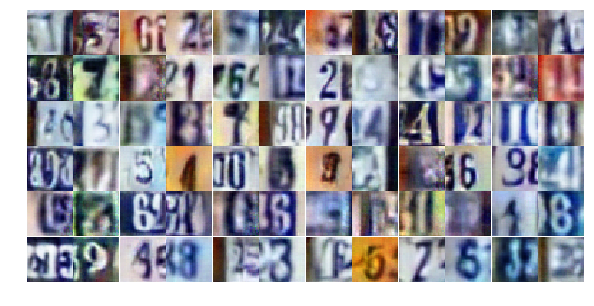

Epoch 21/25... Discriminator Loss: 0.8500... Generator Loss: 0.9578
Epoch 21/25... Discriminator Loss: 0.8563... Generator Loss: 0.8309
Epoch 21/25... Discriminator Loss: 0.6434... Generator Loss: 1.3239
Epoch 22/25... Discriminator Loss: 0.6628... Generator Loss: 1.3653
Epoch 22/25... Discriminator Loss: 1.2165... Generator Loss: 0.5165
Epoch 22/25... Discriminator Loss: 0.8170... Generator Loss: 0.8659
Epoch 22/25... Discriminator Loss: 0.5024... Generator Loss: 1.3144
Epoch 22/25... Discriminator Loss: 0.8268... Generator Loss: 0.8063
Epoch 22/25... Discriminator Loss: 0.9677... Generator Loss: 0.6863
Epoch 22/25... Discriminator Loss: 0.7609... Generator Loss: 0.8881


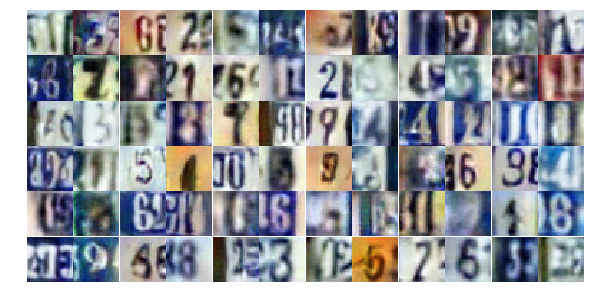

Epoch 22/25... Discriminator Loss: 0.6267... Generator Loss: 1.6112
Epoch 22/25... Discriminator Loss: 0.7163... Generator Loss: 1.3526
Epoch 22/25... Discriminator Loss: 1.2883... Generator Loss: 0.5099
Epoch 22/25... Discriminator Loss: 1.1416... Generator Loss: 0.5365
Epoch 22/25... Discriminator Loss: 0.5500... Generator Loss: 1.6748
Epoch 22/25... Discriminator Loss: 0.7882... Generator Loss: 0.9813
Epoch 22/25... Discriminator Loss: 0.8197... Generator Loss: 0.9071
Epoch 22/25... Discriminator Loss: 0.4050... Generator Loss: 1.8407
Epoch 22/25... Discriminator Loss: 0.9869... Generator Loss: 0.7152
Epoch 22/25... Discriminator Loss: 1.5639... Generator Loss: 0.3422


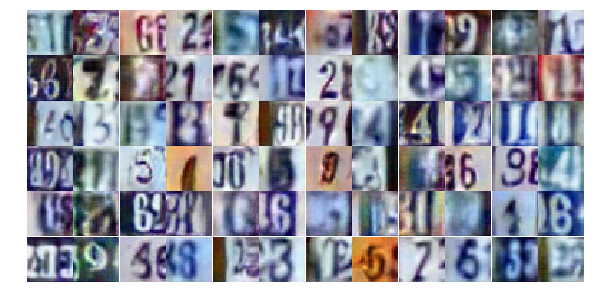

Epoch 22/25... Discriminator Loss: 0.9247... Generator Loss: 2.3612
Epoch 22/25... Discriminator Loss: 0.5437... Generator Loss: 2.9928
Epoch 22/25... Discriminator Loss: 0.9521... Generator Loss: 2.1143
Epoch 22/25... Discriminator Loss: 0.4056... Generator Loss: 1.5070
Epoch 22/25... Discriminator Loss: 0.5966... Generator Loss: 1.2899
Epoch 22/25... Discriminator Loss: 1.2924... Generator Loss: 0.4587
Epoch 22/25... Discriminator Loss: 0.5099... Generator Loss: 1.3187
Epoch 22/25... Discriminator Loss: 0.4820... Generator Loss: 1.3138
Epoch 22/25... Discriminator Loss: 0.6333... Generator Loss: 1.1549
Epoch 22/25... Discriminator Loss: 0.6465... Generator Loss: 1.0878


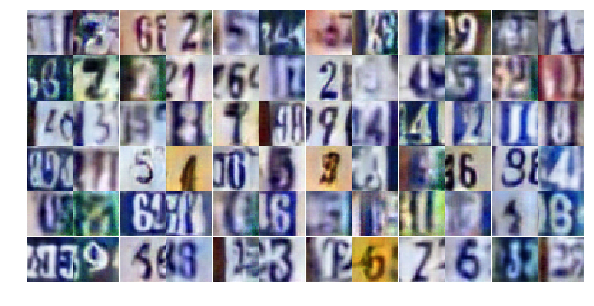

Epoch 22/25... Discriminator Loss: 0.3821... Generator Loss: 1.5612
Epoch 22/25... Discriminator Loss: 0.8133... Generator Loss: 0.8240
Epoch 22/25... Discriminator Loss: 0.8811... Generator Loss: 0.7804
Epoch 22/25... Discriminator Loss: 0.5918... Generator Loss: 1.1699
Epoch 22/25... Discriminator Loss: 0.5764... Generator Loss: 1.5796
Epoch 22/25... Discriminator Loss: 1.1822... Generator Loss: 0.5922
Epoch 22/25... Discriminator Loss: 1.1587... Generator Loss: 0.5551
Epoch 22/25... Discriminator Loss: 0.7118... Generator Loss: 1.0758
Epoch 22/25... Discriminator Loss: 1.0211... Generator Loss: 0.7000
Epoch 22/25... Discriminator Loss: 1.1901... Generator Loss: 0.5118


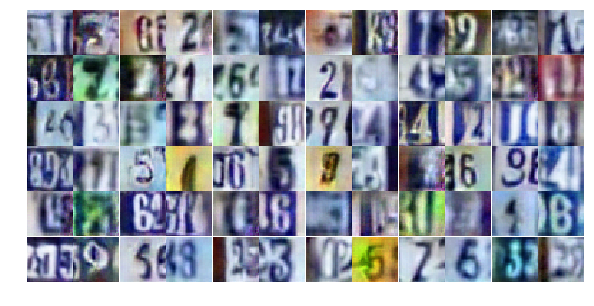

Epoch 22/25... Discriminator Loss: 0.9383... Generator Loss: 0.7877
Epoch 22/25... Discriminator Loss: 0.5924... Generator Loss: 1.2450
Epoch 22/25... Discriminator Loss: 0.3571... Generator Loss: 1.7404
Epoch 22/25... Discriminator Loss: 0.5620... Generator Loss: 1.3337
Epoch 22/25... Discriminator Loss: 0.3849... Generator Loss: 1.6058
Epoch 22/25... Discriminator Loss: 0.5904... Generator Loss: 1.0660
Epoch 22/25... Discriminator Loss: 0.5793... Generator Loss: 1.3466
Epoch 22/25... Discriminator Loss: 0.9262... Generator Loss: 0.8724
Epoch 22/25... Discriminator Loss: 1.6307... Generator Loss: 0.2956
Epoch 22/25... Discriminator Loss: 0.7563... Generator Loss: 0.9741


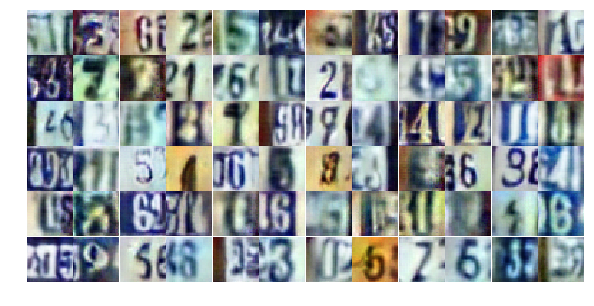

Epoch 22/25... Discriminator Loss: 1.0954... Generator Loss: 0.6705
Epoch 22/25... Discriminator Loss: 0.4837... Generator Loss: 1.4049
Epoch 22/25... Discriminator Loss: 0.8293... Generator Loss: 0.7768
Epoch 22/25... Discriminator Loss: 0.7876... Generator Loss: 0.8711
Epoch 22/25... Discriminator Loss: 1.2851... Generator Loss: 0.5065
Epoch 22/25... Discriminator Loss: 0.6841... Generator Loss: 1.3208
Epoch 22/25... Discriminator Loss: 0.7951... Generator Loss: 1.1099
Epoch 22/25... Discriminator Loss: 0.5750... Generator Loss: 1.1478
Epoch 22/25... Discriminator Loss: 1.2461... Generator Loss: 3.4454
Epoch 22/25... Discriminator Loss: 1.2585... Generator Loss: 0.4619


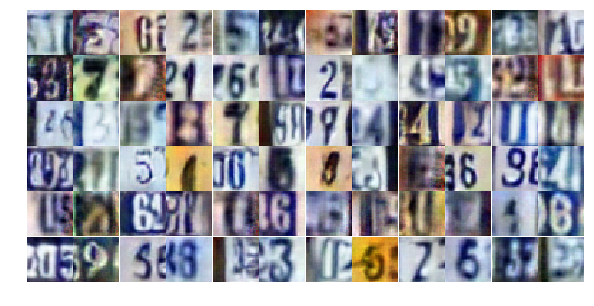

Epoch 23/25... Discriminator Loss: 0.4689... Generator Loss: 1.4376
Epoch 23/25... Discriminator Loss: 0.3525... Generator Loss: 1.5652
Epoch 23/25... Discriminator Loss: 0.9318... Generator Loss: 0.6893
Epoch 23/25... Discriminator Loss: 0.7851... Generator Loss: 0.8500
Epoch 23/25... Discriminator Loss: 0.6678... Generator Loss: 1.7064
Epoch 23/25... Discriminator Loss: 0.7893... Generator Loss: 1.1635
Epoch 23/25... Discriminator Loss: 0.9396... Generator Loss: 0.7446
Epoch 23/25... Discriminator Loss: 0.6967... Generator Loss: 1.0911
Epoch 23/25... Discriminator Loss: 0.5670... Generator Loss: 1.4160
Epoch 23/25... Discriminator Loss: 0.3787... Generator Loss: 1.7523


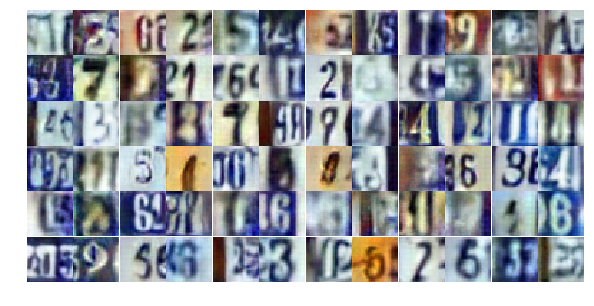

Epoch 23/25... Discriminator Loss: 0.4929... Generator Loss: 1.4785
Epoch 23/25... Discriminator Loss: 0.7977... Generator Loss: 0.8788
Epoch 23/25... Discriminator Loss: 0.6180... Generator Loss: 1.1984
Epoch 23/25... Discriminator Loss: 0.5590... Generator Loss: 1.7395
Epoch 23/25... Discriminator Loss: 0.7129... Generator Loss: 0.9209
Epoch 23/25... Discriminator Loss: 0.8212... Generator Loss: 1.0271
Epoch 23/25... Discriminator Loss: 1.3705... Generator Loss: 0.4379
Epoch 23/25... Discriminator Loss: 1.6582... Generator Loss: 0.3671
Epoch 23/25... Discriminator Loss: 1.2621... Generator Loss: 0.4735
Epoch 23/25... Discriminator Loss: 0.8849... Generator Loss: 0.7604


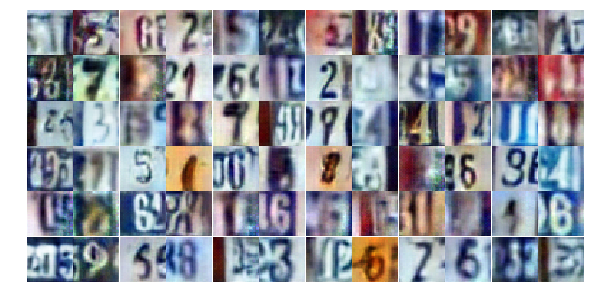

Epoch 23/25... Discriminator Loss: 1.4576... Generator Loss: 0.3880
Epoch 23/25... Discriminator Loss: 0.6505... Generator Loss: 1.1332
Epoch 23/25... Discriminator Loss: 0.7332... Generator Loss: 0.9410
Epoch 23/25... Discriminator Loss: 0.9265... Generator Loss: 0.7755
Epoch 23/25... Discriminator Loss: 0.4990... Generator Loss: 1.5236
Epoch 23/25... Discriminator Loss: 0.9147... Generator Loss: 0.7830
Epoch 23/25... Discriminator Loss: 0.5784... Generator Loss: 1.2752
Epoch 23/25... Discriminator Loss: 1.3126... Generator Loss: 0.4553
Epoch 23/25... Discriminator Loss: 0.5560... Generator Loss: 1.2460
Epoch 23/25... Discriminator Loss: 1.2002... Generator Loss: 0.5440


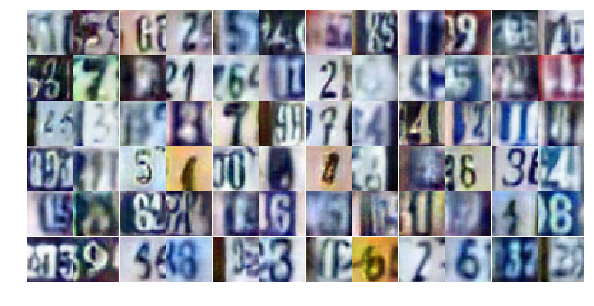

Epoch 23/25... Discriminator Loss: 0.3911... Generator Loss: 1.8922
Epoch 23/25... Discriminator Loss: 0.5915... Generator Loss: 1.2056
Epoch 23/25... Discriminator Loss: 0.8246... Generator Loss: 0.8706
Epoch 23/25... Discriminator Loss: 0.9629... Generator Loss: 0.6554
Epoch 23/25... Discriminator Loss: 0.7613... Generator Loss: 1.2834
Epoch 23/25... Discriminator Loss: 0.7910... Generator Loss: 1.0303
Epoch 23/25... Discriminator Loss: 1.4506... Generator Loss: 0.3919
Epoch 23/25... Discriminator Loss: 0.6796... Generator Loss: 0.9335
Epoch 23/25... Discriminator Loss: 0.4216... Generator Loss: 1.5187
Epoch 23/25... Discriminator Loss: 0.4469... Generator Loss: 1.5553


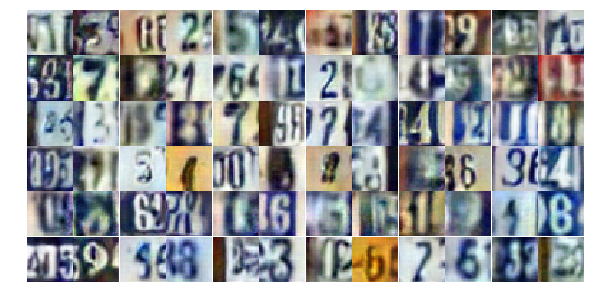

Epoch 23/25... Discriminator Loss: 0.8426... Generator Loss: 0.8772
Epoch 23/25... Discriminator Loss: 0.6424... Generator Loss: 1.0966
Epoch 23/25... Discriminator Loss: 0.9222... Generator Loss: 0.7222
Epoch 23/25... Discriminator Loss: 0.8661... Generator Loss: 0.8677
Epoch 23/25... Discriminator Loss: 0.9128... Generator Loss: 2.7070
Epoch 23/25... Discriminator Loss: 1.0599... Generator Loss: 0.6839
Epoch 23/25... Discriminator Loss: 0.6879... Generator Loss: 1.0031
Epoch 23/25... Discriminator Loss: 1.2088... Generator Loss: 0.5343
Epoch 23/25... Discriminator Loss: 0.6691... Generator Loss: 1.1789
Epoch 23/25... Discriminator Loss: 0.6452... Generator Loss: 1.0926


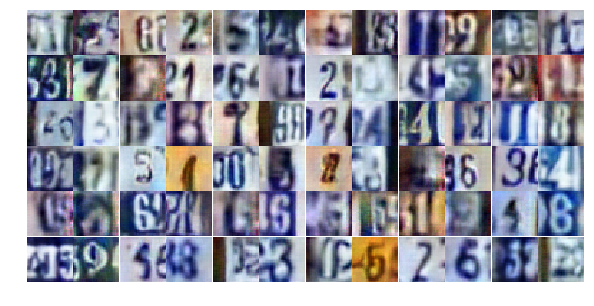

Epoch 23/25... Discriminator Loss: 0.8166... Generator Loss: 0.7564
Epoch 23/25... Discriminator Loss: 1.0958... Generator Loss: 0.5673
Epoch 23/25... Discriminator Loss: 0.9379... Generator Loss: 0.8847
Epoch 23/25... Discriminator Loss: 0.4557... Generator Loss: 1.5482
Epoch 23/25... Discriminator Loss: 1.3628... Generator Loss: 0.5277
Epoch 23/25... Discriminator Loss: 0.8312... Generator Loss: 0.8776
Epoch 23/25... Discriminator Loss: 1.0989... Generator Loss: 0.5664
Epoch 24/25... Discriminator Loss: 0.7243... Generator Loss: 0.9524
Epoch 24/25... Discriminator Loss: 1.8377... Generator Loss: 0.3202
Epoch 24/25... Discriminator Loss: 1.1197... Generator Loss: 0.7196


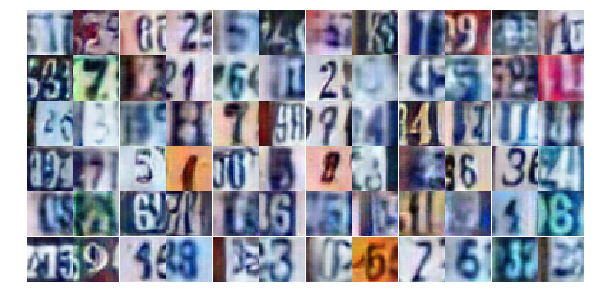

Epoch 24/25... Discriminator Loss: 0.7341... Generator Loss: 1.0156
Epoch 24/25... Discriminator Loss: 0.5558... Generator Loss: 1.6019
Epoch 24/25... Discriminator Loss: 0.4667... Generator Loss: 1.5532
Epoch 24/25... Discriminator Loss: 0.6857... Generator Loss: 1.5963
Epoch 24/25... Discriminator Loss: 0.7450... Generator Loss: 0.9096
Epoch 24/25... Discriminator Loss: 0.5088... Generator Loss: 1.4322
Epoch 24/25... Discriminator Loss: 0.7890... Generator Loss: 0.8835
Epoch 24/25... Discriminator Loss: 0.9464... Generator Loss: 0.7668
Epoch 24/25... Discriminator Loss: 0.4350... Generator Loss: 1.3927
Epoch 24/25... Discriminator Loss: 0.4380... Generator Loss: 1.8566


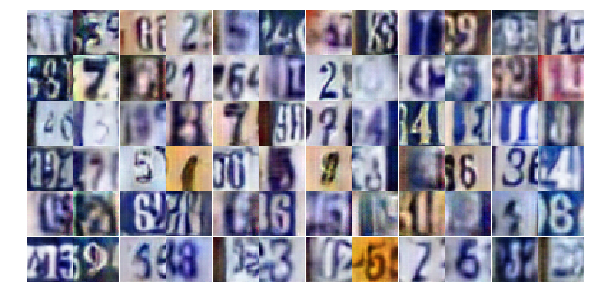

Epoch 24/25... Discriminator Loss: 2.1690... Generator Loss: 0.2561
Epoch 24/25... Discriminator Loss: 1.5565... Generator Loss: 0.3778
Epoch 24/25... Discriminator Loss: 0.8094... Generator Loss: 0.8664
Epoch 24/25... Discriminator Loss: 0.6611... Generator Loss: 1.0106
Epoch 24/25... Discriminator Loss: 0.3618... Generator Loss: 2.0271
Epoch 24/25... Discriminator Loss: 0.8481... Generator Loss: 0.8787
Epoch 24/25... Discriminator Loss: 0.4303... Generator Loss: 1.5356
Epoch 24/25... Discriminator Loss: 1.5076... Generator Loss: 0.3436
Epoch 24/25... Discriminator Loss: 0.7898... Generator Loss: 1.1477
Epoch 24/25... Discriminator Loss: 0.8083... Generator Loss: 0.8367


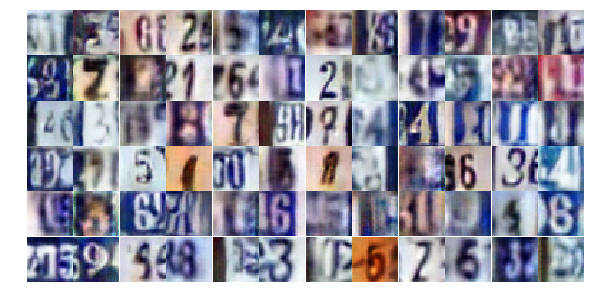

Epoch 24/25... Discriminator Loss: 1.0221... Generator Loss: 0.6413
Epoch 24/25... Discriminator Loss: 0.5781... Generator Loss: 1.2216
Epoch 24/25... Discriminator Loss: 0.3853... Generator Loss: 2.3038
Epoch 24/25... Discriminator Loss: 1.3429... Generator Loss: 0.4977
Epoch 24/25... Discriminator Loss: 0.4533... Generator Loss: 1.3379
Epoch 24/25... Discriminator Loss: 0.4346... Generator Loss: 1.7303
Epoch 24/25... Discriminator Loss: 0.4729... Generator Loss: 1.2942
Epoch 24/25... Discriminator Loss: 0.8316... Generator Loss: 0.8536
Epoch 24/25... Discriminator Loss: 0.7816... Generator Loss: 1.1920
Epoch 24/25... Discriminator Loss: 0.8022... Generator Loss: 0.8595


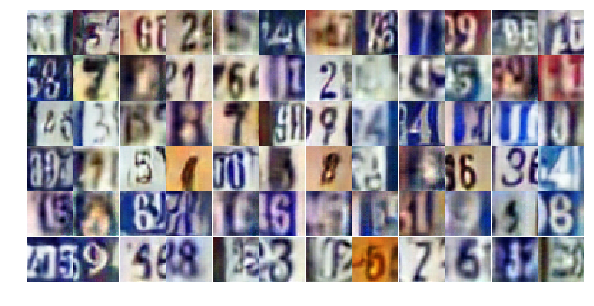

Epoch 24/25... Discriminator Loss: 0.8097... Generator Loss: 0.8216
Epoch 24/25... Discriminator Loss: 0.5171... Generator Loss: 1.1887
Epoch 24/25... Discriminator Loss: 1.0914... Generator Loss: 1.5426
Epoch 24/25... Discriminator Loss: 1.2515... Generator Loss: 0.4887
Epoch 24/25... Discriminator Loss: 0.8177... Generator Loss: 1.1689
Epoch 24/25... Discriminator Loss: 0.9725... Generator Loss: 0.6991
Epoch 24/25... Discriminator Loss: 1.2006... Generator Loss: 0.5029
Epoch 24/25... Discriminator Loss: 0.9494... Generator Loss: 0.7209
Epoch 24/25... Discriminator Loss: 0.5296... Generator Loss: 1.3651
Epoch 24/25... Discriminator Loss: 0.6415... Generator Loss: 1.1442


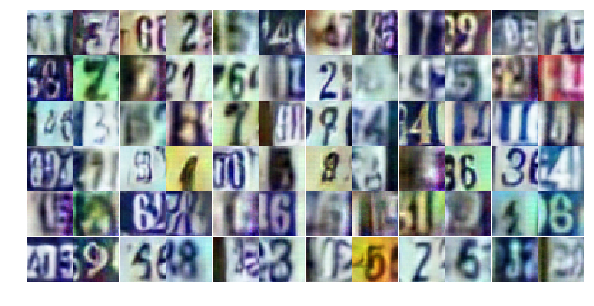

Epoch 24/25... Discriminator Loss: 0.9139... Generator Loss: 0.7575
Epoch 24/25... Discriminator Loss: 1.7596... Generator Loss: 0.3624
Epoch 24/25... Discriminator Loss: 1.0190... Generator Loss: 0.9812
Epoch 24/25... Discriminator Loss: 1.0240... Generator Loss: 1.3557
Epoch 24/25... Discriminator Loss: 0.9870... Generator Loss: 0.7139
Epoch 24/25... Discriminator Loss: 0.6359... Generator Loss: 1.4479
Epoch 24/25... Discriminator Loss: 1.9331... Generator Loss: 0.2449
Epoch 24/25... Discriminator Loss: 0.5643... Generator Loss: 1.1994
Epoch 24/25... Discriminator Loss: 0.9981... Generator Loss: 0.6679
Epoch 24/25... Discriminator Loss: 1.3184... Generator Loss: 0.5725


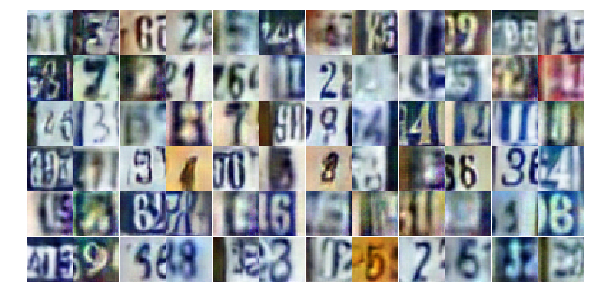

Epoch 24/25... Discriminator Loss: 1.1836... Generator Loss: 0.5691
Epoch 24/25... Discriminator Loss: 1.1519... Generator Loss: 0.5631
Epoch 24/25... Discriminator Loss: 0.7272... Generator Loss: 1.0167
Epoch 24/25... Discriminator Loss: 1.2254... Generator Loss: 0.5366
Epoch 24/25... Discriminator Loss: 1.1989... Generator Loss: 0.5448
Epoch 25/25... Discriminator Loss: 0.7896... Generator Loss: 1.0484
Epoch 25/25... Discriminator Loss: 0.4942... Generator Loss: 2.5349
Epoch 25/25... Discriminator Loss: 1.2467... Generator Loss: 0.5907
Epoch 25/25... Discriminator Loss: 0.8431... Generator Loss: 0.9625
Epoch 25/25... Discriminator Loss: 0.7932... Generator Loss: 0.9008


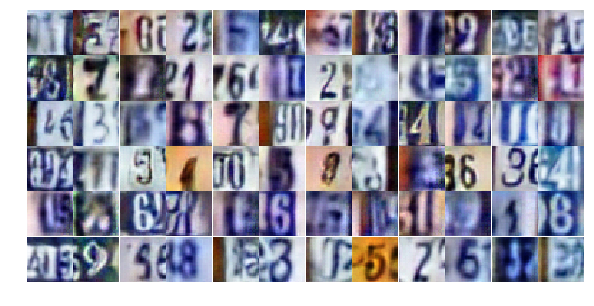

Epoch 25/25... Discriminator Loss: 1.0188... Generator Loss: 0.6767
Epoch 25/25... Discriminator Loss: 0.9498... Generator Loss: 0.7983
Epoch 25/25... Discriminator Loss: 0.6126... Generator Loss: 1.1733
Epoch 25/25... Discriminator Loss: 0.7167... Generator Loss: 1.0143
Epoch 25/25... Discriminator Loss: 0.8233... Generator Loss: 0.9797
Epoch 25/25... Discriminator Loss: 0.9279... Generator Loss: 0.7713
Epoch 25/25... Discriminator Loss: 0.6252... Generator Loss: 1.1373
Epoch 25/25... Discriminator Loss: 0.7231... Generator Loss: 1.0871
Epoch 25/25... Discriminator Loss: 0.5005... Generator Loss: 1.3559
Epoch 25/25... Discriminator Loss: 0.5112... Generator Loss: 1.3597


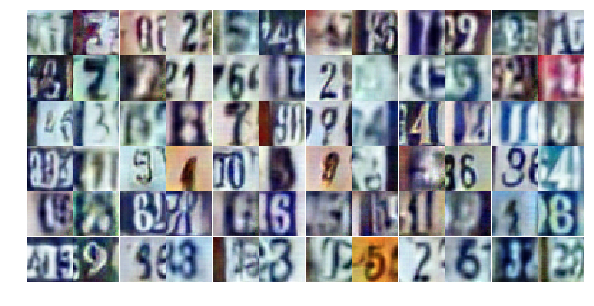

Epoch 25/25... Discriminator Loss: 1.0326... Generator Loss: 0.6070
Epoch 25/25... Discriminator Loss: 0.5572... Generator Loss: 3.2994
Epoch 25/25... Discriminator Loss: 1.3096... Generator Loss: 0.5197
Epoch 25/25... Discriminator Loss: 1.3502... Generator Loss: 0.5241
Epoch 25/25... Discriminator Loss: 0.7662... Generator Loss: 0.8867
Epoch 25/25... Discriminator Loss: 0.6470... Generator Loss: 1.2661
Epoch 25/25... Discriminator Loss: 0.8788... Generator Loss: 0.8158
Epoch 25/25... Discriminator Loss: 1.3229... Generator Loss: 0.4918
Epoch 25/25... Discriminator Loss: 0.7508... Generator Loss: 0.9815
Epoch 25/25... Discriminator Loss: 0.7386... Generator Loss: 1.0025


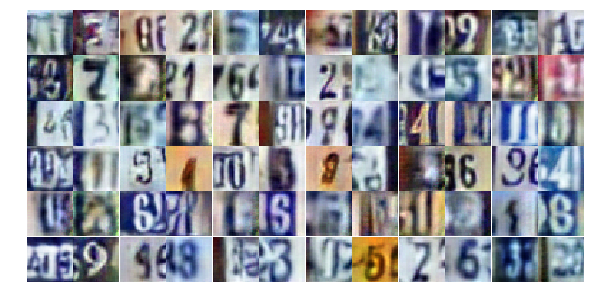

Epoch 25/25... Discriminator Loss: 0.5796... Generator Loss: 1.1252
Epoch 25/25... Discriminator Loss: 0.6803... Generator Loss: 0.9363
Epoch 25/25... Discriminator Loss: 1.0874... Generator Loss: 0.6808
Epoch 25/25... Discriminator Loss: 0.7139... Generator Loss: 0.9772
Epoch 25/25... Discriminator Loss: 0.8254... Generator Loss: 0.8254
Epoch 25/25... Discriminator Loss: 0.4262... Generator Loss: 1.4828
Epoch 25/25... Discriminator Loss: 0.8527... Generator Loss: 0.8738
Epoch 25/25... Discriminator Loss: 0.7834... Generator Loss: 0.8206
Epoch 25/25... Discriminator Loss: 0.8342... Generator Loss: 2.5449
Epoch 25/25... Discriminator Loss: 0.4344... Generator Loss: 1.5916


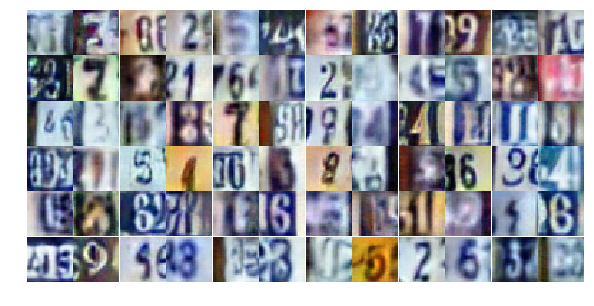

Epoch 25/25... Discriminator Loss: 0.6141... Generator Loss: 1.2266
Epoch 25/25... Discriminator Loss: 0.4273... Generator Loss: 1.4638
Epoch 25/25... Discriminator Loss: 0.7774... Generator Loss: 1.0722
Epoch 25/25... Discriminator Loss: 0.5852... Generator Loss: 1.2223
Epoch 25/25... Discriminator Loss: 0.8825... Generator Loss: 0.7614
Epoch 25/25... Discriminator Loss: 1.0745... Generator Loss: 0.5967
Epoch 25/25... Discriminator Loss: 0.3889... Generator Loss: 1.5373
Epoch 25/25... Discriminator Loss: 2.1658... Generator Loss: 0.1999
Epoch 25/25... Discriminator Loss: 2.2141... Generator Loss: 0.2226
Epoch 25/25... Discriminator Loss: 0.9856... Generator Loss: 0.7483


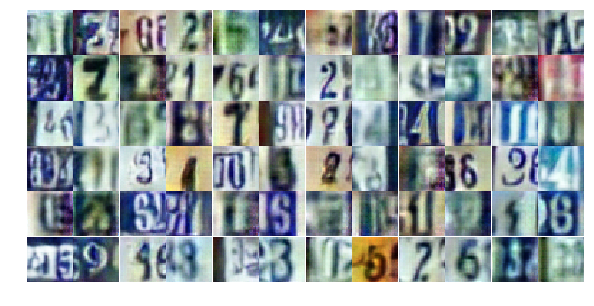

Epoch 25/25... Discriminator Loss: 0.8756... Generator Loss: 2.5189
Epoch 25/25... Discriminator Loss: 0.6712... Generator Loss: 2.3126
Epoch 25/25... Discriminator Loss: 0.9156... Generator Loss: 0.7610
Epoch 25/25... Discriminator Loss: 0.9549... Generator Loss: 0.6695
Epoch 25/25... Discriminator Loss: 1.0526... Generator Loss: 0.6459
Epoch 25/25... Discriminator Loss: 0.5461... Generator Loss: 1.2632
Epoch 25/25... Discriminator Loss: 0.9892... Generator Loss: 0.7456
Epoch 25/25... Discriminator Loss: 0.9094... Generator Loss: 0.8086
Epoch 25/25... Discriminator Loss: 1.7384... Generator Loss: 0.3443
Epoch 25/25... Discriminator Loss: 1.1457... Generator Loss: 0.6347


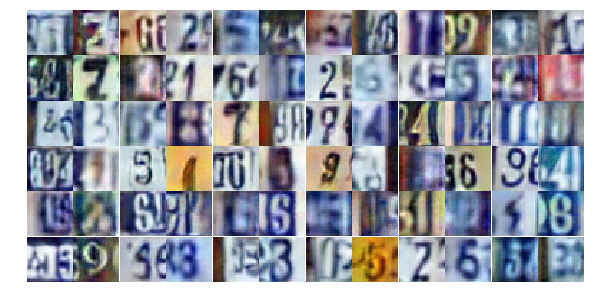

Epoch 25/25... Discriminator Loss: 0.3698... Generator Loss: 2.1882
Epoch 25/25... Discriminator Loss: 1.5248... Generator Loss: 0.4180


In [22]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

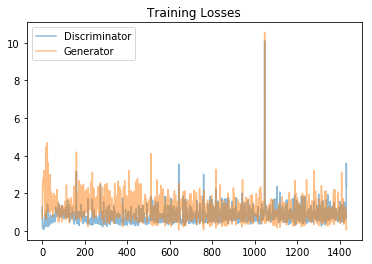

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

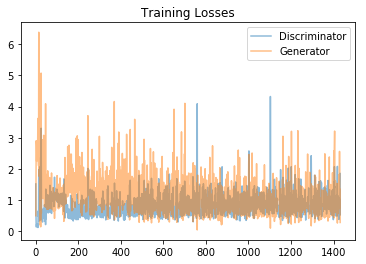

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

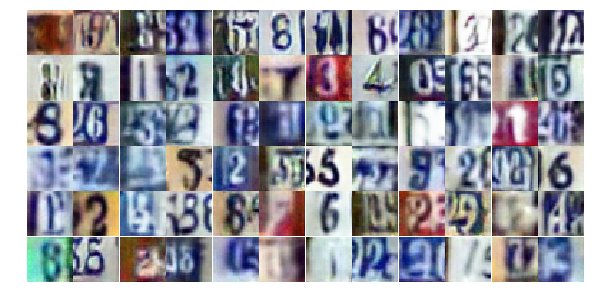

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

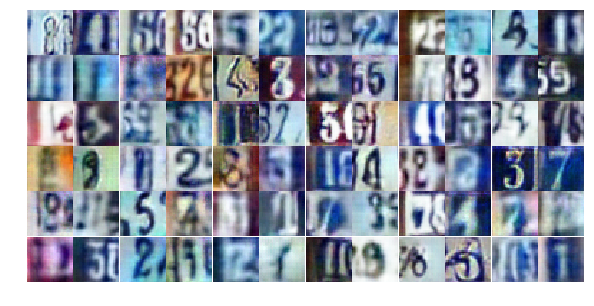

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))